<a href="https://colab.research.google.com/github/sina973/Autoencoder-with-GAN/blob/main/Cifar10_Autoencoder_with_GAN_Recurrent.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import matplotlib.pyplot as plt # plotting library
import numpy as np # this module is useful to work with numerical arrays
import pandas as pd
import random
import torch
import torchvision
from torchvision import transforms
from torch.utils.data import DataLoader,random_split
from torch import nn
import torch.nn.functional as F
import torch.optim as optim


# convert data to torch.FloatTensor
transform = transforms.ToTensor()

# load the training and test datasets
train_data = torchvision.datasets.CIFAR10(root='data', train=True, download=True, transform=transform)
test_data = torchvision.datasets.CIFAR10(root='data', train=False, download=True, transform=transform)


# Create training and test dataloaders
num_workers = 0
# how many samples per batch to load
batch_size = 7000
batch_size_test = 2000
# prepare data loaders
train_loader = torch.utils.data.DataLoader(train_data, batch_size=batch_size, num_workers=num_workers, shuffle=True)
test_loader = torch.utils.data.DataLoader(test_data, batch_size=batch_size_test, num_workers=num_workers, shuffle=True)

Files already downloaded and verified
Files already downloaded and verified


In [ ]:
class AutoEncoder(nn.Module):

    def __init__(self, encoded_space_dim, recursive_steps):
        super().__init__()
        self.recursive_steps = recursive_steps
        ########################### ENCODER ############################################
        ### Convolutional section
        self.encoder_cnn = nn.Sequential(                       ## Input dimension is 3 * 32 * 32
            nn.Conv2d(3, 8, 5, stride=1, padding=2),
            nn.ReLU(True),                                      ## The output dimension of this layer will be 8 * 32 * 32
            nn.Conv2d(8, 16, 5, stride=1, padding=2),
            nn.ReLU(True),                                      ## The output dimension of this layer will be 16 * 32 * 32
            nn.MaxPool2d(2, stride=2),
            nn.BatchNorm2d(16),                                 ## The output dimension of this layer will be 16 * 16 * 16
            # nn.ReLU(True),
            nn.Conv2d(16, 32, 6, stride=2, padding=2),          ## The output dimension of this layer will be 32 * 8 * 8
            nn.ReLU(True),
            # nn.MaxPool2d(2, stride=2),                          ## The output dimension of this layer will be 32 * 8 * 8 -----> Temporary inactive
            nn.Conv2d(32, 64, 5, stride=1, padding=2),
            nn.ReLU(True),                                      ## The output dimension of this layer will be 64 * 8 * 8
            # nn.MaxPool2d(2, stride=2)
        )

        ########################### DECODER ############################################

        self.decoder_conv = nn.Sequential(
            nn.ConvTranspose2d(64, 32, 3,
            stride=2, padding = 1, output_padding=1),
            nn.BatchNorm2d(32),                                 ## The output dimension of this layer will be 32 * 16 * 16
            nn.ReLU(True),
            nn.ConvTranspose2d(32, 16, 3, stride=2,
            padding=1, output_padding=1),
            nn.BatchNorm2d(16),                                 ## The output dimension of this layer will be 16 * 32 * 32
            nn.ReLU(True),
            nn.ConvTranspose2d(16, 8, 3, stride=1,
            padding=1, output_padding=0),                       ## The output dimension of this layer will be 8 * 32 * 32
            nn.BatchNorm2d(8),
            nn.ReLU(True),
            nn.ConvTranspose2d(8, 3, 3, stride=1,
            padding=1, output_padding=0)                        ## The output dimension of this layer will be 3 * 32 * 32
            # nn.MaxPool2d(2, stride=2)
        )

    def forward(self, x, recursive_steps):
        for i in range(recursive_steps):
            x = self.encoder_cnn(x)
            x = self.decoder_conv(x)
            x = torch.sigmoid(x)
        return x

In [ ]:
class AutoEncoder(nn.Module):

    def __init__(self, encoded_space_dim, recursive_steps):
        super().__init__()
        self.recursive_steps = recursive_steps
        ########################### ENCODER ############################################
        ### Convolutional section
        self.encoder_cnn = nn.Sequential(                       ## Input dimension is 3 * 32 * 32
            nn.Conv2d(3, 8, 5, stride=1, padding=2),
            nn.ReLU(True),                                      ## The output dimension of this layer will be 8 * 32 * 32
            nn.Conv2d(8, 8, 3, stride=1, padding=1),
            nn.ReLU(True),                                      ## The output dimension of this layer will be 8 * 32 * 32
            nn.Conv2d(8, 16, 4, stride=2, padding=1),
            nn.ReLU(True),                                      ## The output dimension of this layer will be 16 * 16 * 16
            nn.BatchNorm2d(16),
            # nn.ReLU(True),
            nn.Conv2d(16, 16, 3, stride=1, padding=1),           ## The output dimension of this layer will be 16 * 16 * 16
            nn.ReLU(True),
            nn.Conv2d(16, 32, 4, stride=2, padding=1),           ## The output dimension of this layer will be 32 * 8 * 8
            nn.ReLU(True),
            nn.Conv2d(32, 32, 3, stride=1, padding=1),          ## The output dimension of this layer will be 32 * 8 * 8
            nn.ReLU(True),
            # nn.Conv2d(32, 32, 3, stride=1, padding=1),           ## The output dimension of this layer will be 32 * 8 * 8
            # nn.ReLU(True),
            # nn.Conv2d(32, 32, 3, stride=1, padding=1),           ## The output dimension of this layer will be 32 * 8 * 8
            # nn.ReLU(True),
            nn.Conv2d(32, 32, 3, stride=1, padding=1),           ## The output dimension of this layer will be 32 * 8 * 8
            nn.ReLU(True)
            # nn.Conv2d(64, 64, 5, stride=1, padding=2),          ## The output dimension of this layer will be 64 * 4 * 4
            # nn.ReLU(True),
            # # nn.MaxPool2d(2, stride=2),                          ## The output dimension of this layer will be 32 * 8 * 8 -----> Temporary inactive
            # nn.Conv2d(64, 64, 5, stride=1, padding=2),
            # nn.ReLU(True),                                      ## The output dimension of this layer will be 64 * 4 * 4
            # nn.MaxPool2d(2, stride=2)
        )

        ########################### DECODER ############################################

        self.decoder_conv = nn.Sequential(
            # nn.ConvTranspose2d(64, 32, 3,
            # stride=2, padding = 1, output_padding=1),
            # nn.BatchNorm2d(32),                                 ## The output dimension of this layer will be 32 * 8 * 8
            # nn.ReLU(True),
            nn.ConvTranspose2d(32, 32, 3, stride=1,
            padding=1, output_padding=0),
            nn.BatchNorm2d(32),                                 ## The output dimension of this layer will be 32 * 8 * 8
            nn.ReLU(True),
            nn.ConvTranspose2d(32, 16, 3, stride=2,
            padding=1, output_padding=1),                       ## The output dimension of this layer will be 16 * 16 * 16
            # nn.BatchNorm2d(16),
            nn.ReLU(True),
            nn.ConvTranspose2d(16, 16, 3, stride=1,
            padding=1, output_padding=0),
            # nn.ReLU(True),                     ## The output dimension of this layer will be 16 * 16 * 16
            # nn.ConvTranspose2d(16, 16, 3, stride=1,
            # padding=1, output_padding=0),
            nn.ReLU(True),                     ## The output dimension of this layer will be 16 * 16 * 16
            nn.ConvTranspose2d(16, 8, 3,
            stride=2, padding = 1, output_padding=1),
            # nn.BatchNorm2d(8),                                 ## The output dimension of this layer will be 8 * 32 * 32
            nn.ReLU(True),
            nn.ConvTranspose2d(8, 8, 3, stride=1,
            padding=1, output_padding=0),
            # nn.BatchNorm2d(16),
            # nn.ReLU(True),                              ## The output dimension of this layer will be 8 * 32 * 32
            # nn.ConvTranspose2d(8, 8, 3, stride=1,
            # padding=1, output_padding=0),
            # nn.BatchNorm2d(16),                                 ## The output dimension of this layer will be 8 * 32 * 32
            nn.ReLU(True),
            nn.ConvTranspose2d(8, 3, 3, stride=1,
            padding=1, output_padding=0),                       ## The output dimension of this layer will be 3 * 32 * 32
            nn.BatchNorm2d(3),
            nn.ReLU(True),
            nn.ConvTranspose2d(3, 3, 3, stride=1,               ## The output dimension of this layer will be 3 * 32 * 32
            padding=1, output_padding=0)
            # nn.MaxPool2d(2, stride=2)
        )

    def forward(self, x, recursive_steps):
        for i in range(recursive_steps):
            x = self.encoder_cnn(x)
            x = self.decoder_conv(x)
            x = torch.sigmoid(x)
        return x

NameError: ignored

In [ ]:
class DiscriminatorNet(torch.nn.Module):
    """
    A three hidden-layer discriminative neural network
    """
    def __init__(self):
        super().__init__()

        self.encoder_cnn = nn.Sequential(                       ## Input dimension is 3 * 32 * 32
        nn.Conv2d(3, 8, 5, stride=1, padding=2),
        nn.ReLU(True),                                      ## The output dimension of this layer will be 8 * 32 * 32
        nn.Conv2d(8, 16, 5, stride=1, padding=2),
        nn.ReLU(True),                                      ## The output dimension of this layer will be 16 * 32 * 32
        nn.MaxPool2d(2, stride=2),
        nn.BatchNorm2d(16),                                 ## The output dimension of this layer will be 16 * 16 * 16
        # nn.ReLU(True),
        nn.Conv2d(16, 32, 6, stride=2, padding=2),          ## The output dimension of this layer will be 32 * 8 * 8
        nn.ReLU(True))


        n_features = 32 * 8 * 8
        n_out = 1

        ### Flatten layer
        self.flatten = nn.Flatten(start_dim=1)

        self.hidden0 = nn.Sequential(
            nn.Linear(n_features, 1024),
            nn.LeakyReLU(0.2),
            nn.Dropout(0.3)
        )
        self.hidden1 = nn.Sequential(
            nn.Linear(1024, 256),
            nn.LeakyReLU(0.2),
            nn.Dropout(0.3)
        )
        self.hidden2 = nn.Sequential(
            nn.Linear(256, 64),
            nn.LeakyReLU(0.2),
            nn.Dropout(0.3)
        )
        self.out = nn.Sequential(
            torch.nn.Linear(64, n_out),
            torch.nn.Sigmoid()
        )

    def forward(self, x):
        x = self.encoder_cnn(x)
        x = self.flatten(x)
        x = self.hidden0(x)
        x = self.hidden1(x)
        x = self.hidden2(x)
        x = self.out(x)
        return x

In [ ]:
### Define the loss function
# loss_fn = torch.nn.MSELoss()
loss_fn = torch.nn.BCELoss()

# Discriminator Loss => BCELoss
def d_loss_function(inputs, targets):
    return nn.BCELoss()(inputs, targets)

def g_loss_function(inputs):
    targets = torch.ones(inputs.shape[0], 1).to(device)
    targets = targets.to(device)
    return nn.BCELoss()(inputs, targets)

### Define an optimizer (both for the encoder and the decoder!)
lr= 0.005

### Set the random seed for reproducible results
torch.manual_seed(0)

### Initialize the two networks
d = 16

#model = Autoencoder(encoded_space_dim=encoded_space_dim)
autoencoder_1 = AutoEncoder(encoded_space_dim=d, recursive_steps=2)
params_to_optimize_1 = [{'params': autoencoder_1.parameters()}]
optimizer_1 = torch.optim.Adam(params_to_optimize_1, lr=lr, weight_decay=1e-05)
optimizer_2 = torch.optim.Adam(params_to_optimize_1, lr=lr, weight_decay=1e-05)


discriminator = DiscriminatorNet()
d_params_to_optimize = [{'params': discriminator.parameters()}]
d_optimizer = optim.Adam(d_params_to_optimize, lr=lr, weight_decay=1e-05)


# Check if the GPU is available
device = torch.device("cuda") if torch.cuda.is_available() else torch.device("cpu")
print(f'Selected device: {device}')

# Move both the encoder and the decoder to the selected device
autoencoder_1.to(device)
discriminator.to(device)

Selected device: cuda


DiscriminatorNet(
  (encoder_cnn): Sequential(
    (0): Conv2d(3, 8, kernel_size=(5, 5), stride=(1, 1), padding=(2, 2))
    (1): ReLU(inplace=True)
    (2): Conv2d(8, 16, kernel_size=(5, 5), stride=(1, 1), padding=(2, 2))
    (3): ReLU(inplace=True)
    (4): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (5): BatchNorm2d(16, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (6): Conv2d(16, 32, kernel_size=(6, 6), stride=(2, 2), padding=(2, 2))
    (7): ReLU(inplace=True)
  )
  (flatten): Flatten(start_dim=1, end_dim=-1)
  (hidden0): Sequential(
    (0): Linear(in_features=2048, out_features=1024, bias=True)
    (1): LeakyReLU(negative_slope=0.2)
    (2): Dropout(p=0.3, inplace=False)
  )
  (hidden1): Sequential(
    (0): Linear(in_features=1024, out_features=256, bias=True)
    (1): LeakyReLU(negative_slope=0.2)
    (2): Dropout(p=0.3, inplace=False)
  )
  (hidden2): Sequential(
    (0): Linear(in_features=256, out_features=64, bias=Tru

In [ ]:
for image_batch, label in train_loader:
    print(image_batch.shape)
    print(image_batch.shape[0])

torch.Size([7000, 3, 32, 32])
7000
torch.Size([7000, 3, 32, 32])
7000
torch.Size([7000, 3, 32, 32])
7000
torch.Size([7000, 3, 32, 32])
7000
torch.Size([7000, 3, 32, 32])
7000
torch.Size([7000, 3, 32, 32])
7000
torch.Size([7000, 3, 32, 32])
7000
torch.Size([1000, 3, 32, 32])
1000


In [ ]:
import random

### Training function
def train_epoch(autoencoder_1, discriminator, device, dataloader, loss_fn, optimizer, optimizer_2, d_optimizer, noise_factor=0.3):
    # Set train mode for both the encoder and the decoder
    autoencoder_1.train()
    discriminator.train()
    train_loss = []
    # autoEncoders[i].load_state_dict(autoEncoders[0].state_dict()
    # Iterate the dataloader (we do not need the label values, this is unsupervised learning)
    count = int(((random.random()*30) // 10) + 1)
    loss = 0
    times = 0
    discriminator_loss = []
    autoencoder_loss = []

    for image_batch, _ in dataloader: # with "_" we just ignore the labels (the second element of the dataloader tuple)
        # Move tensor to the proper device
        # print(image_batch.shape)
        image_batch = image_batch.to(device)
        # Encode data
        decoded_data = autoencoder_1(image_batch, 1)
        # print(decoded_data.shape)
        # Evaluate loss
        loss = loss_fn(decoded_data, image_batch)
        # Backward pass
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()
        # Print batch loss
        # print('\t partial train loss (single batch): %f' % (loss.data))
        train_loss.append(loss.detach().cpu().numpy())

    print('Autoencoder: G_loss: {:.5f}'.format(np.mean(train_loss)))

    for image_batch, _ in dataloader: # with "_" we just ignore the labels (the second element of the dataloader tuple)
        times += 1
        real_inputs = image_batch.to(device)
        real_label = (torch.ones(real_inputs.shape[0], 1)*1).to(device)

        fake_inputs = autoencoder_1(real_inputs, 1)
        fake_label = (torch.zeros(fake_inputs.shape[0], 1)).to(device)
        # print(fake_inputs.shape)
        # print(fake_label.shape)

        # real_inputs = torch.cat((real_inputs, real_label),0)
        # fake_inputs = torch.cat((fake_inputs, fake_label),0)
        # print(fake_inputs.shape)

        inputs = torch.cat((real_inputs, fake_inputs), 0)
        labels = torch.cat((real_label, fake_label), 0)
        # print(inputs.shape)

        # inputs=inputs[torch.randperm(inputs.shape[0])]
        # print(inputs.shape)

        # targets = inputs[:,inputs.shape[1]-1].view(-1,1)
        # inputs = inputs[:,:inputs.shape[1]-1]
        # print(targets.shape)
        # print(inputs.shape)

        outputs = discriminator(inputs)


        # Zero the parameter gradients
        d_optimizer.zero_grad()

        # Backward propagation
        d_loss = d_loss_function(outputs, labels)
        discriminator_loss.append(d_loss.detach().cpu().numpy())
        print(d_loss)
        if d_loss > 0.03:
          d_loss.backward()
          d_optimizer.step()
          print("D loss is increasing")

        if times % 100 == 0 or times == len(train_loader):
            print('[{}/{}] D_loss: {:.5f} G_loss: {:.5f}'.format(times, len(train_loader), d_loss.item(), np.mean(discriminator_loss)))

    times = 0
    for image_batch, _ in dataloader: # with "_" we just ignore the labels (the second element of the dataloader tuple)
        # Move tensor to the proper device
        real_inputs = image_batch.to(device)
        count += 1
        times += 1
        temp_rec_step = 1
        # if (count % 3) == 0:
        #    temp_rec_step = 3
        # else:
        #   temp_rec_step = (count % 3)

        reconstructed_data = autoencoder_1(real_inputs, temp_rec_step)
        # temp_img = reconstructed_data

        # Generator

        fake_outputs = discriminator(reconstructed_data)
        # print(fake_outputs[0])

        g_loss = g_loss_function(fake_outputs)
        autoencoder_loss.append(g_loss.detach().cpu().numpy())

        optimizer_2.zero_grad()
        g_loss.backward()
        optimizer_2.step()

        if times % 100 == 0 or times == len(train_loader):
            print('[{}/{}] G_loss: {:.5f}'.format(times, len(train_loader),  np.mean(autoencoder_loss)))

    return np.mean(train_loss)

In [ ]:
### Testing function
import numpy as np
test_array = np.zeros((256,3,32,32))
test_reconstructed_array = np.zeros((256,3,32,32))

def test_epoch(autoencoder_1, device, dataloader, loss_fn):
    # Set evaluation mode for encoder and decoder
    autoencoder_1.eval()
    with torch.no_grad(): # No need to track the gradients
        # Define the lists to store the outputs for each batch
        conc_out = []
        conc_label = []
        for image_batch, _ in dataloader:
            # Move tensor to the proper device
            image_batch = image_batch.to(device)
            # Encode data
            decoded_data = autoencoder_1(image_batch,1)
            conc_out.append(decoded_data.cpu())
            conc_label.append(image_batch.cpu())
            # print(image_batch.detach().cpu().numpy())
            # print(image_batch.detach().cpu().numpy().shape)
            np.append(test_array, image_batch.detach().cpu().numpy(), axis=0)
            np.append(test_reconstructed_array, decoded_data.detach().cpu().numpy(), axis=0)
        # Create a single tensor with all the values in the lists
        conc_out = torch.cat(conc_out)
        conc_label = torch.cat(conc_label)
        # Evaluate global loss
        val_loss = loss_fn(conc_out, conc_label)
    return val_loss.data

In [ ]:
def plot_ae_outputs(autoencoder_1,n=20):
    img = []
    rec_img = []
    autoencoder_1.eval()
    for i in range(n):
      img.append(test_data[i][0].unsqueeze(0).to(device))
      with torch.no_grad():
         rec_img.append(autoencoder_1(img[i],1))
      img[i] = img[i].cpu().squeeze().numpy()
      rec_img[i] = rec_img[i].cpu().squeeze().numpy()
    # plot the first ten input images and then reconstructed images
    fig, axes = plt.subplots(nrows=2, ncols=10, sharex=True, sharey=True, figsize=(24,4))
    for idx in np.arange(20):
          ax = fig.add_subplot(2, 20/2, idx+1, xticks=[], yticks=[])
          plt.imshow(np.transpose(img[idx], (1, 2, 0)))
          ax.set_title("Original")

    # plot the first ten input images and then reconstructed images
    fig, axes = plt.subplots(nrows=2, ncols=10, sharex=True, sharey=True, figsize=(24,4))
    for idx in np.arange(20):
          ax = fig.add_subplot(2, 20/2, idx+1, xticks=[], yticks=[])
          plt.imshow(np.transpose(rec_img[idx], (1, 2, 0)))
          ax.set_title("Recunstructed")
    plt.show()

In [ ]:
def plot_ae_outputs2(encoder,decoder,n=5):
    plt.figure(figsize=(10,4.5))
    for i in range(n):
      ax = plt.subplot(2,n,i+1)
      img = test_dataset[i][0].unsqueeze(0).to(device)
      encoder.eval()
      decoder.eval()
      with torch.no_grad():
         rec_img  = decoder(encoder(img))
      plt.imshow(img.cpu().squeeze().numpy(), cmap='gist_gray')
      ax.get_xaxis().set_visible(False)
      ax.get_yaxis().set_visible(False)
      if i == n//2:
        ax.set_title('Original images')
      ax = plt.subplot(2, n, i + 1 + n)
      plt.imshow(rec_img.cpu().squeeze().numpy(), cmap='gist_gray')
      ax.get_xaxis().set_visible(False)
      ax.get_yaxis().set_visible(False)
      if i == n//2:
         ax.set_title('Reconstructed images')
    plt.show()

Autoencoder: G_loss: 0.60988
tensor(0.0252, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0254, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0256, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0250, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0261, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0250, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0262, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0290, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
[8/8] D_loss: 0.02901 G_loss: 0.02595
[8/8] G_loss: 0.06661

 EPOCH 1/200 	 train loss 0.6098843812942505 	 val loss 0.6127839684486389


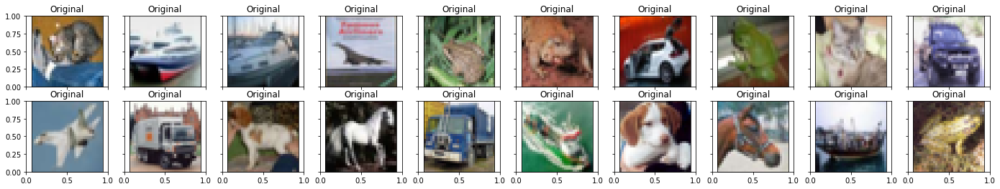

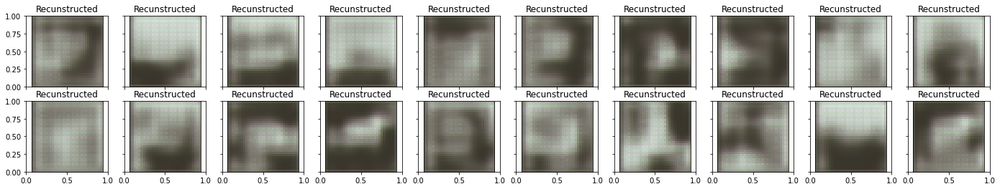

Autoencoder: G_loss: 0.60744
tensor(0.0377, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
D loss is increasing
tensor(0.0424, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
D loss is increasing
tensor(0.0395, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
D loss is increasing
tensor(0.0303, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
D loss is increasing
tensor(0.0247, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0245, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0227, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0224, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
[8/8] D_loss: 0.02239 G_loss: 0.03052
[8/8] G_loss: 0.00463

 EPOCH 2/200 	 train loss 0.6074440479278564 	 val loss 0.6085587739944458


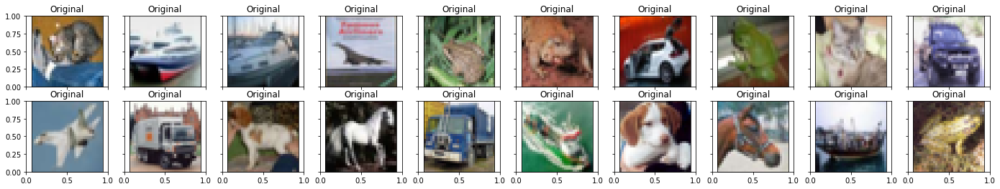

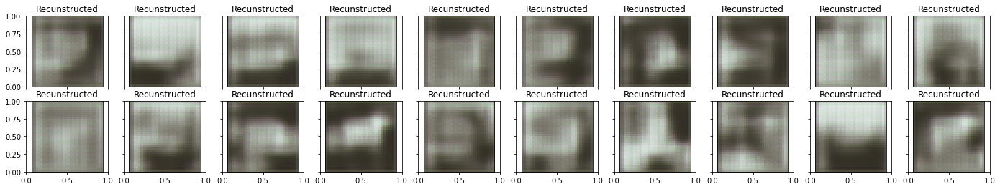

Autoencoder: G_loss: 0.60318
tensor(0.0317, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
D loss is increasing
tensor(0.0279, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0267, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0246, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0278, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0233, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0319, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
D loss is increasing
tensor(0.0214, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
[8/8] D_loss: 0.02135 G_loss: 0.02691
[8/8] G_loss: 0.01909

 EPOCH 3/200 	 train loss 0.6031782627105713 	 val loss 0.6072725057601929


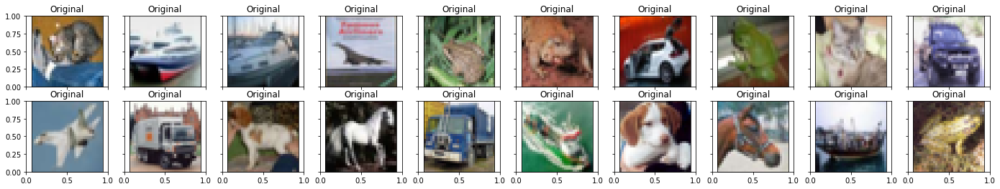

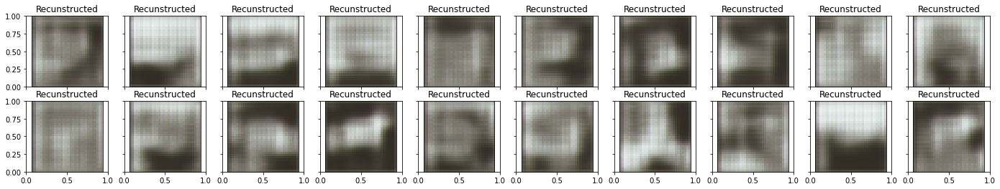

Autoencoder: G_loss: 0.60126
tensor(0.0297, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0266, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0259, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0293, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0256, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0299, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0250, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0324, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
D loss is increasing
[8/8] D_loss: 0.03235 G_loss: 0.02804
[8/8] G_loss: 0.01095

 EPOCH 4/200 	 train loss 0.6012635231018066 	 val loss 0.6053121089935303


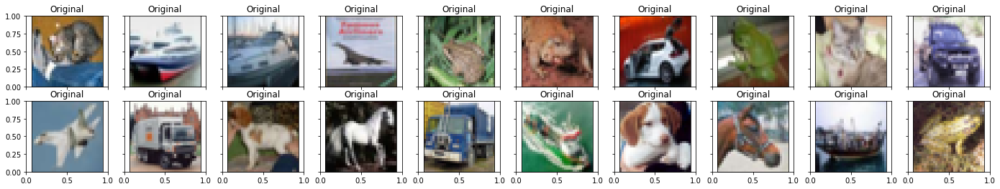

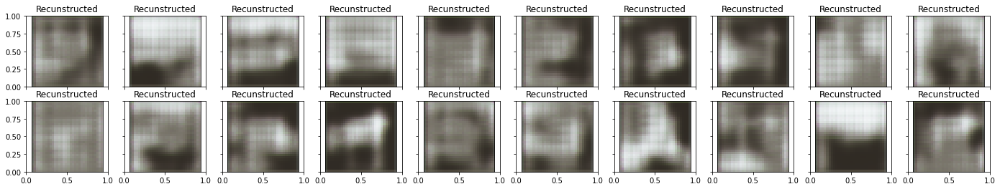

Autoencoder: G_loss: 0.59958
tensor(0.0427, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
D loss is increasing
tensor(0.0333, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
D loss is increasing
tensor(0.0286, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0237, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0224, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0315, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
D loss is increasing
tensor(0.0176, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0240, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
[8/8] D_loss: 0.02405 G_loss: 0.02797
[8/8] G_loss: 0.00525

 EPOCH 5/200 	 train loss 0.5995762944221497 	 val loss 0.6054400205612183


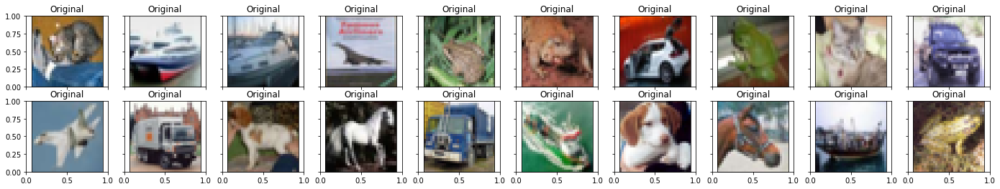

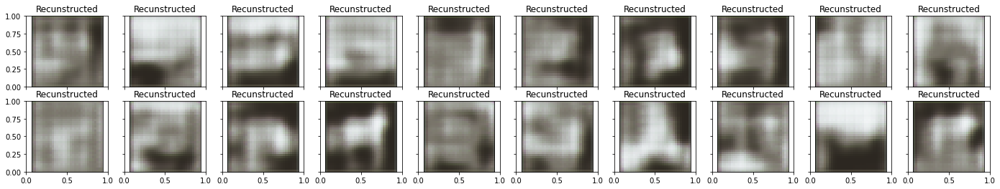

Autoencoder: G_loss: 0.59769
tensor(0.0204, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0200, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0210, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0231, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0174, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0232, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0216, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0221, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
[8/8] D_loss: 0.02211 G_loss: 0.02110
[8/8] G_loss: 0.00445

 EPOCH 6/200 	 train loss 0.5976899862289429 	 val loss 0.6141839623451233


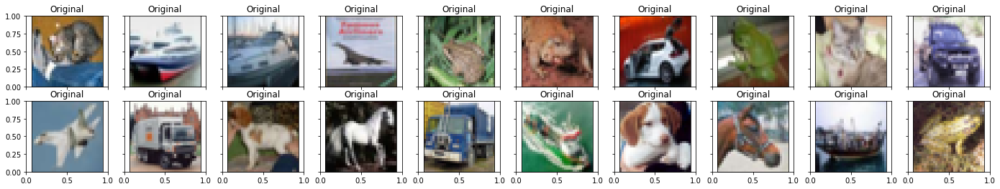

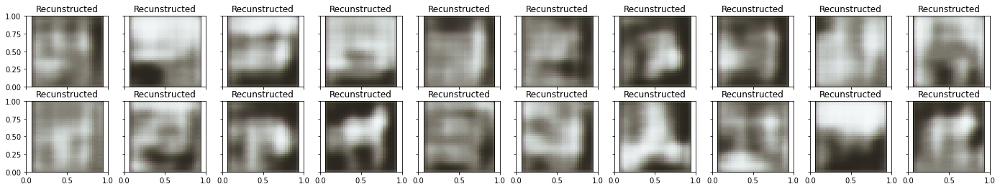

Autoencoder: G_loss: 0.59555
tensor(0.0373, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
D loss is increasing
tensor(0.0282, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0304, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
D loss is increasing
tensor(0.0267, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0259, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0257, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0210, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0339, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
D loss is increasing
[8/8] D_loss: 0.03386 G_loss: 0.02863
[8/8] G_loss: 0.00278

 EPOCH 7/200 	 train loss 0.5955457091331482 	 val loss 0.6220839619636536


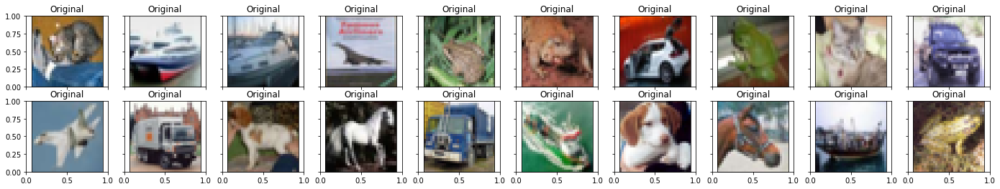

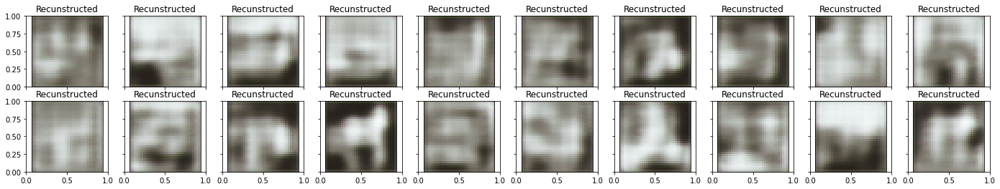

Autoencoder: G_loss: 0.59407
tensor(0.0306, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
D loss is increasing
tensor(0.0213, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0210, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0286, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0249, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0205, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0237, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0252, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
[8/8] D_loss: 0.02524 G_loss: 0.02447
[8/8] G_loss: 0.00282

 EPOCH 8/200 	 train loss 0.5940679311752319 	 val loss 0.6196602582931519


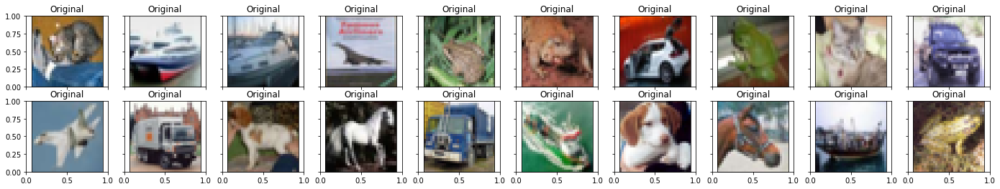

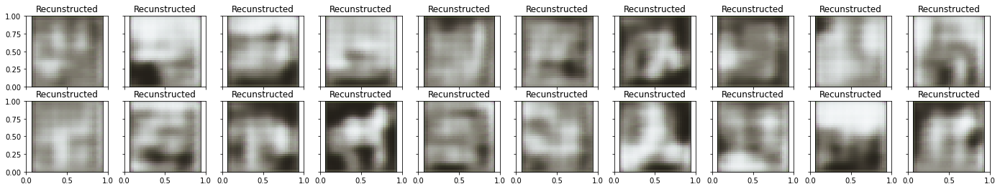

Autoencoder: G_loss: 0.59273
tensor(0.0326, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
D loss is increasing
tensor(0.0340, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
D loss is increasing
tensor(0.0350, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
D loss is increasing
tensor(0.0285, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0335, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
D loss is increasing
tensor(0.0209, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0240, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0254, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
[8/8] D_loss: 0.02540 G_loss: 0.02922
[8/8] G_loss: 0.00658

 EPOCH 9/200 	 train loss 0.5927290916442871 	 val loss 0.6599941253662109


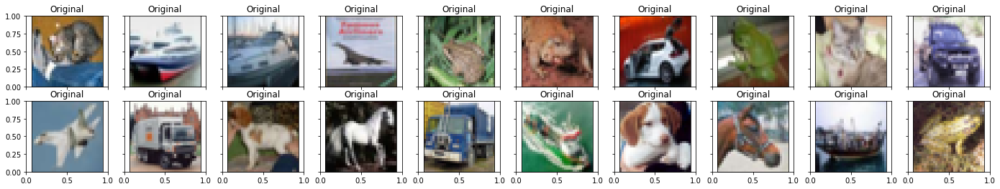

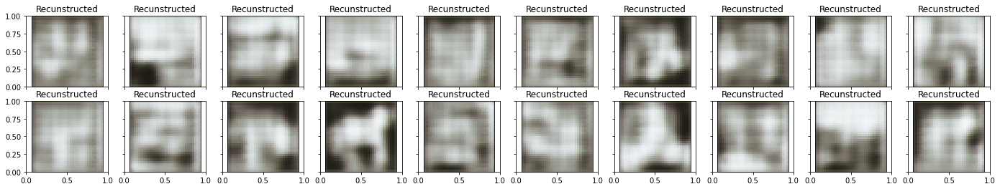

Autoencoder: G_loss: 0.59619
tensor(0.0242, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0201, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0208, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0262, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0241, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0215, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0176, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0248, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
[8/8] D_loss: 0.02477 G_loss: 0.02243
[8/8] G_loss: 0.01370

 EPOCH 10/200 	 train loss 0.5961916446685791 	 val loss 0.6376746296882629


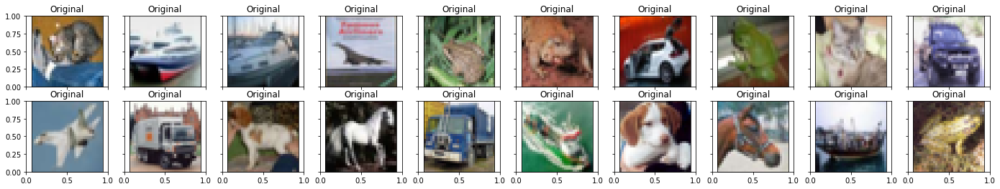

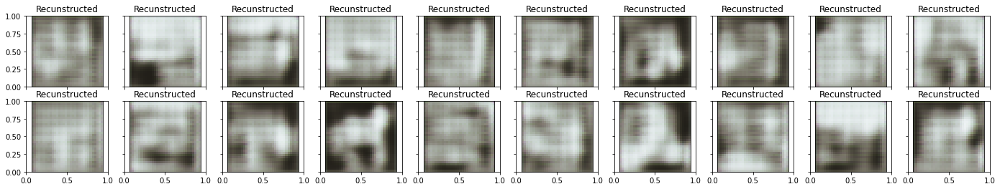

Autoencoder: G_loss: 0.59487
tensor(0.0251, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0268, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0214, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0194, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0210, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0201, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0192, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0155, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
[8/8] D_loss: 0.01552 G_loss: 0.02108
[8/8] G_loss: 0.00733

 EPOCH 11/200 	 train loss 0.5948711633682251 	 val loss 0.6193948984146118


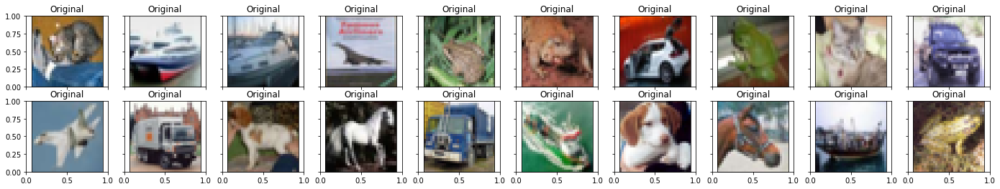

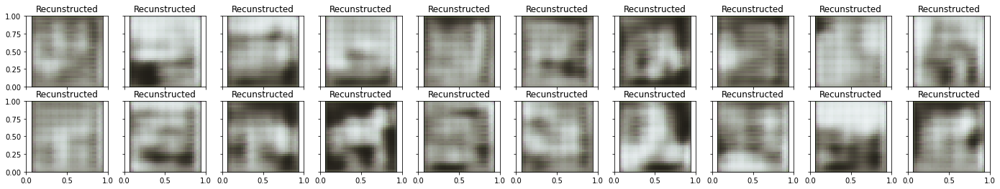

Autoencoder: G_loss: 0.59243
tensor(0.0250, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0224, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0205, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0251, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0234, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0223, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0229, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0304, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
D loss is increasing
[8/8] D_loss: 0.03039 G_loss: 0.02399
[8/8] G_loss: 0.00359

 EPOCH 12/200 	 train loss 0.5924270153045654 	 val loss 0.6377475261688232


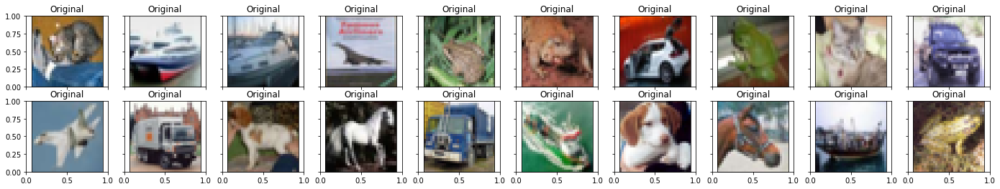

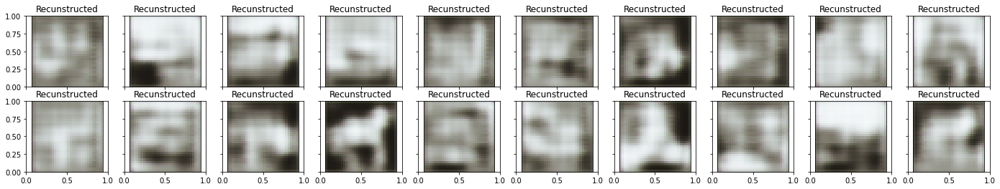

Autoencoder: G_loss: 0.59084
tensor(0.0955, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
D loss is increasing
tensor(0.0480, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
D loss is increasing
tensor(0.0339, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
D loss is increasing
tensor(0.0416, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
D loss is increasing
tensor(0.0437, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
D loss is increasing
tensor(0.0298, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0273, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0256, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
[8/8] D_loss: 0.02557 G_loss: 0.04316
[8/8] G_loss: 0.05625

 EPOCH 13/200 	 train loss 0.5908421874046326 	 val loss 0.7988502979278564


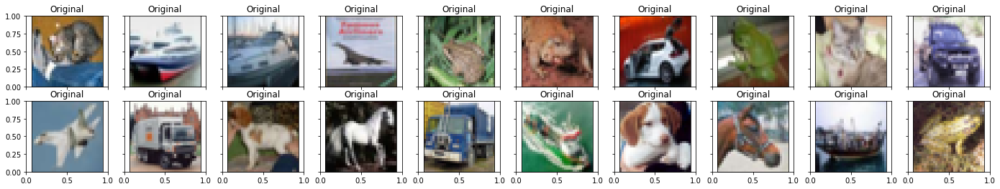

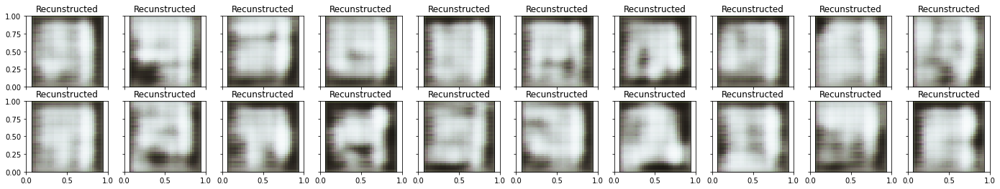

Autoencoder: G_loss: 0.61164
tensor(0.0282, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0335, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
D loss is increasing
tensor(0.0200, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0227, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0241, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0221, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0215, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0266, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
[8/8] D_loss: 0.02660 G_loss: 0.02485
[8/8] G_loss: 0.14235

 EPOCH 14/200 	 train loss 0.6116443872451782 	 val loss 0.6646208167076111


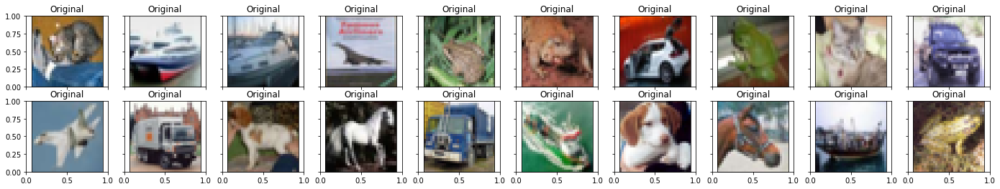

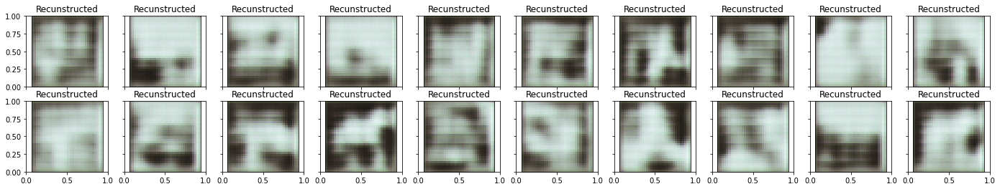

Autoencoder: G_loss: 0.60739
tensor(0.0231, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0244, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0304, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
D loss is increasing
tensor(0.0224, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0231, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0208, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0277, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0349, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
D loss is increasing
[8/8] D_loss: 0.03493 G_loss: 0.02585
[8/8] G_loss: 0.00162

 EPOCH 15/200 	 train loss 0.6073874235153198 	 val loss 0.6123773455619812


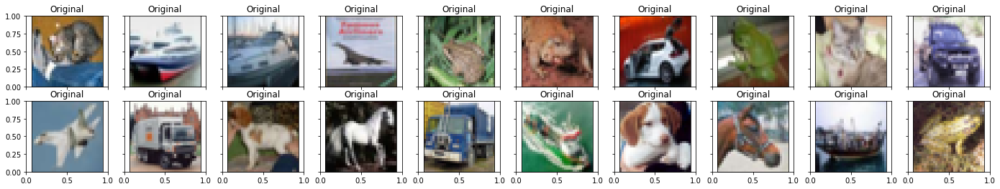

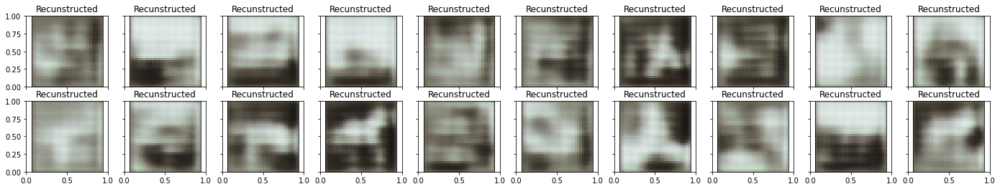

Autoencoder: G_loss: 0.59708
tensor(0.0714, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
D loss is increasing
tensor(0.0287, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0339, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
D loss is increasing
tensor(0.0394, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
D loss is increasing
tensor(0.0593, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
D loss is increasing
tensor(0.0396, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
D loss is increasing
tensor(0.0370, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
D loss is increasing
tensor(0.0419, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
D loss is increasing
[8/8] D_loss: 0.04187 G_loss: 0.04389
[8/8] G_loss: 0.04118

 EPOCH 16/200 	 train loss 0.5970815420150757 	 val loss 0.6470227837562561


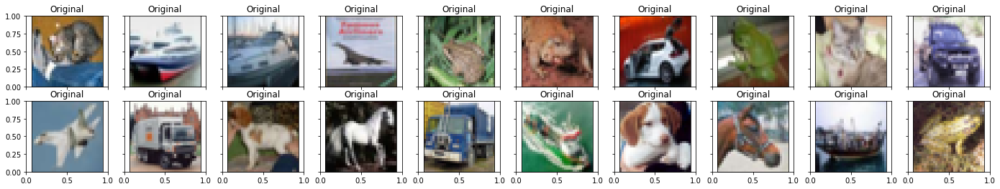

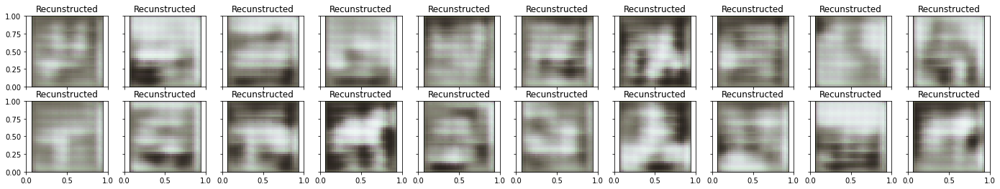

Autoencoder: G_loss: 0.59971
tensor(0.0349, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
D loss is increasing
tensor(0.0242, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0278, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0249, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0228, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0244, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0242, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0241, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
[8/8] D_loss: 0.02406 G_loss: 0.02592
[8/8] G_loss: 0.01619

 EPOCH 17/200 	 train loss 0.5997074842453003 	 val loss 0.6318249702453613


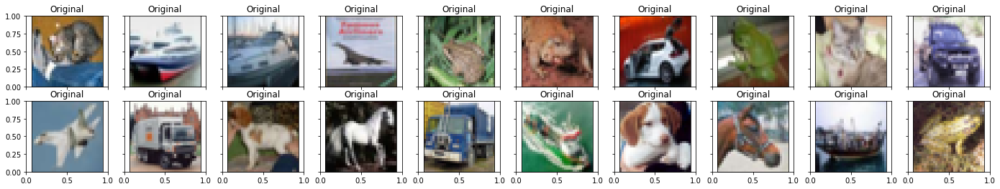

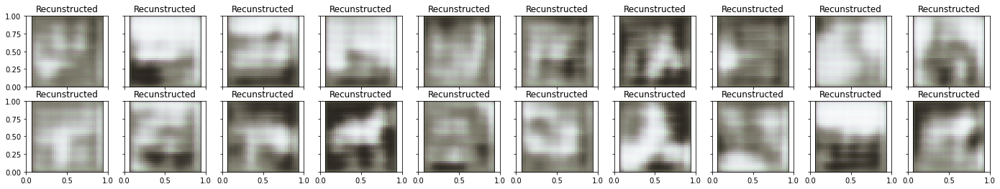

Autoencoder: G_loss: 0.59325
tensor(0.0223, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0193, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0229, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0231, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0230, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0212, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0200, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0333, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
D loss is increasing
[8/8] D_loss: 0.03325 G_loss: 0.02312
[8/8] G_loss: 0.02174

 EPOCH 18/200 	 train loss 0.5932508707046509 	 val loss 0.6511992812156677


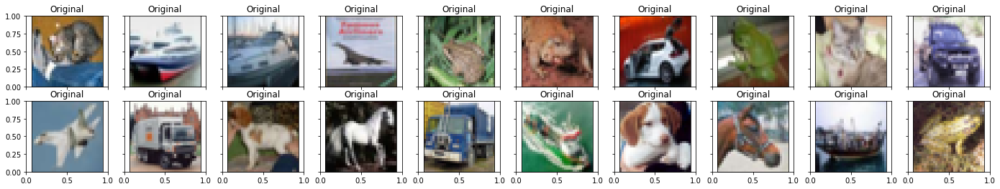

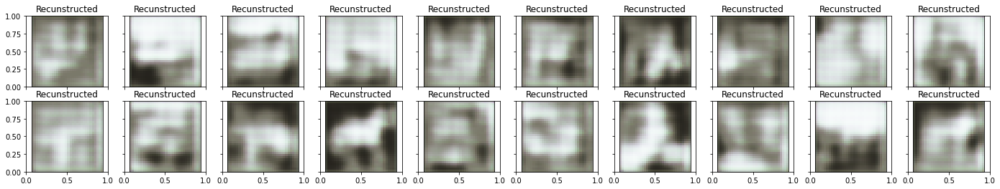

Autoencoder: G_loss: 0.59432
tensor(0.0138, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0149, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0116, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0111, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0124, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0130, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0116, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0126, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
[8/8] D_loss: 0.01265 G_loss: 0.01265
[8/8] G_loss: 0.01678

 EPOCH 19/200 	 train loss 0.5943187475204468 	 val loss 0.6033238172531128


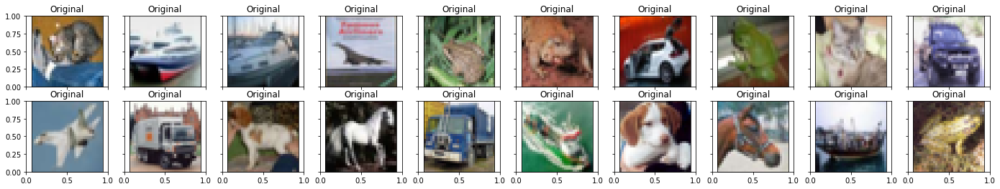

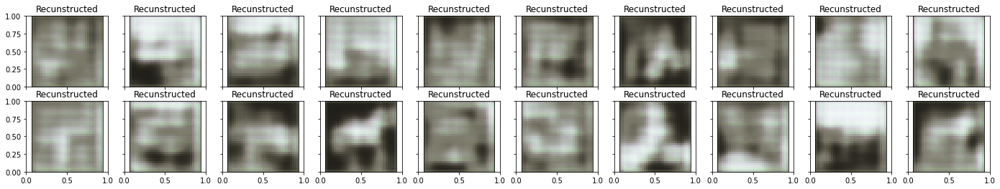

Autoencoder: G_loss: 0.59242
tensor(0.0157, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0145, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0159, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0151, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0146, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0134, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0145, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0169, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
[8/8] D_loss: 0.01685 G_loss: 0.01507
[8/8] G_loss: 0.01905

 EPOCH 20/200 	 train loss 0.5924227833747864 	 val loss 0.6017634272575378


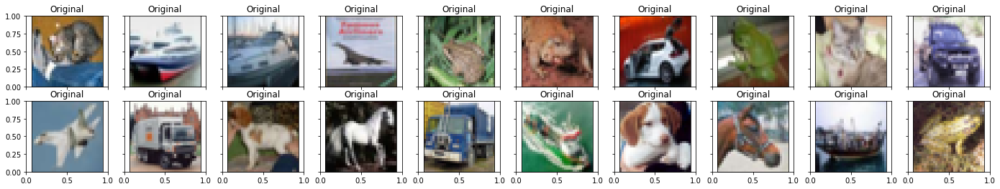

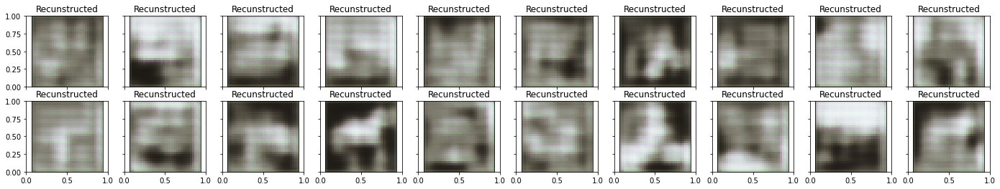

Autoencoder: G_loss: 0.59199
tensor(0.0181, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0169, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0177, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0174, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0194, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0180, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0190, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0277, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
[8/8] D_loss: 0.02765 G_loss: 0.01927
[8/8] G_loss: 0.01553

 EPOCH 21/200 	 train loss 0.5919868350028992 	 val loss 0.6045964360237122


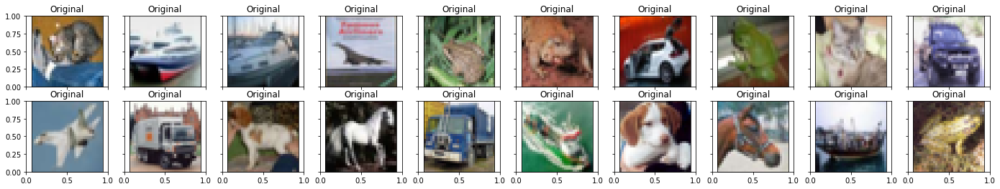

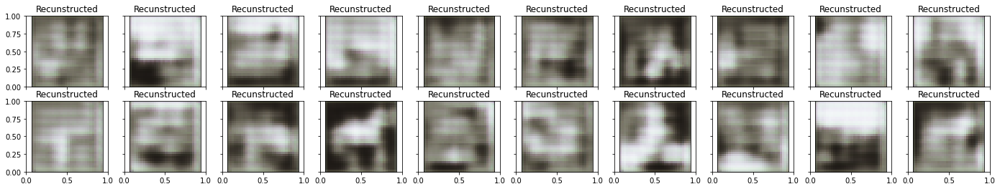

Autoencoder: G_loss: 0.59024
tensor(0.0221, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0234, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0211, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0213, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0227, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0213, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0228, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0238, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
[8/8] D_loss: 0.02376 G_loss: 0.02231
[8/8] G_loss: 0.01219

 EPOCH 22/200 	 train loss 0.5902390480041504 	 val loss 0.635434091091156


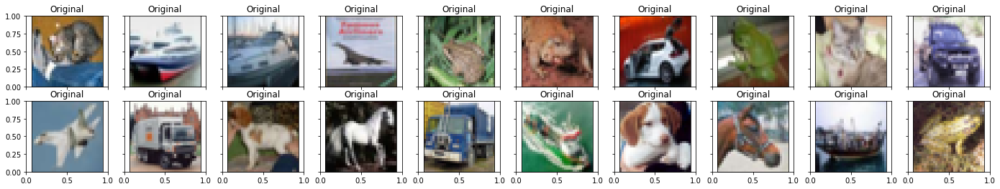

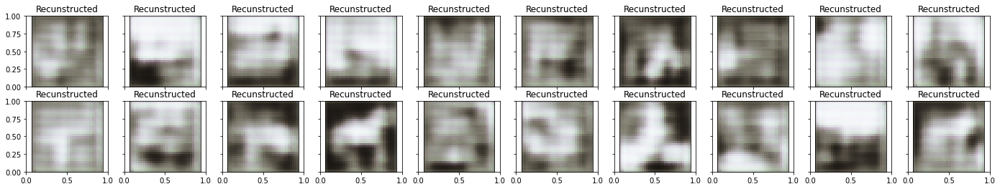

Autoencoder: G_loss: 0.59041
tensor(0.0227, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0223, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0249, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0243, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0227, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0244, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0233, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0233, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
[8/8] D_loss: 0.02333 G_loss: 0.02349
[8/8] G_loss: 0.01352

 EPOCH 23/200 	 train loss 0.5904080867767334 	 val loss 0.655066192150116


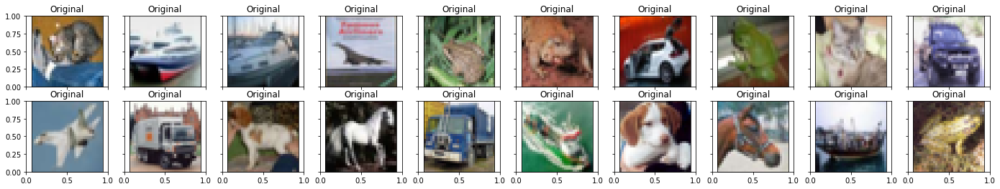

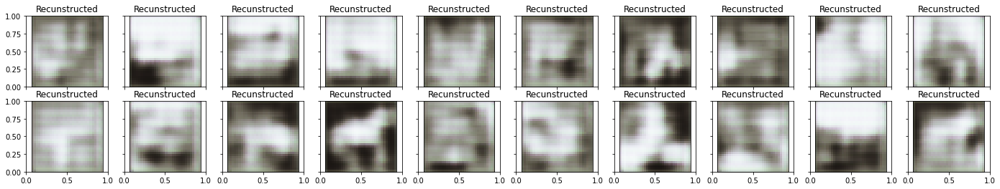

Autoencoder: G_loss: 0.59087
tensor(0.0294, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0286, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0314, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
D loss is increasing
tensor(0.0395, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
D loss is increasing
tensor(0.0279, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0324, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
D loss is increasing
tensor(0.0221, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0328, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
D loss is increasing
[8/8] D_loss: 0.03281 G_loss: 0.03050
[8/8] G_loss: 0.02452

 EPOCH 24/200 	 train loss 0.5908708572387695 	 val loss 0.6287084817886353


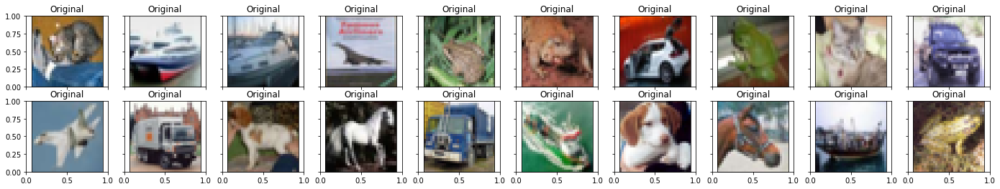

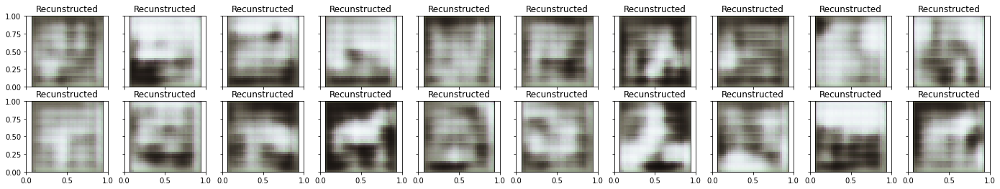

Autoencoder: G_loss: 0.59346
tensor(0.0220, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0216, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0233, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0221, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0257, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0221, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0209, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0185, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
[8/8] D_loss: 0.01851 G_loss: 0.02203
[8/8] G_loss: 0.03310

 EPOCH 25/200 	 train loss 0.5934638381004333 	 val loss 0.6196163892745972


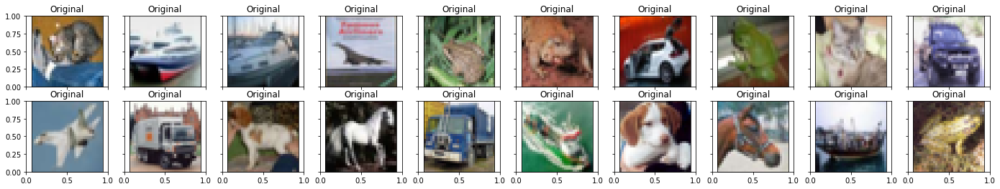

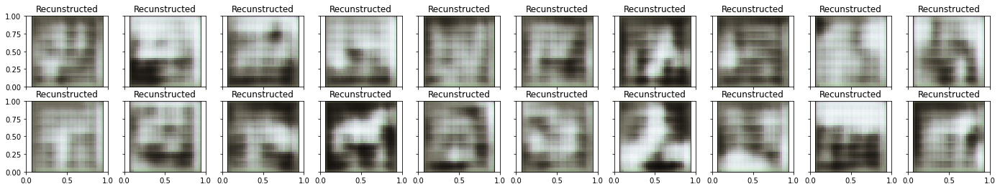

Autoencoder: G_loss: 0.59518
tensor(0.0205, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0161, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0213, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0222, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0209, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0195, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0206, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0268, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
[8/8] D_loss: 0.02683 G_loss: 0.02100
[8/8] G_loss: 0.04558

 EPOCH 26/200 	 train loss 0.5951826572418213 	 val loss 0.7142339944839478


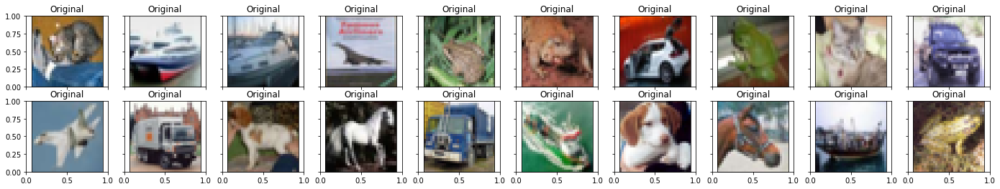

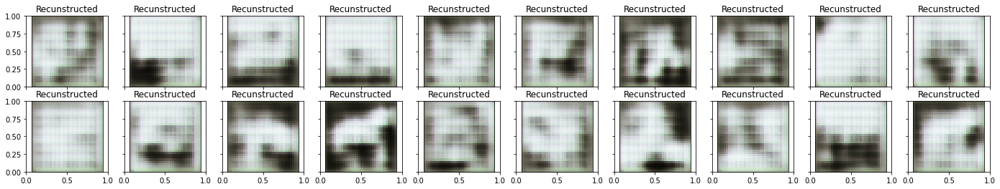

Autoencoder: G_loss: 0.59537
tensor(0.0174, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0222, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0219, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0188, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0210, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0184, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0199, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0240, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
[8/8] D_loss: 0.02401 G_loss: 0.02045
[8/8] G_loss: 0.02240

 EPOCH 27/200 	 train loss 0.595366358757019 	 val loss 0.620154857635498


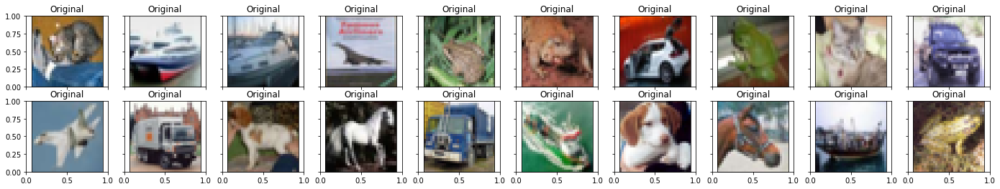

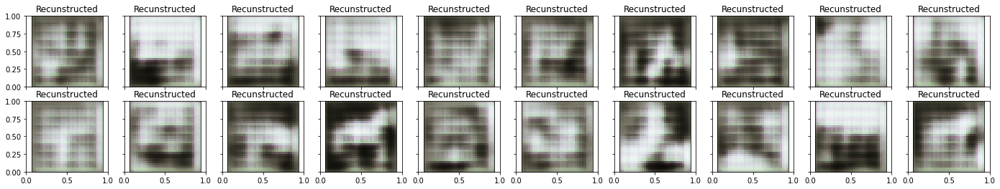

Autoencoder: G_loss: 0.59293
tensor(0.0182, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0182, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0202, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0190, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0204, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0191, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0200, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0157, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
[8/8] D_loss: 0.01570 G_loss: 0.01885
[8/8] G_loss: 0.02849

 EPOCH 28/200 	 train loss 0.5929321050643921 	 val loss 0.6766618490219116


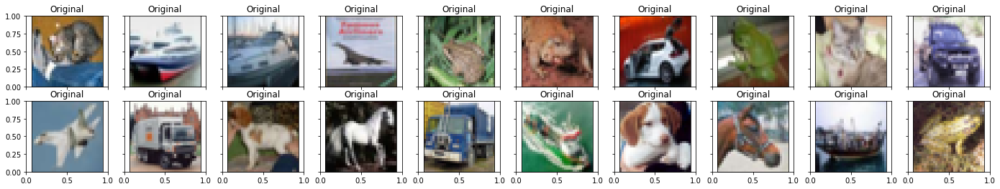

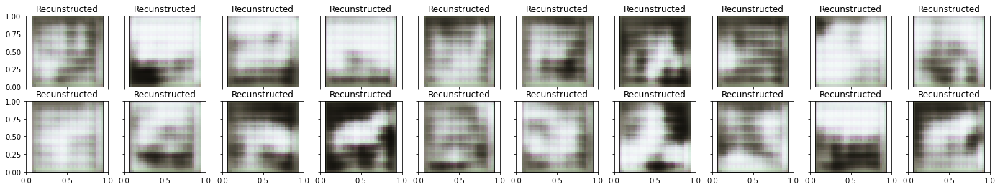

Autoencoder: G_loss: 0.59313
tensor(0.0228, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0235, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0278, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0222, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0249, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0232, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0244, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0244, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
[8/8] D_loss: 0.02444 G_loss: 0.02415
[8/8] G_loss: 0.01640

 EPOCH 29/200 	 train loss 0.5931288599967957 	 val loss 0.627659261226654


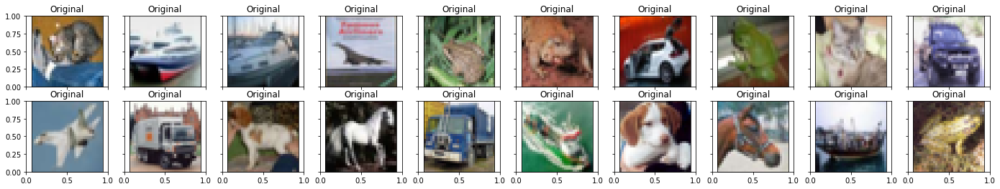

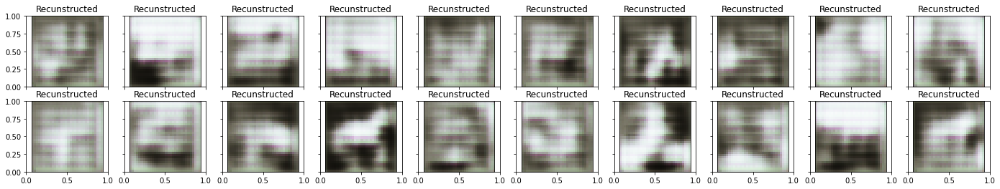

Autoencoder: G_loss: 0.59077
tensor(0.0221, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0252, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0245, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0245, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0263, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0259, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0253, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0236, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
[8/8] D_loss: 0.02363 G_loss: 0.02467
[8/8] G_loss: 0.01343

 EPOCH 30/200 	 train loss 0.5907680988311768 	 val loss 0.6238745450973511


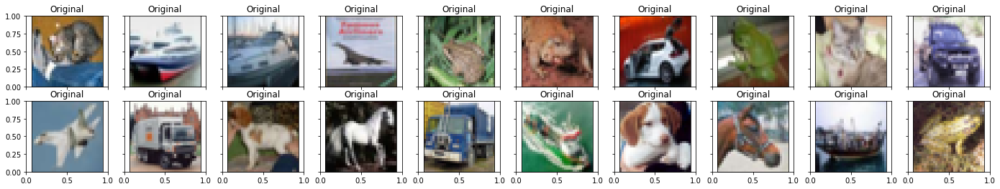

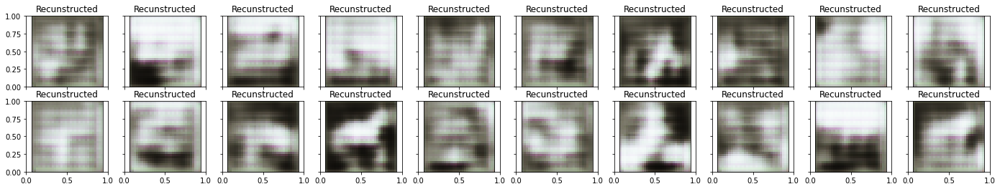

Autoencoder: G_loss: 0.58953
tensor(0.0291, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0369, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
D loss is increasing
tensor(0.0363, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
D loss is increasing
tensor(0.0356, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
D loss is increasing
tensor(0.0287, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0265, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0294, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0298, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
[8/8] D_loss: 0.02975 G_loss: 0.03154
[8/8] G_loss: 0.03209

 EPOCH 31/200 	 train loss 0.5895330905914307 	 val loss 0.6232776045799255


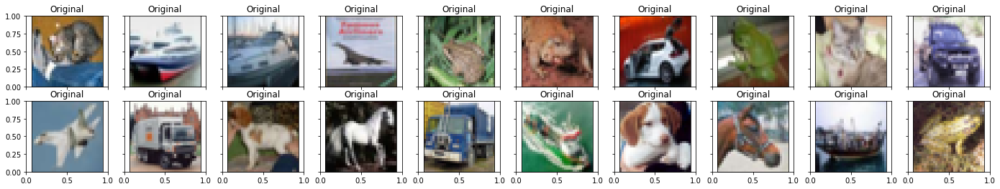

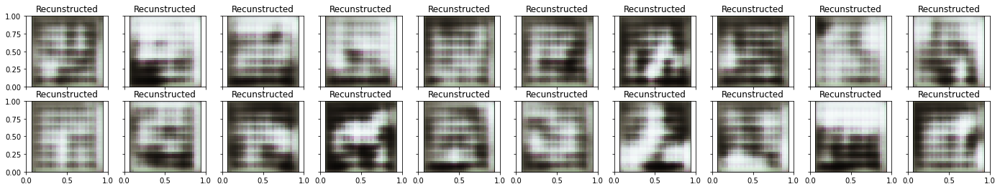

Autoencoder: G_loss: 0.59344
tensor(0.0316, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
D loss is increasing
tensor(0.0319, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
D loss is increasing
tensor(0.0272, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0279, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0266, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0259, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0273, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0195, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
[8/8] D_loss: 0.01952 G_loss: 0.02723
[8/8] G_loss: 0.05096

 EPOCH 32/200 	 train loss 0.5934404134750366 	 val loss 0.6199434399604797


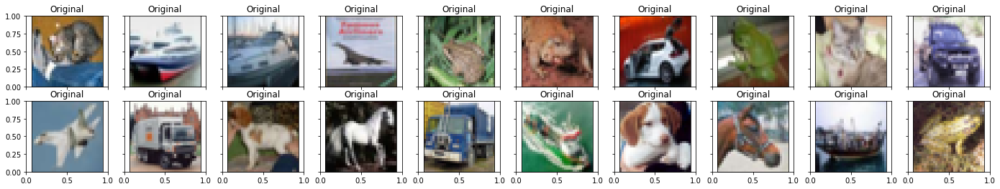

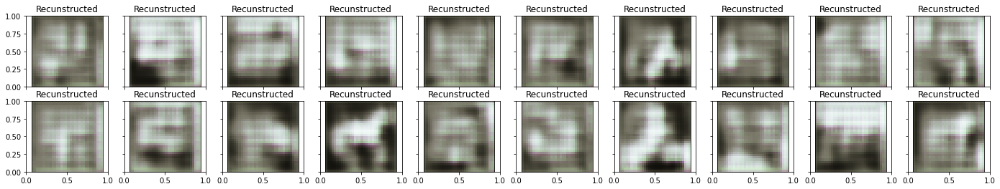

Autoencoder: G_loss: 0.59772
tensor(0.0213, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0249, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0190, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0213, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0193, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0182, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0222, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0172, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
[8/8] D_loss: 0.01715 G_loss: 0.02040
[8/8] G_loss: 0.11919

 EPOCH 33/200 	 train loss 0.5977200269699097 	 val loss 0.6621115803718567


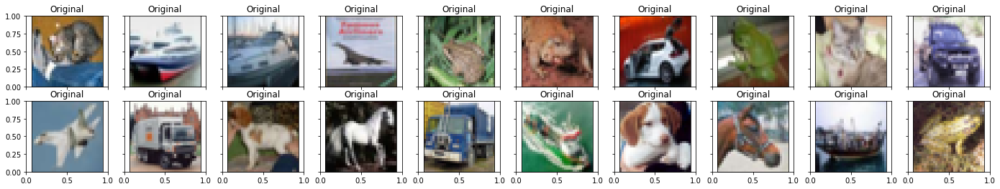

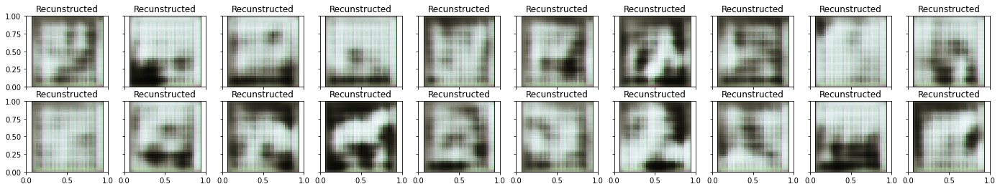

Autoencoder: G_loss: 0.59861
tensor(0.0231, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0229, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0239, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0262, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0269, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0233, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0228, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0247, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
[8/8] D_loss: 0.02472 G_loss: 0.02423
[8/8] G_loss: 0.02803

 EPOCH 34/200 	 train loss 0.5986123085021973 	 val loss 0.6296871900558472


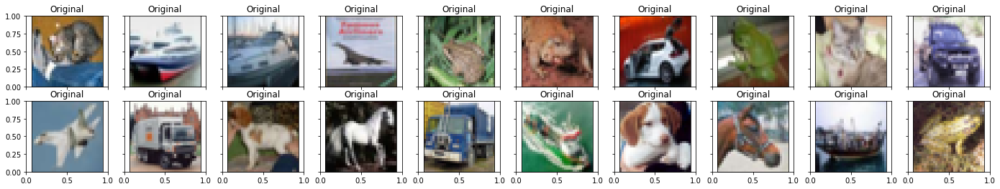

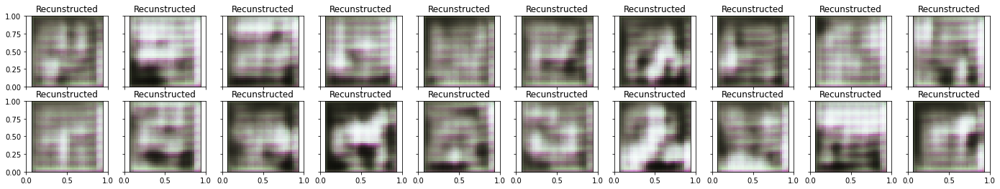

Autoencoder: G_loss: 0.59683
tensor(0.0198, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0219, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0230, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0207, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0206, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0222, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0196, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0186, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
[8/8] D_loss: 0.01864 G_loss: 0.02079
[8/8] G_loss: 0.08779

 EPOCH 35/200 	 train loss 0.5968323945999146 	 val loss 0.6346850395202637


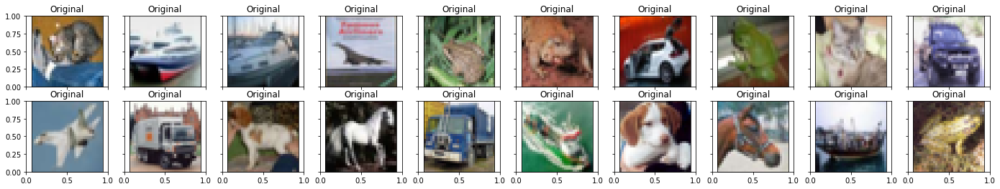

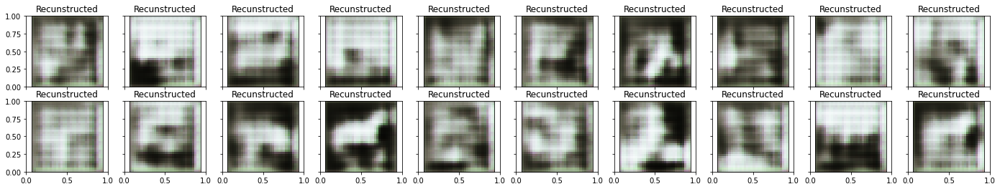

Autoencoder: G_loss: 0.59684
tensor(0.0254, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0218, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0212, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0242, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0247, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0257, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0277, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0281, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
[8/8] D_loss: 0.02807 G_loss: 0.02483
[8/8] G_loss: 0.01436

 EPOCH 36/200 	 train loss 0.5968353152275085 	 val loss 0.6004108786582947


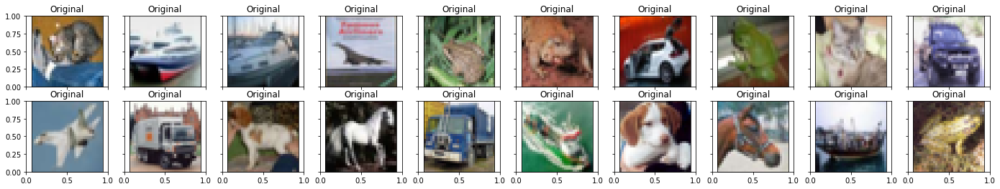

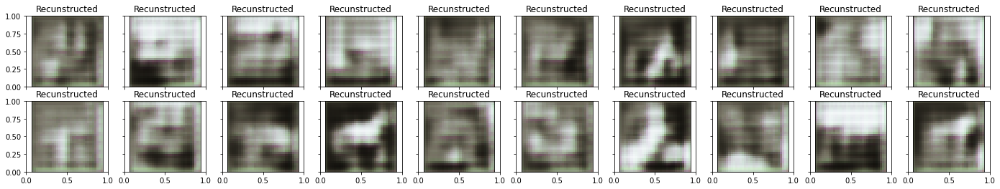

Autoencoder: G_loss: 0.59223
tensor(0.0222, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0226, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0211, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0216, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0252, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0252, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0234, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0305, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
D loss is increasing
[8/8] D_loss: 0.03048 G_loss: 0.02396
[8/8] G_loss: 0.02481

 EPOCH 37/200 	 train loss 0.5922309160232544 	 val loss 0.6039717197418213


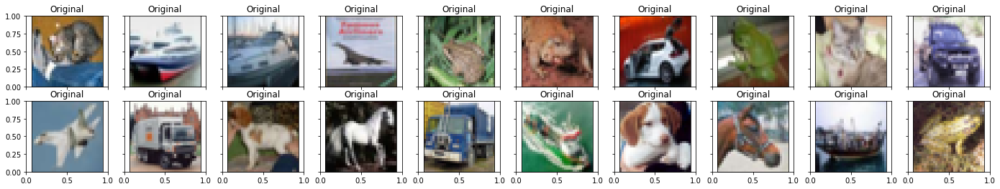

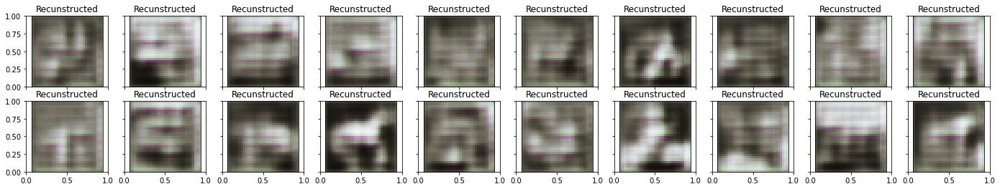

Autoencoder: G_loss: 0.59119
tensor(0.0256, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0177, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0194, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0203, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0174, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0214, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0211, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0126, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
[8/8] D_loss: 0.01256 G_loss: 0.01942
[8/8] G_loss: 0.01817

 EPOCH 38/200 	 train loss 0.5911880731582642 	 val loss 0.6019294857978821


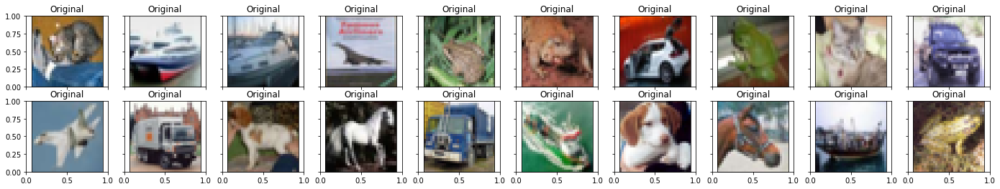

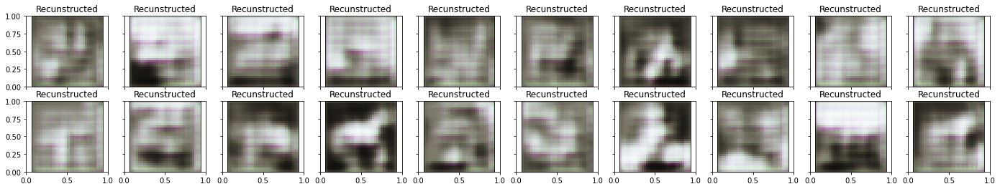

Autoencoder: G_loss: 0.58898
tensor(0.0235, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0274, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0307, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
D loss is increasing
tensor(0.0222, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0355, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
D loss is increasing
tensor(0.0243, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0223, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0306, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
D loss is increasing
[8/8] D_loss: 0.03064 G_loss: 0.02705
[8/8] G_loss: 0.00279

 EPOCH 39/200 	 train loss 0.5889831185340881 	 val loss 0.5935371518135071


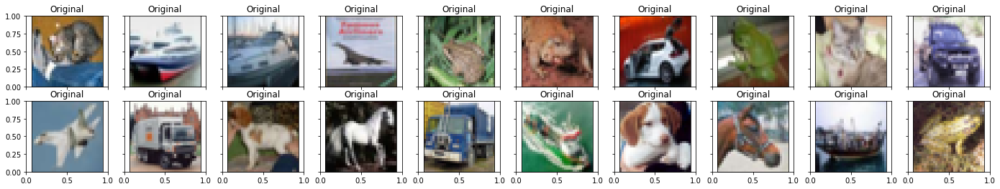

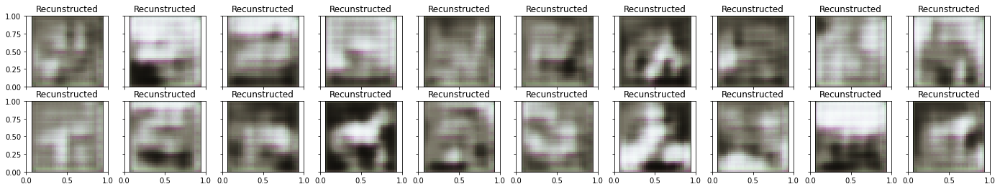

Autoencoder: G_loss: 0.58756
tensor(0.0470, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
D loss is increasing
tensor(0.0215, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0220, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0250, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0210, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0408, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
D loss is increasing
tensor(0.0232, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0121, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
[8/8] D_loss: 0.01209 G_loss: 0.02657
[8/8] G_loss: 0.00810

 EPOCH 40/200 	 train loss 0.5875565409660339 	 val loss 0.6020457148551941


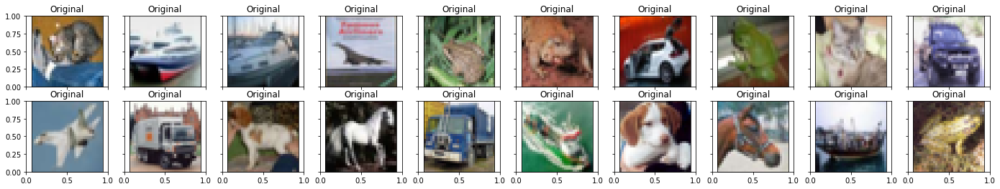

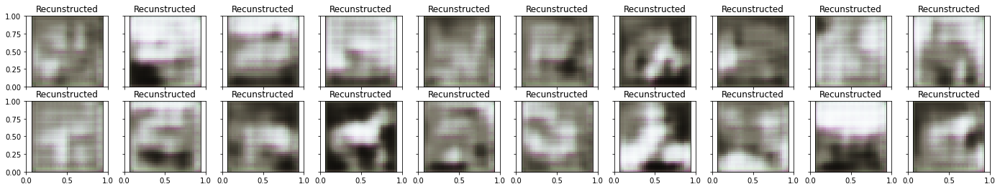

Autoencoder: G_loss: 0.58717
tensor(0.0144, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0226, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0140, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0148, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0226, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0197, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0219, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0163, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
[8/8] D_loss: 0.01631 G_loss: 0.01829
[8/8] G_loss: 0.00812

 EPOCH 41/200 	 train loss 0.5871676206588745 	 val loss 0.6082249879837036


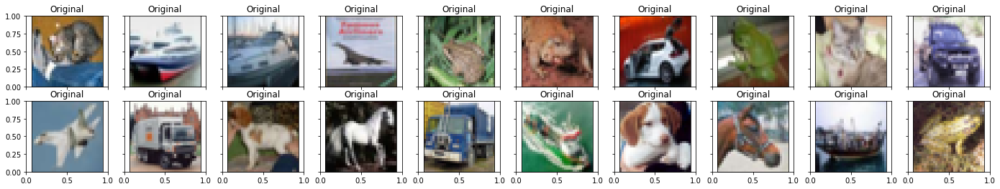

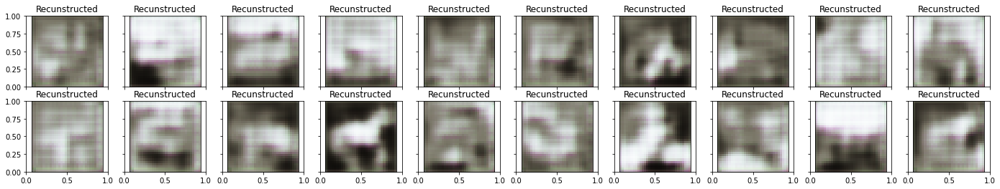

Autoencoder: G_loss: 0.58721
tensor(0.0253, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0176, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0411, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
D loss is increasing
tensor(0.0128, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0152, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0162, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0107, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0135, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
[8/8] D_loss: 0.01350 G_loss: 0.01906
[8/8] G_loss: 0.01283

 EPOCH 42/200 	 train loss 0.5872060060501099 	 val loss 0.6174481511116028


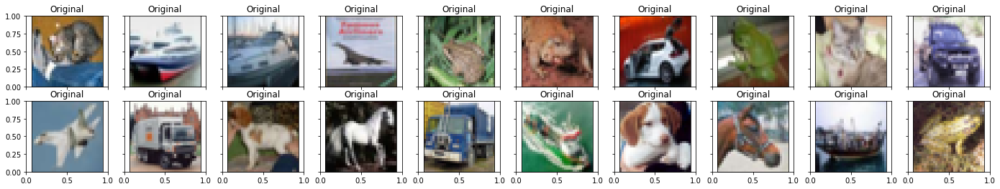

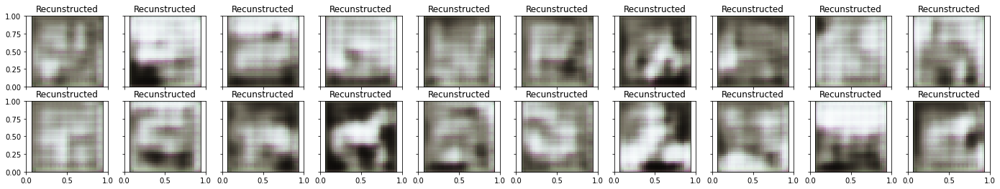

Autoencoder: G_loss: 0.58843
tensor(0.0233, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0138, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0219, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0147, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0139, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0226, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0222, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0121, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
[8/8] D_loss: 0.01214 G_loss: 0.01807
[8/8] G_loss: 0.01611

 EPOCH 43/200 	 train loss 0.5884304642677307 	 val loss 0.6065998673439026


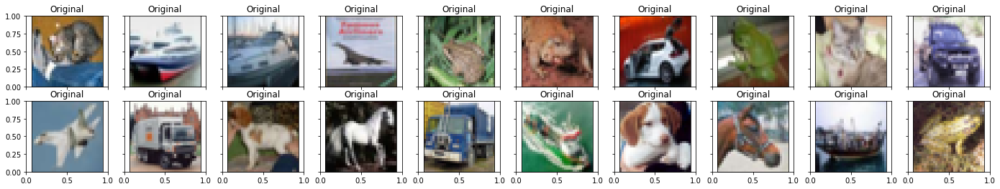

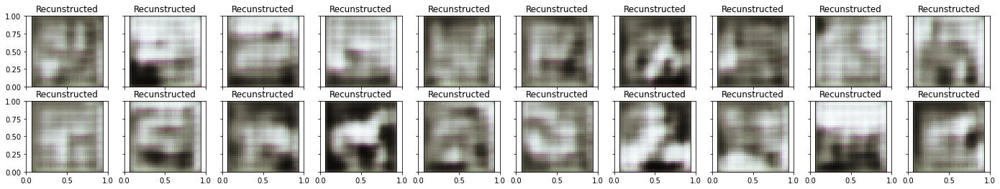

Autoencoder: G_loss: 0.58854
tensor(0.0144, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0153, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0132, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0127, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0144, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0143, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0124, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0101, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
[8/8] D_loss: 0.01005 G_loss: 0.01336
[8/8] G_loss: 0.01697

 EPOCH 44/200 	 train loss 0.5885369181632996 	 val loss 0.6133983731269836


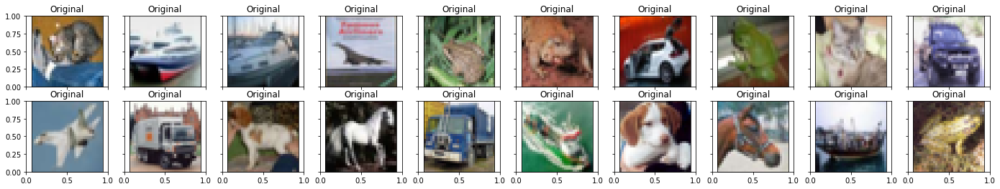

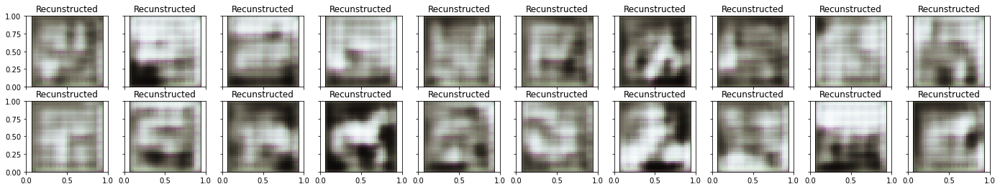

Autoencoder: G_loss: 0.58894
tensor(0.0128, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0143, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0142, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0141, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0132, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0150, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0134, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0227, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
[8/8] D_loss: 0.02266 G_loss: 0.01494
[8/8] G_loss: 0.01422

 EPOCH 45/200 	 train loss 0.5889372825622559 	 val loss 0.6240204572677612


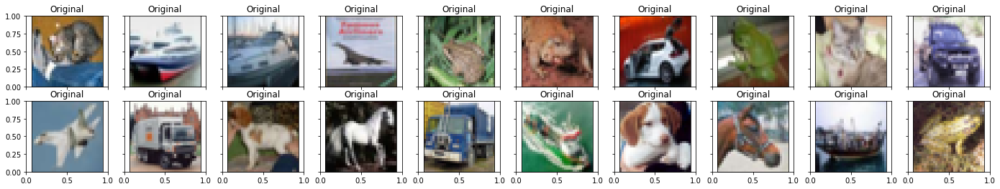

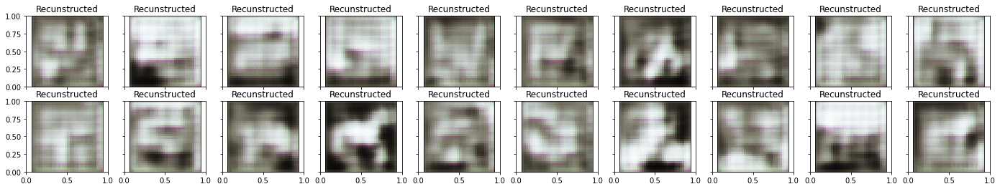

Autoencoder: G_loss: 0.58878
tensor(0.0124, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0153, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0112, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0148, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0141, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0130, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0146, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0170, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
[8/8] D_loss: 0.01697 G_loss: 0.01404
[8/8] G_loss: 0.01325

 EPOCH 46/200 	 train loss 0.5887805223464966 	 val loss 0.6068906188011169


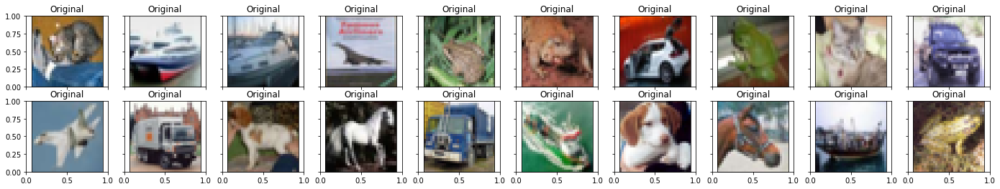

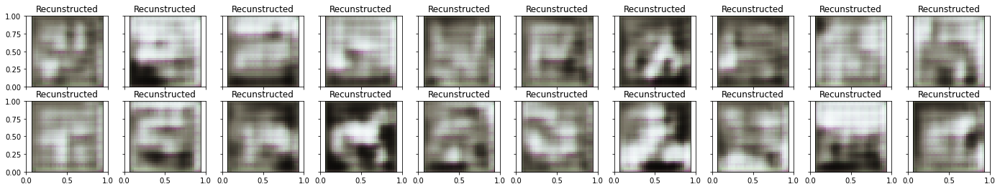

Autoencoder: G_loss: 0.58816
tensor(0.0153, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0136, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0129, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0139, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0143, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0164, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0143, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0132, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
[8/8] D_loss: 0.01320 G_loss: 0.01424
[8/8] G_loss: 0.01242

 EPOCH 47/200 	 train loss 0.5881645083427429 	 val loss 0.601100504398346


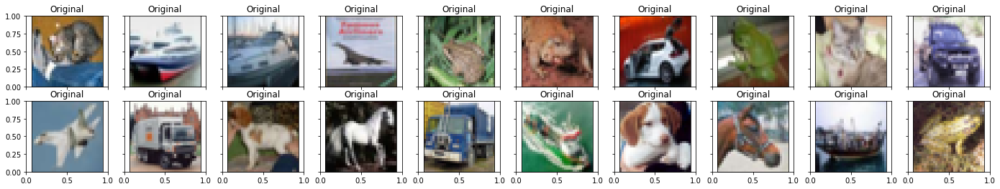

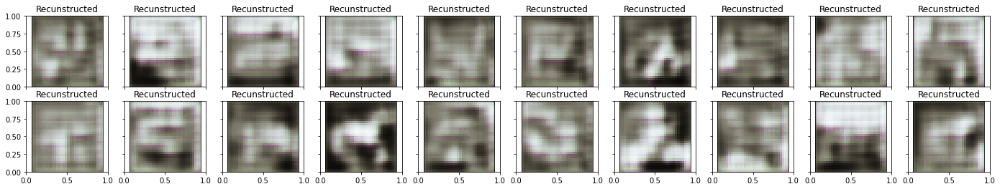

Autoencoder: G_loss: 0.58771
tensor(0.0172, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0138, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0155, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0146, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0182, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0160, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0178, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0147, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
[8/8] D_loss: 0.01467 G_loss: 0.01597
[8/8] G_loss: 0.01255

 EPOCH 48/200 	 train loss 0.5877144932746887 	 val loss 0.6096861958503723


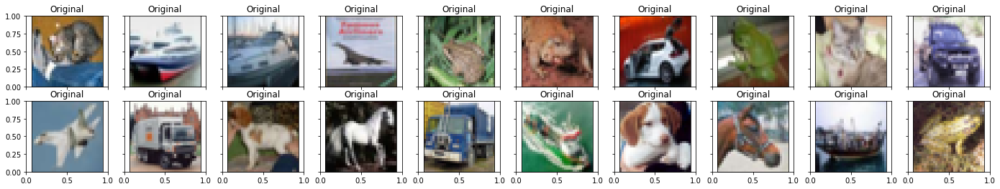

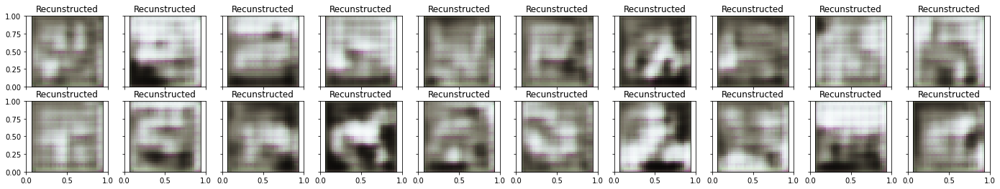

Autoencoder: G_loss: 0.58737
tensor(0.0181, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0181, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0180, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0212, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0171, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0146, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0133, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0140, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
[8/8] D_loss: 0.01399 G_loss: 0.01680
[8/8] G_loss: 0.01151

 EPOCH 49/200 	 train loss 0.5873690843582153 	 val loss 0.600210964679718


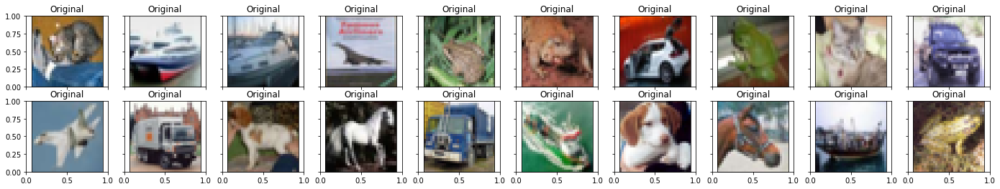

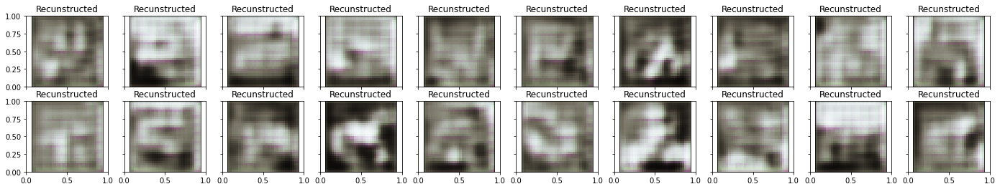

Autoencoder: G_loss: 0.58731
tensor(0.0154, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0217, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0136, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0170, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0170, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0147, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0167, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0146, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
[8/8] D_loss: 0.01464 G_loss: 0.01636
[8/8] G_loss: 0.01141

 EPOCH 50/200 	 train loss 0.5873139500617981 	 val loss 0.6027272343635559


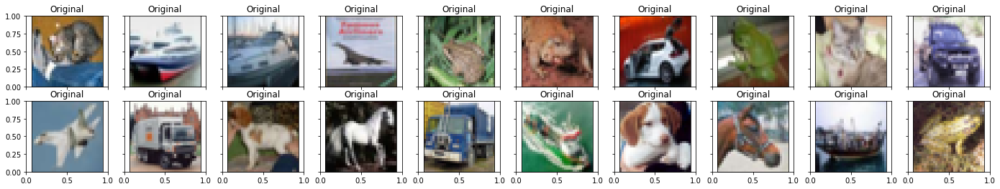

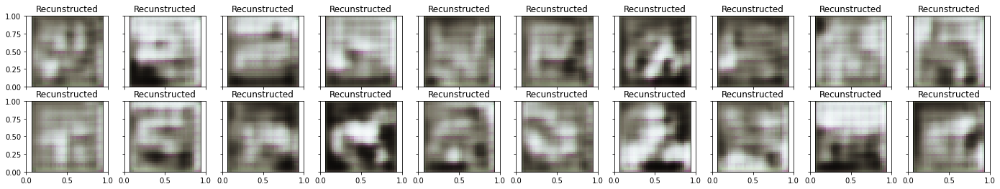

Autoencoder: G_loss: 0.58690
tensor(0.0145, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0173, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0156, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0168, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0219, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0180, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0221, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0133, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
[8/8] D_loss: 0.01326 G_loss: 0.01744
[8/8] G_loss: 0.01088

 EPOCH 51/200 	 train loss 0.5869027972221375 	 val loss 0.6004299521446228


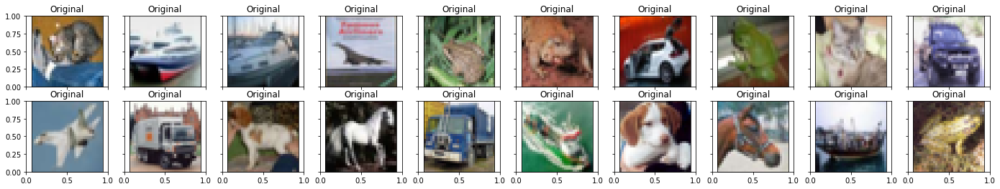

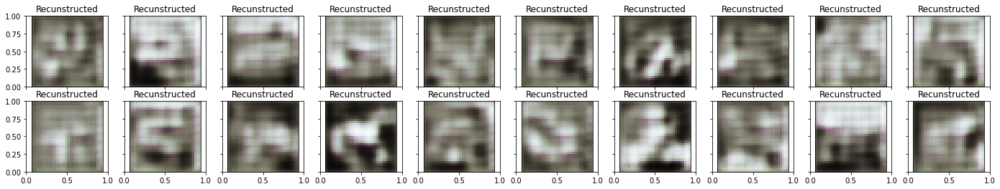

Autoencoder: G_loss: 0.58697
tensor(0.0263, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0183, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0171, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0171, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0172, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0200, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0218, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0192, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
[8/8] D_loss: 0.01918 G_loss: 0.01963
[8/8] G_loss: 0.01079

 EPOCH 52/200 	 train loss 0.5869665741920471 	 val loss 0.6024607419967651


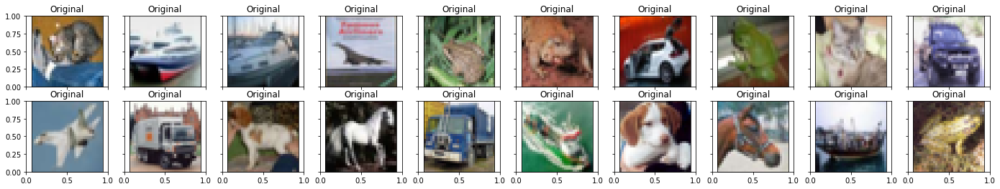

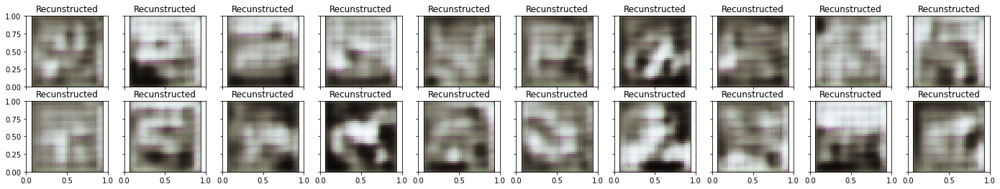

Autoencoder: G_loss: 0.58631
tensor(0.0177, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0240, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0339, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
D loss is increasing
tensor(0.0181, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0175, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0203, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0204, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0144, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
[8/8] D_loss: 0.01442 G_loss: 0.02079
[8/8] G_loss: 0.01668

 EPOCH 53/200 	 train loss 0.5863096714019775 	 val loss 0.6216806769371033


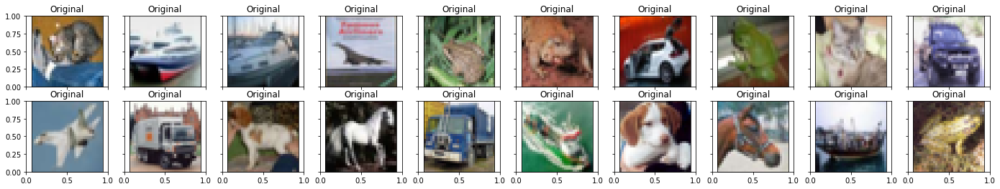

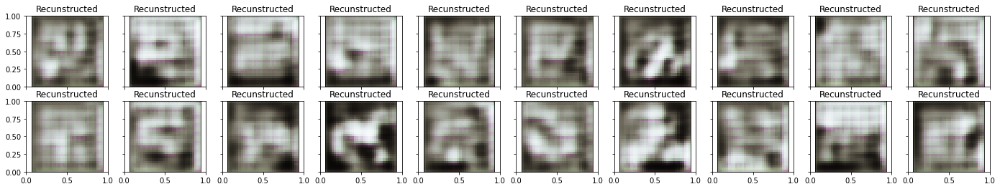

Autoencoder: G_loss: 0.58822
tensor(0.0137, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0150, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0161, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0181, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0182, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0184, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0172, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0199, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
[8/8] D_loss: 0.01988 G_loss: 0.01707
[8/8] G_loss: 0.02461

 EPOCH 54/200 	 train loss 0.5882223844528198 	 val loss 0.7178647518157959


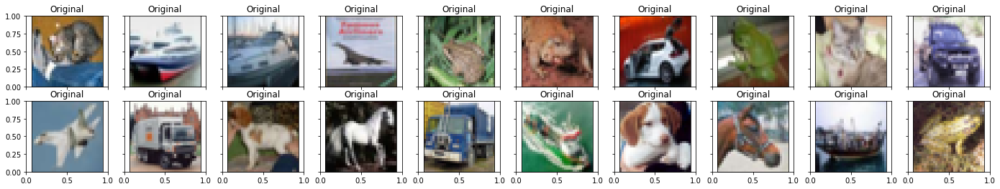

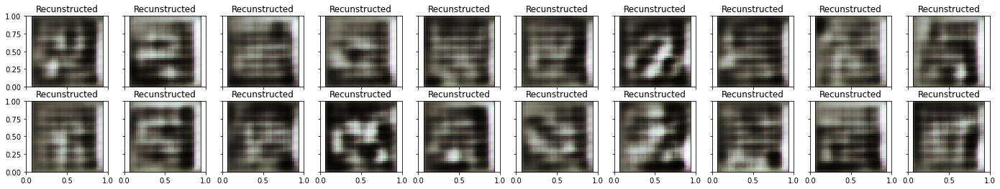

Autoencoder: G_loss: 0.59678
tensor(0.0184, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0124, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0179, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0123, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0170, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0177, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0135, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0162, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
[8/8] D_loss: 0.01617 G_loss: 0.01567
[8/8] G_loss: 0.03115

 EPOCH 55/200 	 train loss 0.5967755913734436 	 val loss 0.6363624930381775


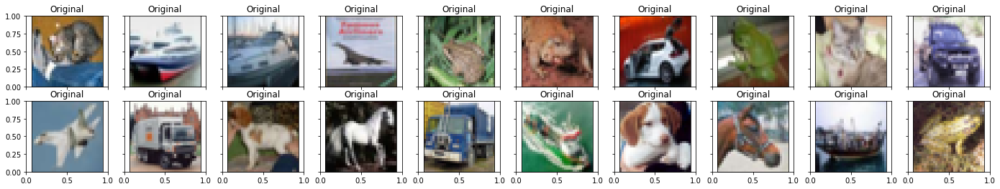

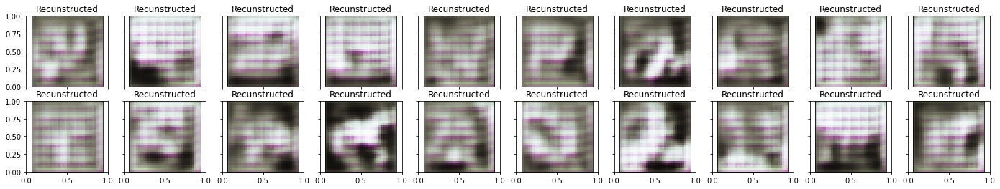

Autoencoder: G_loss: 0.59150
tensor(0.0289, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0293, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0266, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0247, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0276, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0288, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0287, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0334, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
D loss is increasing
[8/8] D_loss: 0.03339 G_loss: 0.02849
[8/8] G_loss: 0.02626

 EPOCH 56/200 	 train loss 0.5914990901947021 	 val loss 0.6709809899330139


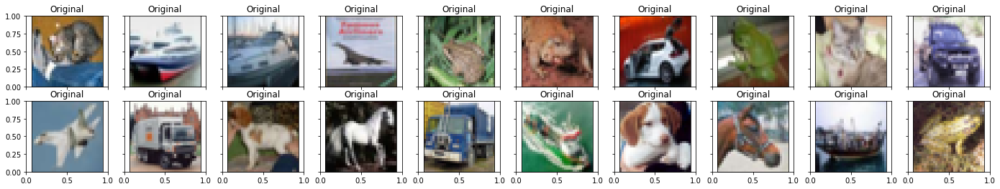

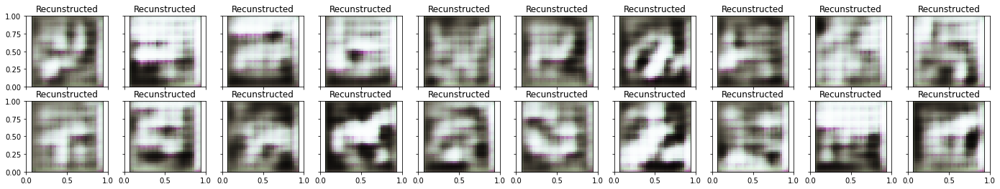

Autoencoder: G_loss: 0.59212
tensor(0.0213, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0217, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0242, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0255, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0201, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0246, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0219, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0282, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
[8/8] D_loss: 0.02817 G_loss: 0.02345
[8/8] G_loss: 0.03704

 EPOCH 57/200 	 train loss 0.5921178460121155 	 val loss 0.6364001035690308


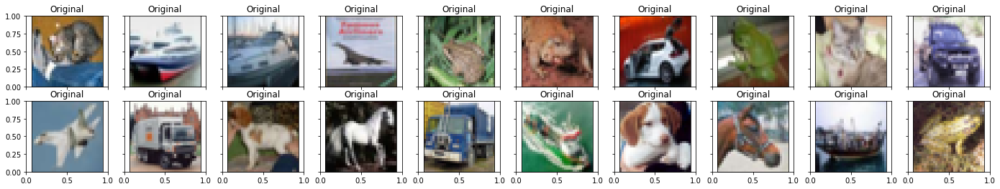

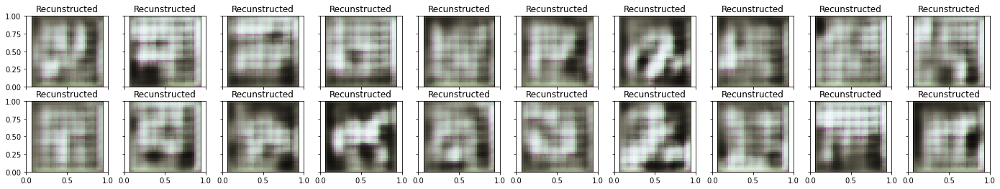

Autoencoder: G_loss: 0.59460
tensor(0.0239, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0250, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0214, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0230, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0216, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0259, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0273, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0196, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
[8/8] D_loss: 0.01955 G_loss: 0.02347
[8/8] G_loss: 0.05812

 EPOCH 58/200 	 train loss 0.5946003198623657 	 val loss 0.6178340911865234


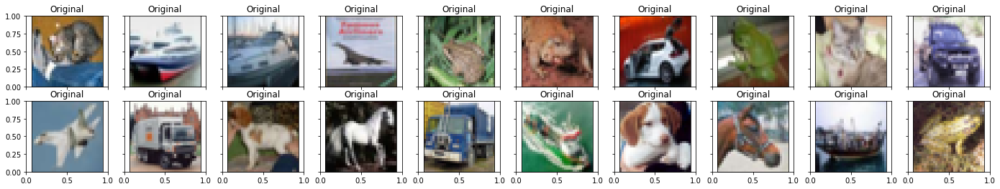

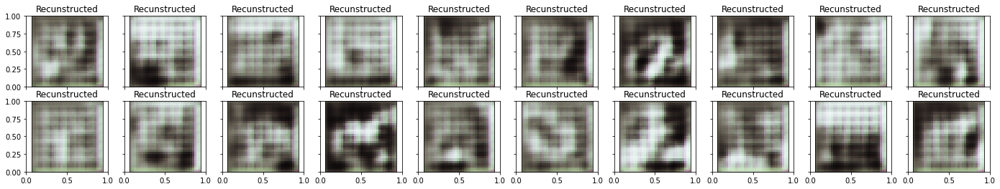

Autoencoder: G_loss: 0.59275
tensor(0.0299, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0263, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0234, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0225, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0256, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0253, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0235, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0221, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
[8/8] D_loss: 0.02208 G_loss: 0.02482
[8/8] G_loss: 0.02336

 EPOCH 59/200 	 train loss 0.5927455425262451 	 val loss 0.6110346913337708


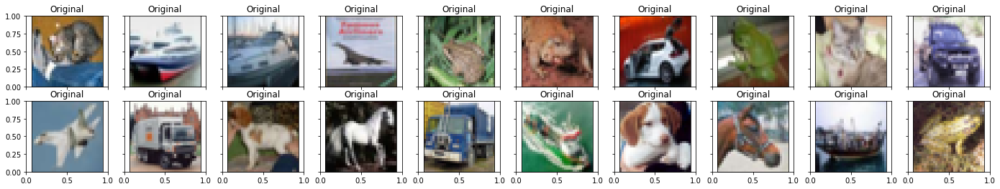

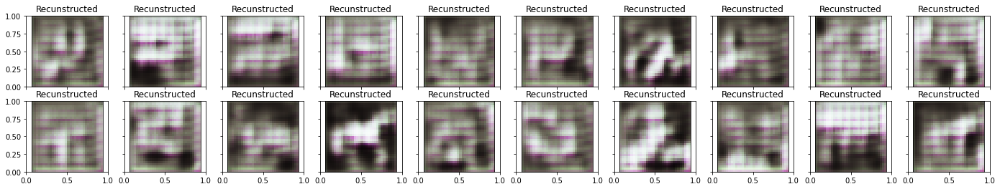

Autoencoder: G_loss: 0.59116
tensor(0.0257, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0222, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0181, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0236, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0207, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0212, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0168, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0249, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
[8/8] D_loss: 0.02493 G_loss: 0.02167
[8/8] G_loss: 0.03138

 EPOCH 60/200 	 train loss 0.5911638736724854 	 val loss 0.6097325682640076


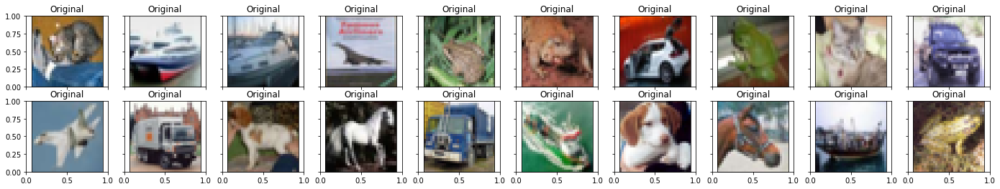

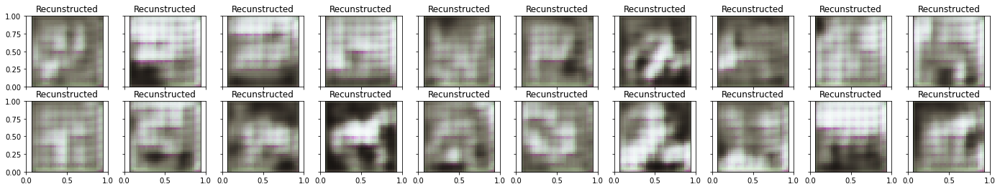

Autoencoder: G_loss: 0.58952
tensor(0.0308, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
D loss is increasing
tensor(0.0308, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
D loss is increasing
tensor(0.0276, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0209, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0258, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0287, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0259, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0158, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
[8/8] D_loss: 0.01577 G_loss: 0.02578
[8/8] G_loss: 0.01505

 EPOCH 61/200 	 train loss 0.5895230770111084 	 val loss 0.6131893396377563


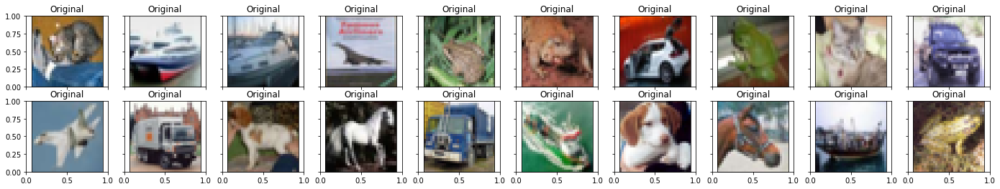

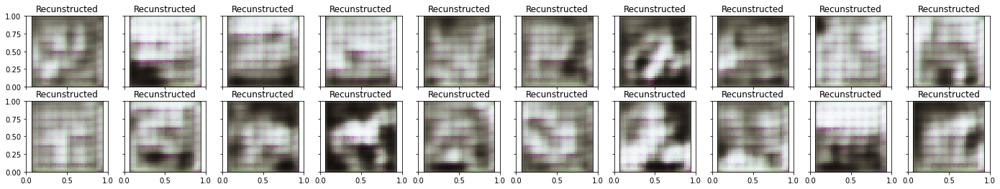

Autoencoder: G_loss: 0.58777
tensor(0.0306, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
D loss is increasing
tensor(0.0288, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0261, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0310, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
D loss is increasing
tensor(0.0251, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0312, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
D loss is increasing
tensor(0.0254, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0260, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
[8/8] D_loss: 0.02598 G_loss: 0.02802
[8/8] G_loss: 0.01014

 EPOCH 62/200 	 train loss 0.587774395942688 	 val loss 0.6072115898132324


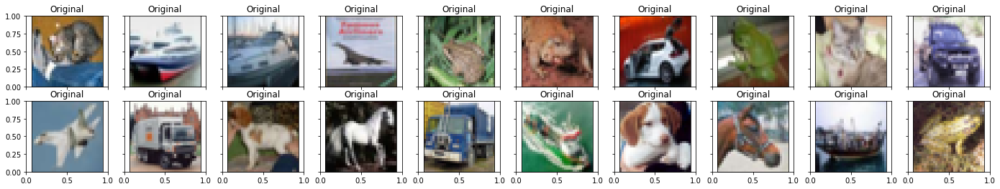

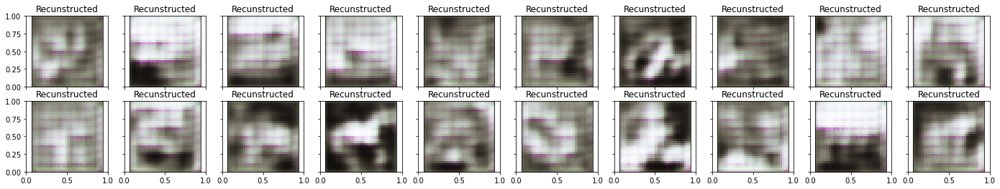

Autoencoder: G_loss: 0.58713
tensor(0.0299, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0317, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
D loss is increasing
tensor(0.0268, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0228, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0253, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0236, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0234, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0222, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
[8/8] D_loss: 0.02224 G_loss: 0.02573
[8/8] G_loss: 0.01363

 EPOCH 63/200 	 train loss 0.5871318578720093 	 val loss 0.6029189825057983


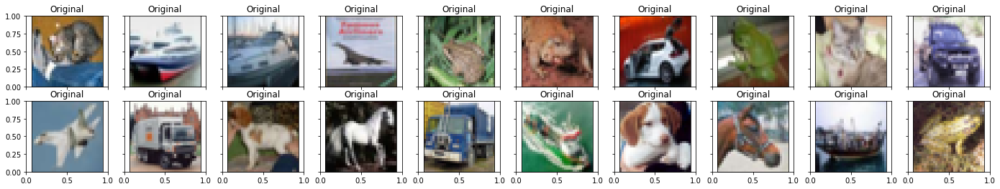

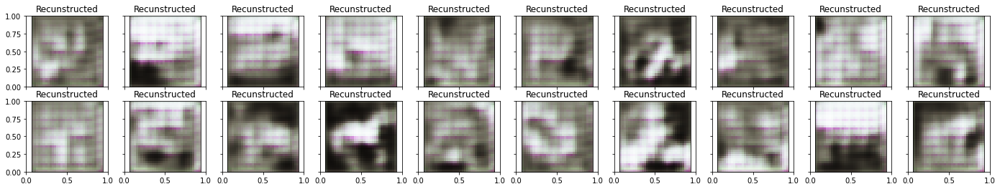

Autoencoder: G_loss: 0.58663
tensor(0.0225, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0234, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0262, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0257, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0229, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0226, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0250, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0310, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
D loss is increasing
[8/8] D_loss: 0.03098 G_loss: 0.02491
[8/8] G_loss: 0.01279

 EPOCH 64/200 	 train loss 0.5866267681121826 	 val loss 0.5972596406936646


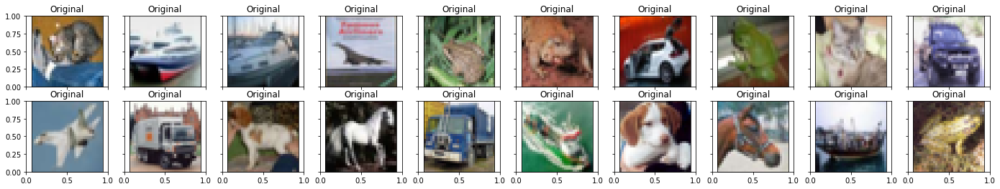

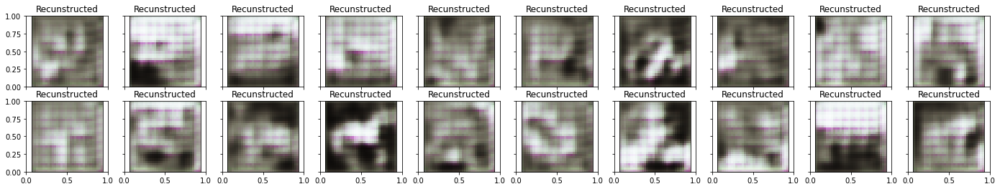

Autoencoder: G_loss: 0.58621
tensor(0.0236, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0239, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0230, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0214, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0246, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0208, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0190, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0202, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
[8/8] D_loss: 0.02019 G_loss: 0.02205
[8/8] G_loss: 0.01288

 EPOCH 65/200 	 train loss 0.5862112045288086 	 val loss 0.6032617092132568


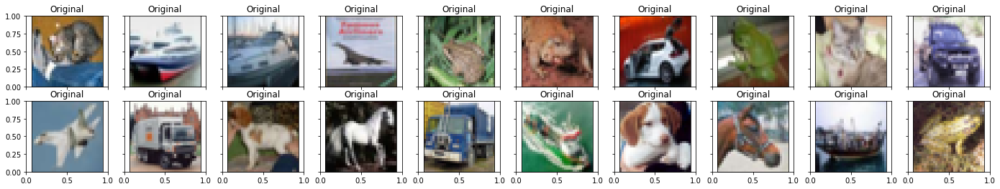

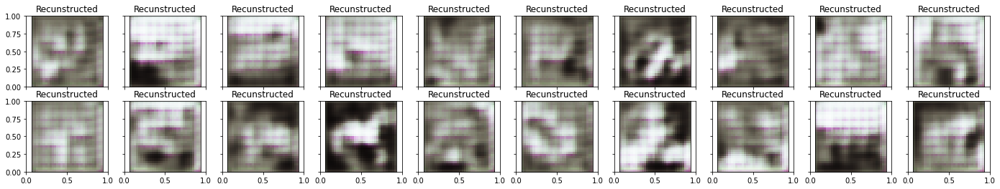

Autoencoder: G_loss: 0.58624
tensor(0.0265, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0243, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0187, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0200, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0216, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0283, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0221, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0124, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
[8/8] D_loss: 0.01239 G_loss: 0.02173
[8/8] G_loss: 0.01368

 EPOCH 66/200 	 train loss 0.5862363576889038 	 val loss 0.5977651476860046


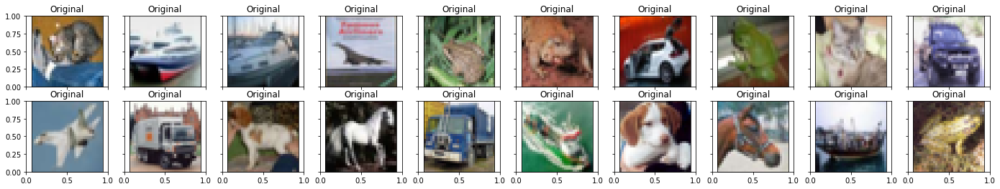

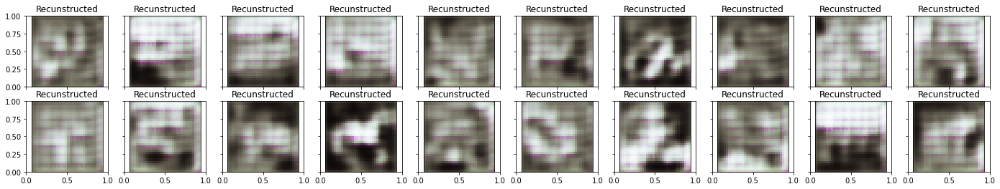

Autoencoder: G_loss: 0.58681
tensor(0.0237, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0227, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0204, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0286, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0274, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0254, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0259, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0188, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
[8/8] D_loss: 0.01881 G_loss: 0.02411
[8/8] G_loss: 0.01548

 EPOCH 67/200 	 train loss 0.5868123769760132 	 val loss 0.6004766821861267


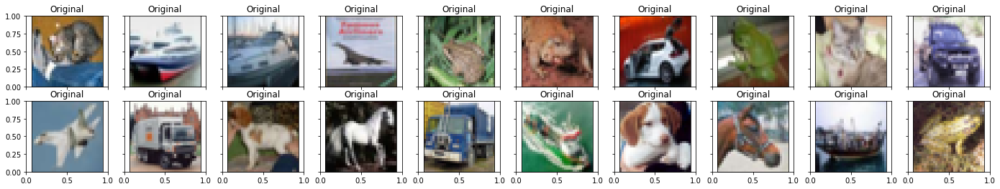

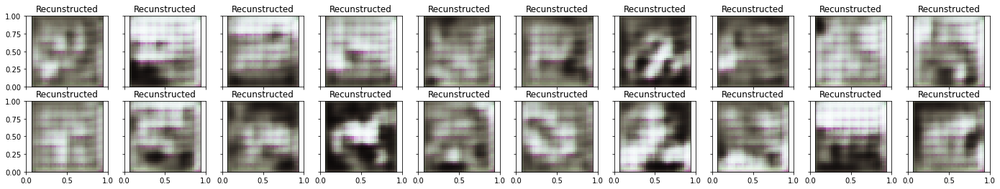

Autoencoder: G_loss: 0.58666
tensor(0.0232, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0236, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0232, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0308, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
D loss is increasing
tensor(0.0229, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0227, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0241, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0134, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
[8/8] D_loss: 0.01344 G_loss: 0.02300
[8/8] G_loss: 0.01207

 EPOCH 68/200 	 train loss 0.5866593718528748 	 val loss 0.5934544801712036


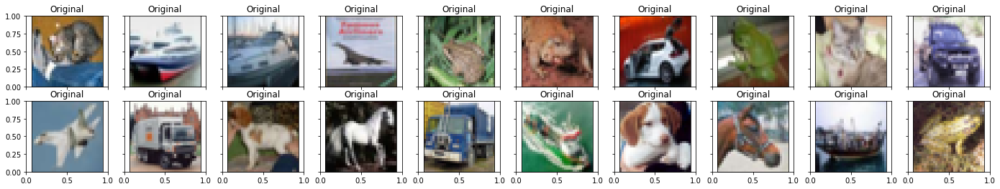

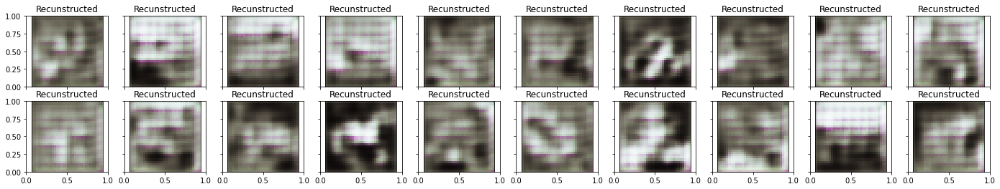

Autoencoder: G_loss: 0.58613
tensor(0.0220, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0219, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0202, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0223, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0229, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0200, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0223, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0196, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
[8/8] D_loss: 0.01956 G_loss: 0.02138
[8/8] G_loss: 0.01314

 EPOCH 69/200 	 train loss 0.5861269235610962 	 val loss 0.5956743359565735


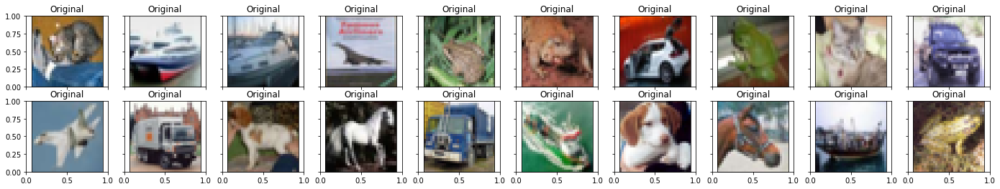

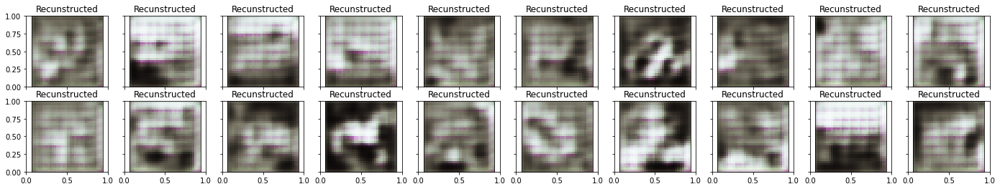

Autoencoder: G_loss: 0.58611
tensor(0.0204, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0208, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0182, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0190, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0282, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0244, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0214, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0211, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
[8/8] D_loss: 0.02114 G_loss: 0.02170
[8/8] G_loss: 0.01181

 EPOCH 70/200 	 train loss 0.5861074328422546 	 val loss 0.5979673266410828


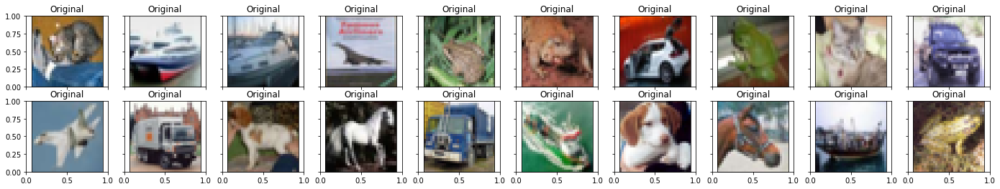

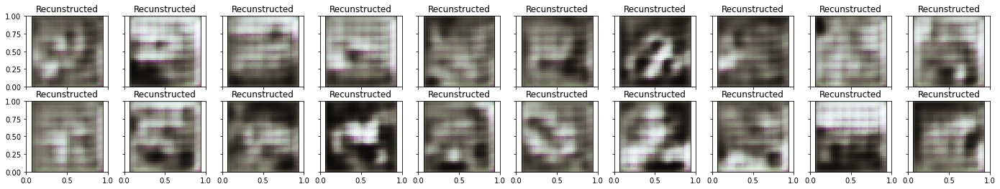

Autoencoder: G_loss: 0.58662
tensor(0.0174, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0256, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0204, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0191, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0201, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0184, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0210, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0154, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
[8/8] D_loss: 0.01540 G_loss: 0.01967
[8/8] G_loss: 0.01426

 EPOCH 71/200 	 train loss 0.586616575717926 	 val loss 0.6066746115684509


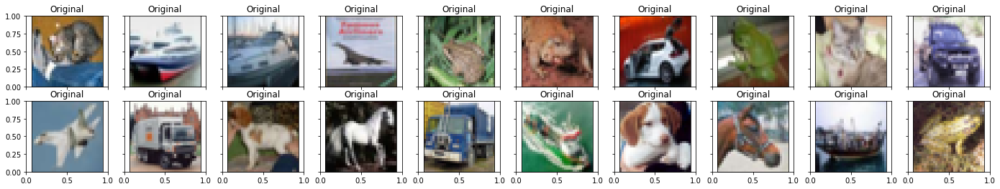

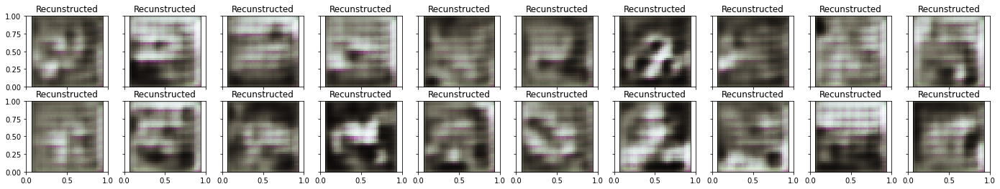

Autoencoder: G_loss: 0.58770
tensor(0.0218, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0161, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0194, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0159, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0176, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0144, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0191, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0210, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
[8/8] D_loss: 0.02096 G_loss: 0.01816
[8/8] G_loss: 0.01951

 EPOCH 72/200 	 train loss 0.58769690990448 	 val loss 0.6175567507743835


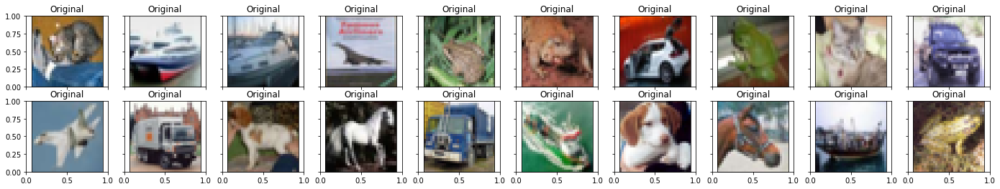

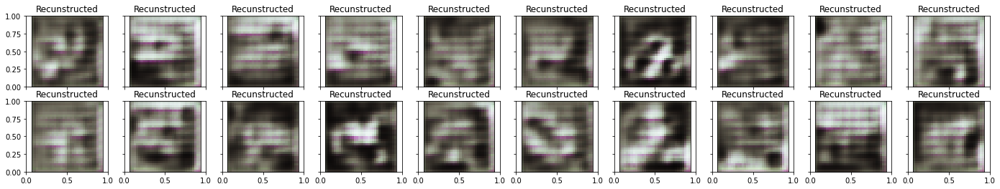

Autoencoder: G_loss: 0.58944
tensor(0.0136, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0118, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0136, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0161, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0109, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0129, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0164, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0144, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
[8/8] D_loss: 0.01437 G_loss: 0.01372
[8/8] G_loss: 0.02118

 EPOCH 73/200 	 train loss 0.5894402861595154 	 val loss 0.6317343711853027


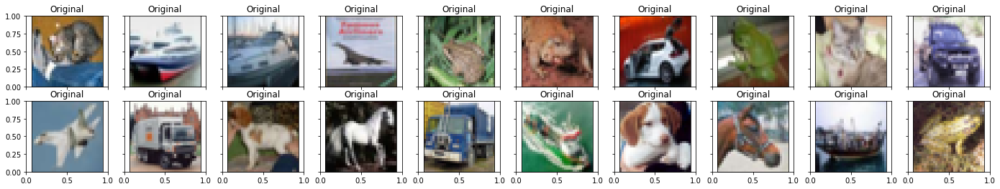

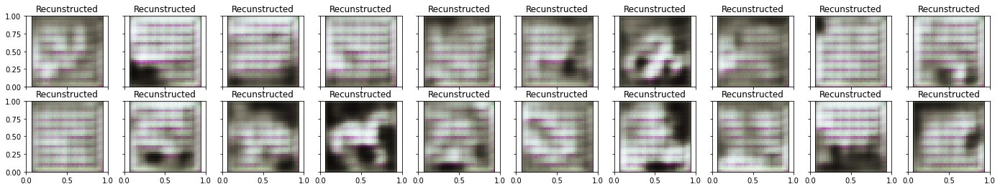

Autoencoder: G_loss: 0.58898
tensor(0.0152, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0152, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0109, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0124, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0129, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0142, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0120, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0127, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
[8/8] D_loss: 0.01274 G_loss: 0.01319
[8/8] G_loss: 0.02169

 EPOCH 74/200 	 train loss 0.5889778137207031 	 val loss 0.613610029220581


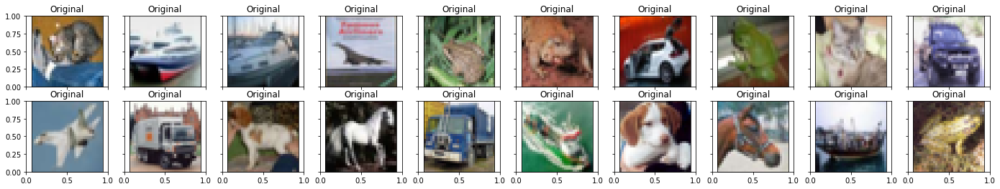

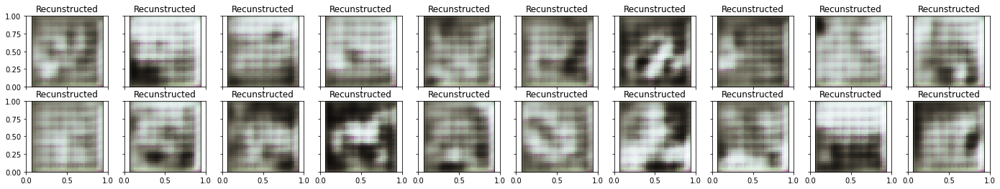

Autoencoder: G_loss: 0.58813
tensor(0.0238, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0228, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0249, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0210, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0204, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0300, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
D loss is increasing
tensor(0.0191, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0264, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
[8/8] D_loss: 0.02644 G_loss: 0.02355
[8/8] G_loss: 0.01410

 EPOCH 75/200 	 train loss 0.5881334543228149 	 val loss 0.5970160365104675


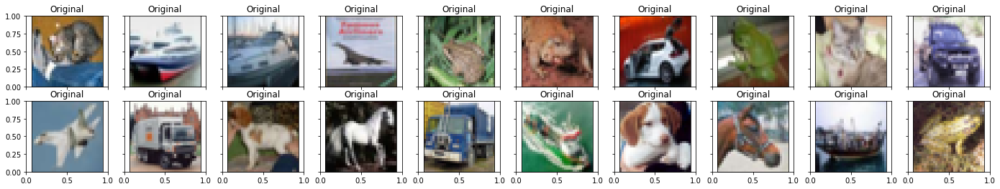

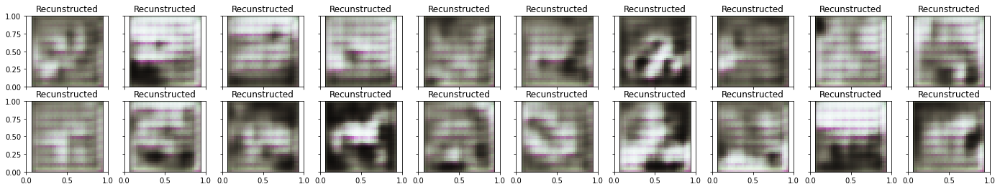

Autoencoder: G_loss: 0.58645
tensor(0.0201, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0218, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0220, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0246, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0280, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0166, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0218, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0261, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
[8/8] D_loss: 0.02612 G_loss: 0.02264
[8/8] G_loss: 0.01167

 EPOCH 76/200 	 train loss 0.586449146270752 	 val loss 0.6068083047866821


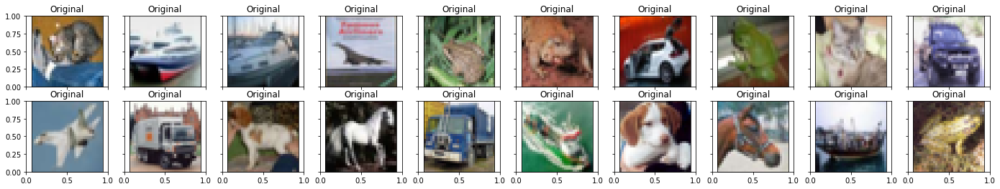

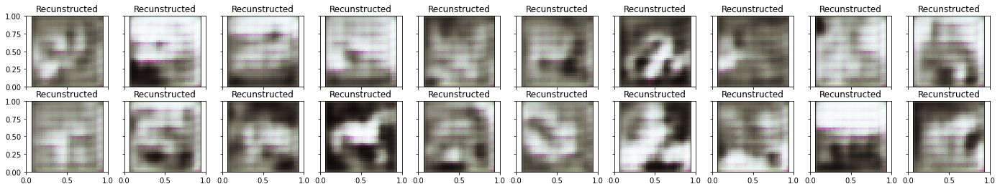

Autoencoder: G_loss: 0.58601
tensor(0.0280, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0193, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0215, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0210, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0197, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0215, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0212, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0205, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
[8/8] D_loss: 0.02054 G_loss: 0.02160
[8/8] G_loss: 0.00734

 EPOCH 77/200 	 train loss 0.5860143899917603 	 val loss 0.6004706025123596


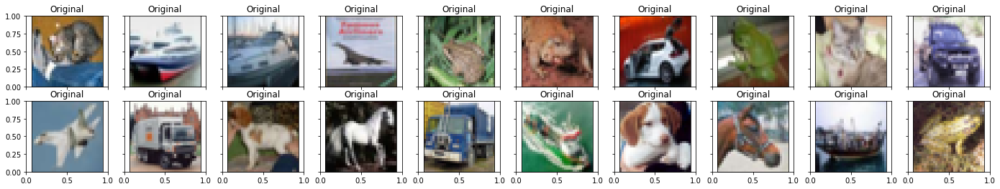

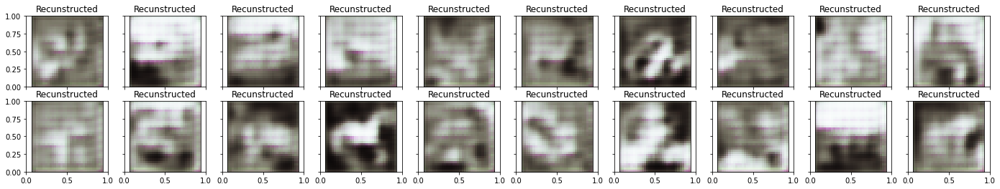

Autoencoder: G_loss: 0.58501
tensor(0.0375, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
D loss is increasing
tensor(0.0215, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0199, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0248, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0208, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0209, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0230, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0202, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
[8/8] D_loss: 0.02021 G_loss: 0.02358
[8/8] G_loss: 0.01340

 EPOCH 78/200 	 train loss 0.5850095748901367 	 val loss 0.6089138388633728


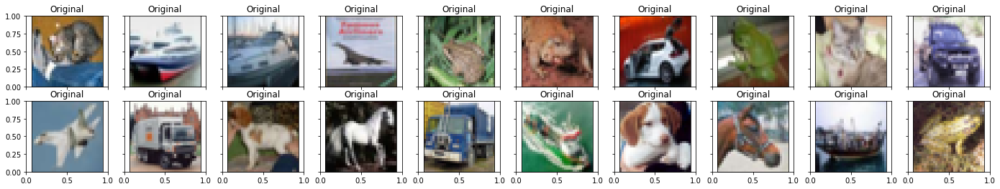

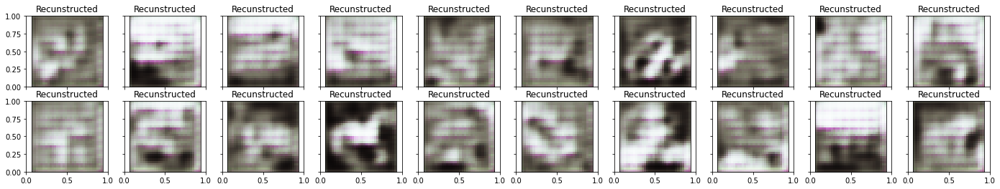

Autoencoder: G_loss: 0.58551
tensor(0.0232, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0196, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0192, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0234, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0183, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0241, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0200, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0314, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
D loss is increasing
[8/8] D_loss: 0.03145 G_loss: 0.02242
[8/8] G_loss: 0.02936

 EPOCH 79/200 	 train loss 0.585512101650238 	 val loss 0.6136533617973328


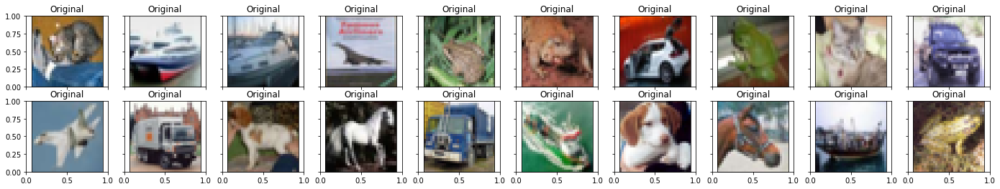

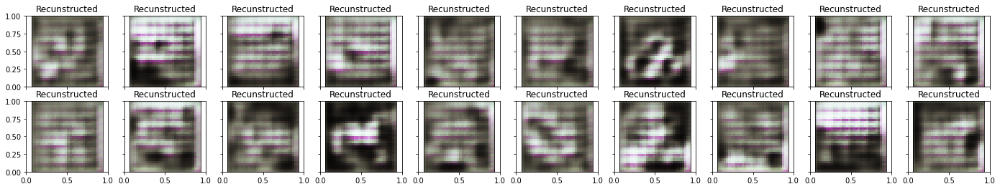

Autoencoder: G_loss: 0.58952
tensor(0.0215, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0189, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0178, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0241, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0234, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0236, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0266, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0177, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
[8/8] D_loss: 0.01773 G_loss: 0.02171
[8/8] G_loss: 0.06750

 EPOCH 80/200 	 train loss 0.589516282081604 	 val loss 0.632403552532196


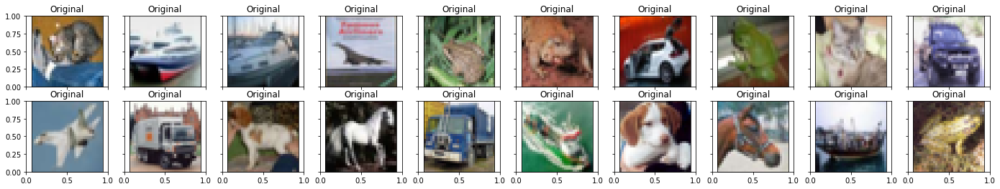

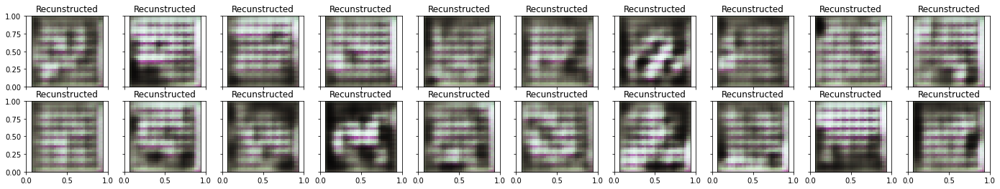

Autoencoder: G_loss: 0.59412
tensor(0.0208, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0183, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0201, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0204, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0183, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0191, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0185, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0121, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
[8/8] D_loss: 0.01205 G_loss: 0.01845
[8/8] G_loss: 0.08126

 EPOCH 81/200 	 train loss 0.5941212773323059 	 val loss 0.677836000919342


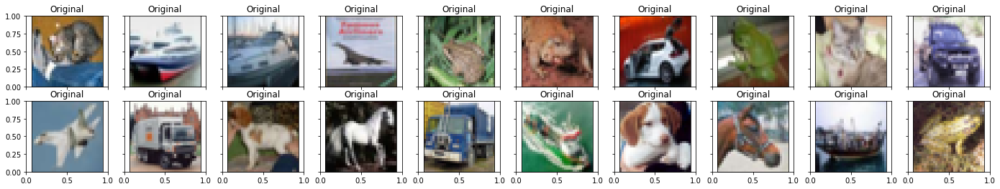

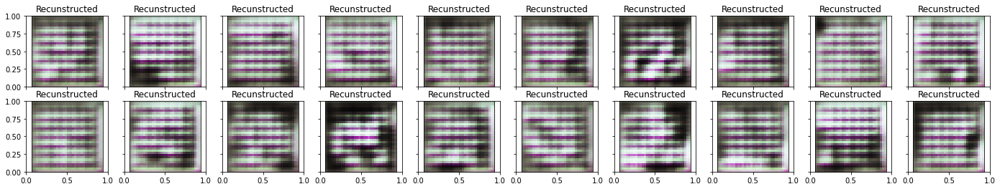

Autoencoder: G_loss: 0.59492
tensor(0.0523, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
D loss is increasing
tensor(0.0374, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
D loss is increasing
tensor(0.0466, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
D loss is increasing
tensor(0.0441, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
D loss is increasing
tensor(0.0342, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
D loss is increasing
tensor(0.0246, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0233, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0174, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
[8/8] D_loss: 0.01740 G_loss: 0.03499
[8/8] G_loss: 0.05022

 EPOCH 82/200 	 train loss 0.594915509223938 	 val loss 0.6623654961585999


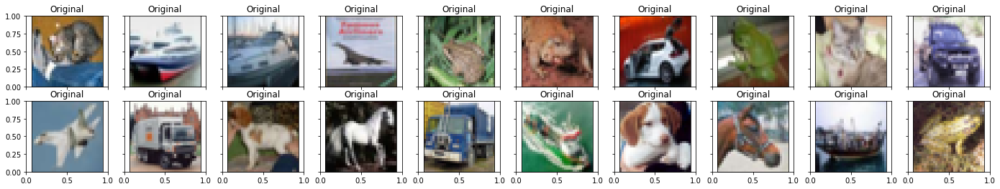

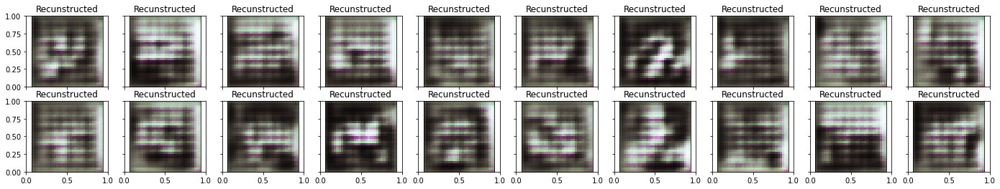

Autoencoder: G_loss: 0.59963
tensor(0.0242, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0180, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0179, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0199, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0193, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0194, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0206, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0181, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
[8/8] D_loss: 0.01809 G_loss: 0.01968
[8/8] G_loss: 0.05145

 EPOCH 83/200 	 train loss 0.5996338129043579 	 val loss 0.7082712650299072


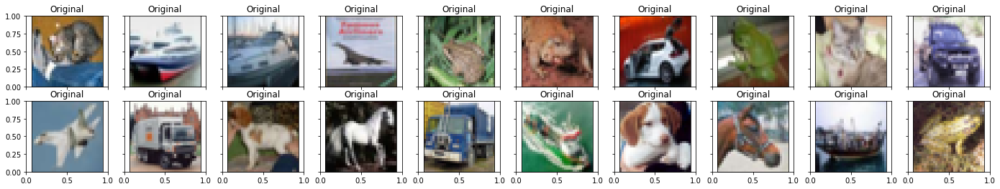

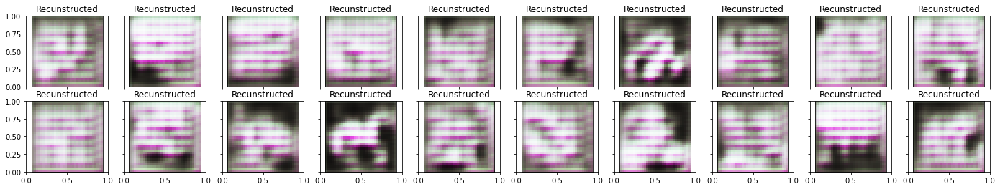

Autoencoder: G_loss: 0.59568
tensor(0.0922, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
D loss is increasing
tensor(0.1508, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
D loss is increasing
tensor(0.0660, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
D loss is increasing
tensor(0.0443, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
D loss is increasing
tensor(0.0548, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
D loss is increasing
tensor(0.0389, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
D loss is increasing
tensor(0.0419, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
D loss is increasing
tensor(0.0535, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
D loss is increasing
[8/8] D_loss: 0.05349 G_loss: 0.06780
[8/8] G_loss: 0.24069

 EPOCH 84/200 	 train loss 0.5956836938858032 	 val loss 0.7672929167747498


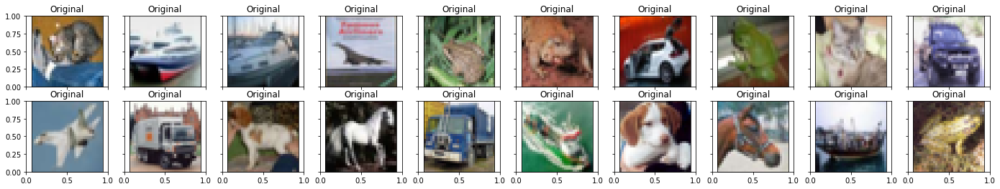

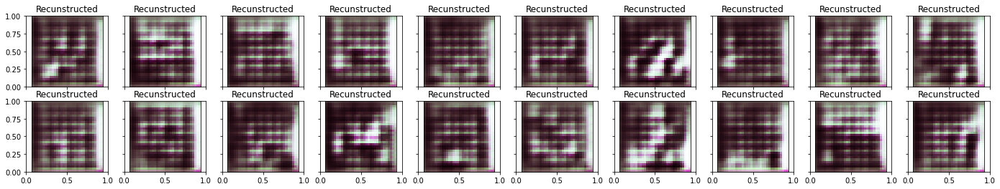

Autoencoder: G_loss: 0.60762
tensor(0.0677, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
D loss is increasing
tensor(0.0500, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
D loss is increasing
tensor(0.0350, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
D loss is increasing
tensor(0.0338, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
D loss is increasing
tensor(0.0364, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
D loss is increasing
tensor(0.0339, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
D loss is increasing
tensor(0.0318, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
D loss is increasing
tensor(0.0241, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
[8/8] D_loss: 0.02408 G_loss: 0.03908
[8/8] G_loss: 0.08115

 EPOCH 85/200 	 train loss 0.6076229810714722 	 val loss 0.6347535252571106


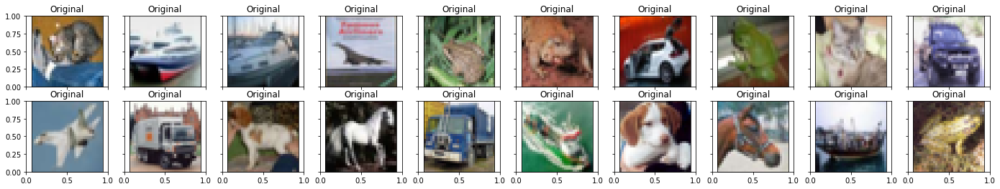

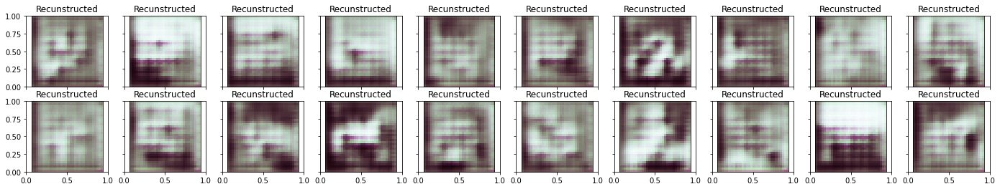

Autoencoder: G_loss: 0.59949
tensor(0.0943, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
D loss is increasing
tensor(0.0380, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
D loss is increasing
tensor(0.0279, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0360, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
D loss is increasing
tensor(0.0347, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
D loss is increasing
tensor(0.0315, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
D loss is increasing
tensor(0.0393, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
D loss is increasing
tensor(0.0279, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
[8/8] D_loss: 0.02787 G_loss: 0.04120
[8/8] G_loss: 0.12646

 EPOCH 86/200 	 train loss 0.5994948148727417 	 val loss 0.7514093518257141


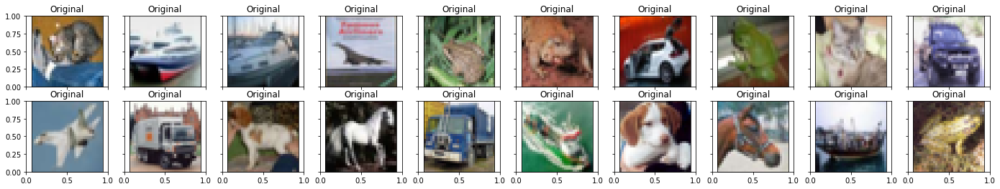

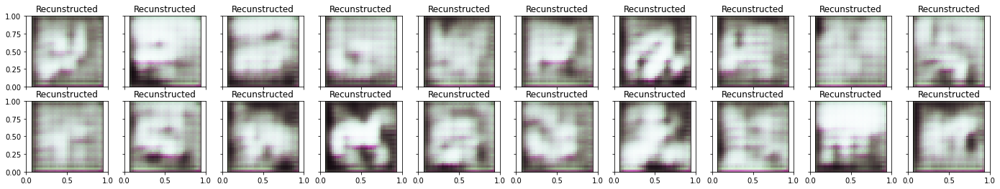

Autoencoder: G_loss: 0.61017
tensor(0.0291, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0317, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
D loss is increasing
tensor(0.0205, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0246, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0216, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0255, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0249, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0258, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
[8/8] D_loss: 0.02580 G_loss: 0.02546
[8/8] G_loss: 0.41020

 EPOCH 87/200 	 train loss 0.6101670265197754 	 val loss 0.7865573167800903


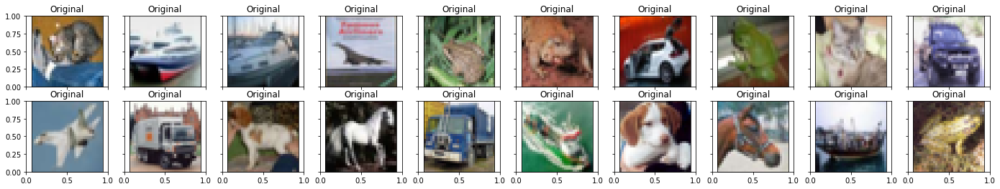

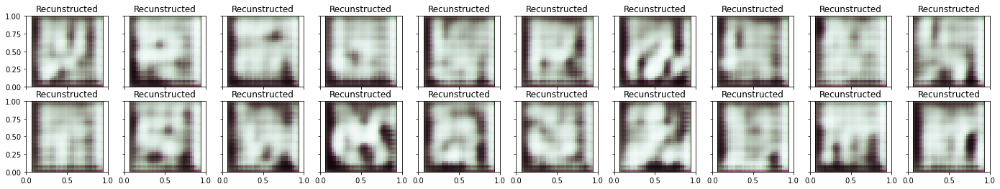

Autoencoder: G_loss: 0.60866
tensor(0.0238, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0261, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0200, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0246, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0209, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0222, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0220, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0207, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
[8/8] D_loss: 0.02072 G_loss: 0.02254
[8/8] G_loss: 0.14658

 EPOCH 88/200 	 train loss 0.6086611747741699 	 val loss 0.6516303420066833


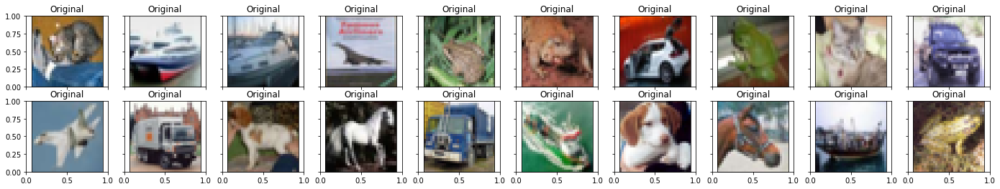

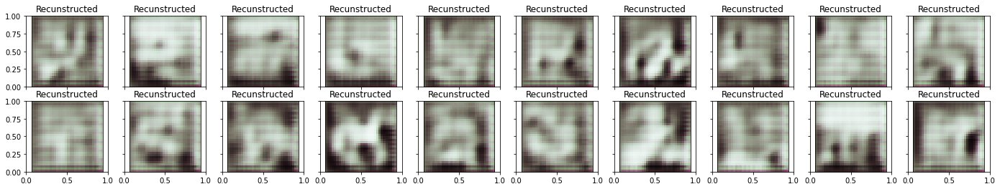

Autoencoder: G_loss: 0.59939
tensor(0.0205, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0249, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0200, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0224, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0245, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0256, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0212, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0159, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
[8/8] D_loss: 0.01594 G_loss: 0.02186
[8/8] G_loss: 0.10671

 EPOCH 89/200 	 train loss 0.5993888974189758 	 val loss 0.6559745669364929


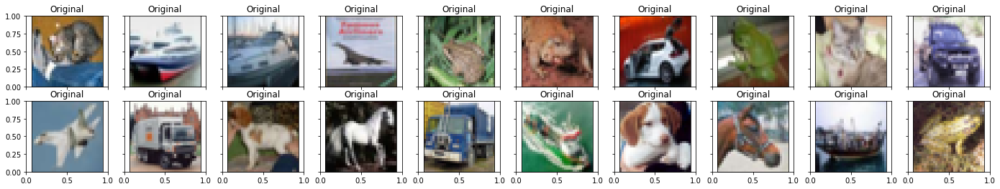

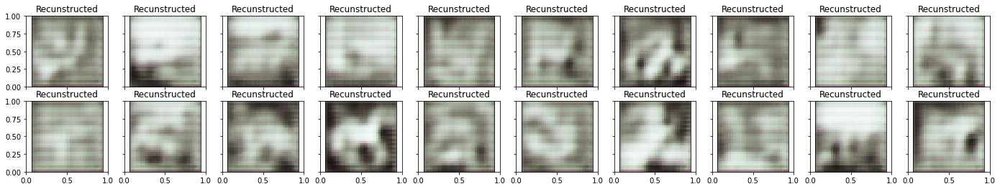

Autoencoder: G_loss: 0.59677
tensor(0.0308, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
D loss is increasing
tensor(0.0296, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0329, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
D loss is increasing
tensor(0.0361, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
D loss is increasing
tensor(0.0243, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0272, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0285, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0272, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
[8/8] D_loss: 0.02724 G_loss: 0.02958
[8/8] G_loss: 0.10719

 EPOCH 90/200 	 train loss 0.5967665910720825 	 val loss 0.6262643933296204


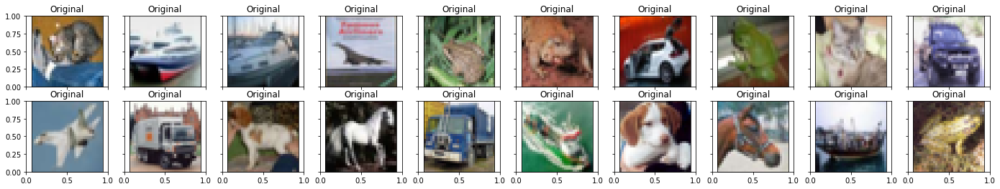

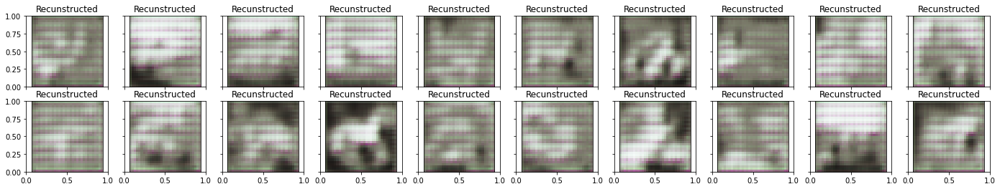

Autoencoder: G_loss: 0.59505
tensor(0.0295, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0270, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0280, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0282, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0303, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
D loss is increasing
tensor(0.0231, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0259, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0227, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
[8/8] D_loss: 0.02273 G_loss: 0.02684
[8/8] G_loss: 0.06562

 EPOCH 91/200 	 train loss 0.5950483083724976 	 val loss 0.6086545586585999


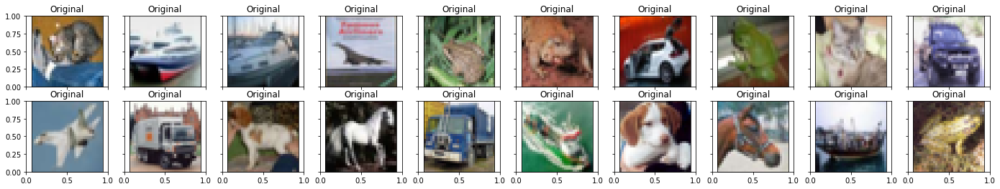

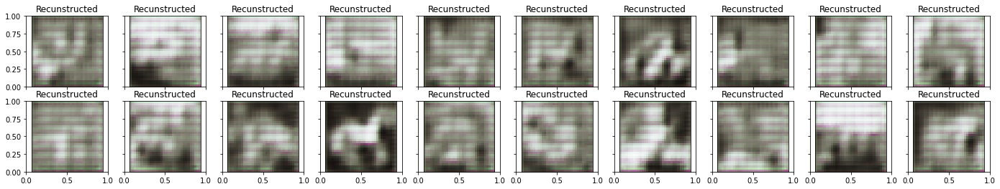

Autoencoder: G_loss: 0.59272
tensor(0.0297, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0297, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0285, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0295, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0281, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0281, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0281, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0299, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
[8/8] D_loss: 0.02986 G_loss: 0.02893
[8/8] G_loss: 0.04357

 EPOCH 92/200 	 train loss 0.5927190780639648 	 val loss 0.6020677089691162


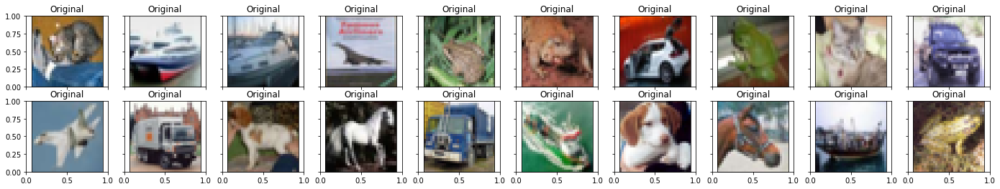

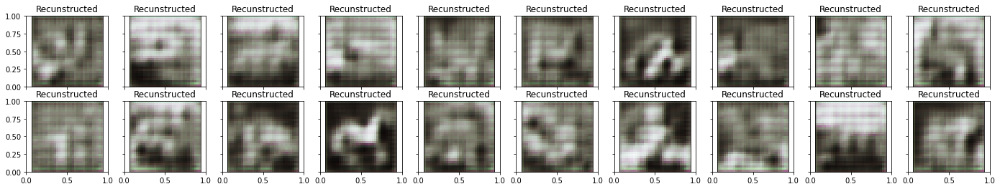

Autoencoder: G_loss: 0.59073
tensor(0.0287, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0296, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0286, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0290, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0272, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0280, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0279, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0331, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
D loss is increasing
[8/8] D_loss: 0.03307 G_loss: 0.02902
[8/8] G_loss: 0.05482

 EPOCH 93/200 	 train loss 0.590730607509613 	 val loss 0.6481468677520752


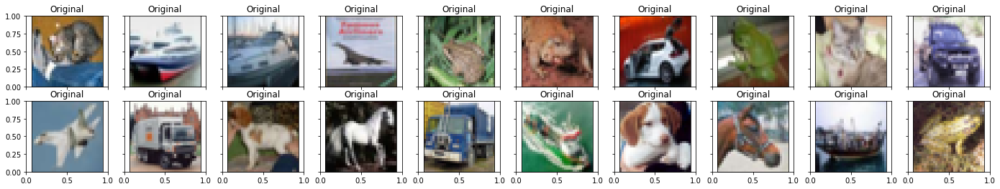

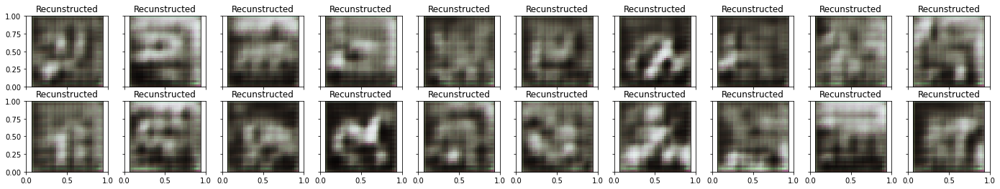

Autoencoder: G_loss: 0.59249
tensor(0.0309, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
D loss is increasing
tensor(0.0218, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0181, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0210, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0228, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0203, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0201, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0246, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
[8/8] D_loss: 0.02463 G_loss: 0.02245
[8/8] G_loss: 0.05809

 EPOCH 94/200 	 train loss 0.5924919247627258 	 val loss 0.6526808142662048


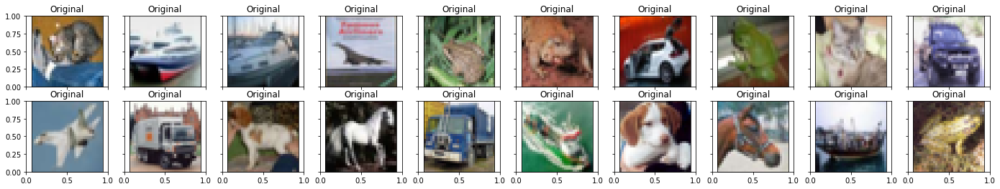

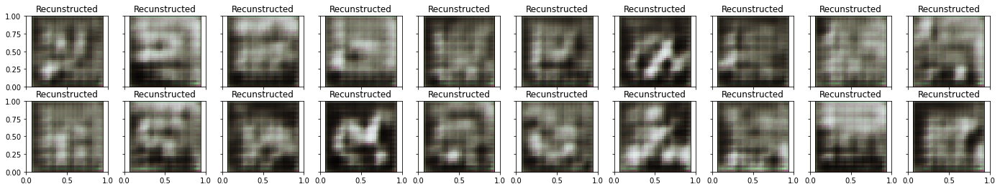

Autoencoder: G_loss: 0.59044
tensor(0.0295, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0226, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0275, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0237, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0247, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0232, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0219, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0284, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
[8/8] D_loss: 0.02837 G_loss: 0.02518
[8/8] G_loss: 0.04022

 EPOCH 95/200 	 train loss 0.5904397964477539 	 val loss 0.6438930630683899


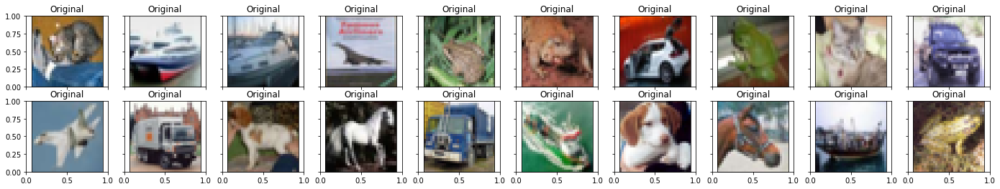

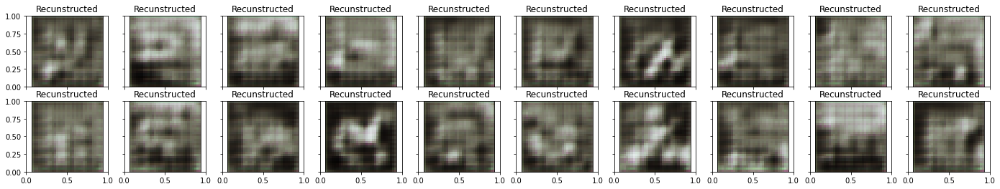

Autoencoder: G_loss: 0.58998
tensor(0.0261, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0278, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0237, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0310, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
D loss is increasing
tensor(0.0236, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0219, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0201, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0238, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
[8/8] D_loss: 0.02381 G_loss: 0.02476
[8/8] G_loss: 0.02919

 EPOCH 96/200 	 train loss 0.5899845957756042 	 val loss 0.7170602679252625


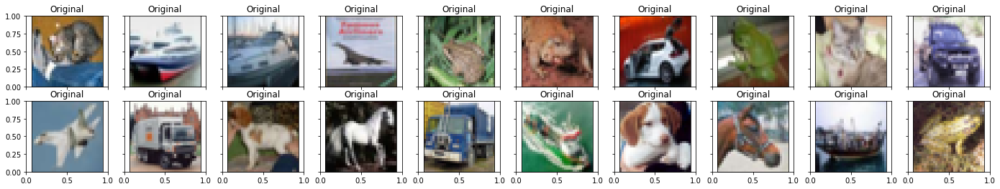

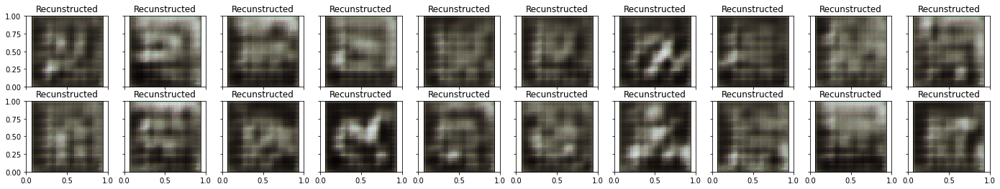

Autoencoder: G_loss: 0.59114
tensor(0.0221, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0227, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0194, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0201, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0210, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0207, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0203, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0143, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
[8/8] D_loss: 0.01434 G_loss: 0.02007
[8/8] G_loss: 0.03088

 EPOCH 97/200 	 train loss 0.5911370515823364 	 val loss 0.6637157797813416


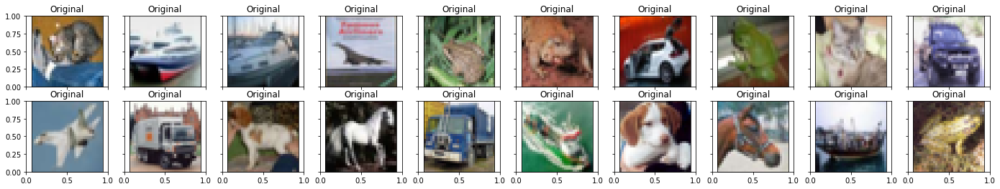

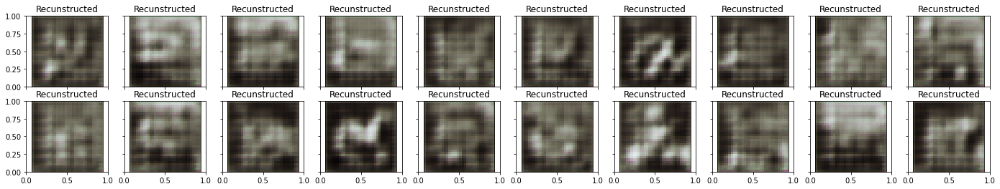

Autoencoder: G_loss: 0.58960
tensor(0.0251, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0255, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0252, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0270, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0264, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0259, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0236, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0232, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
[8/8] D_loss: 0.02323 G_loss: 0.02525
[8/8] G_loss: 0.02066

 EPOCH 98/200 	 train loss 0.5895998477935791 	 val loss 0.650780200958252


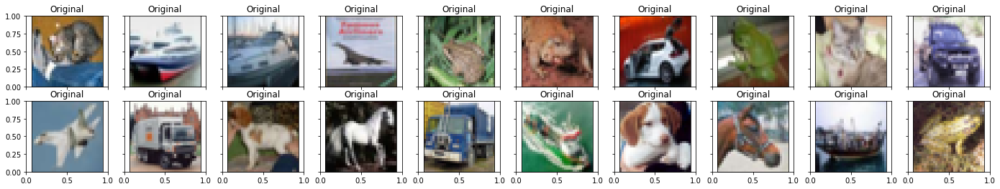

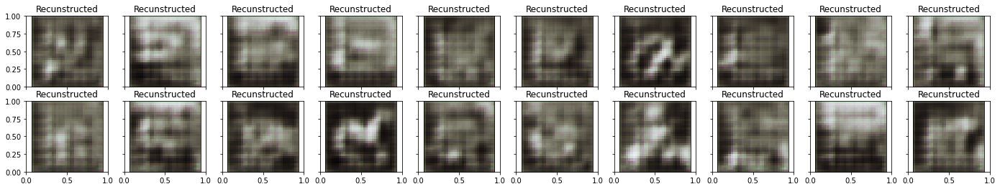

Autoencoder: G_loss: 0.58901
tensor(0.0270, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0284, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0305, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
D loss is increasing
tensor(0.0199, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0240, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0238, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0229, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0214, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
[8/8] D_loss: 0.02143 G_loss: 0.02474
[8/8] G_loss: 0.01913

 EPOCH 99/200 	 train loss 0.589005708694458 	 val loss 0.650579035282135


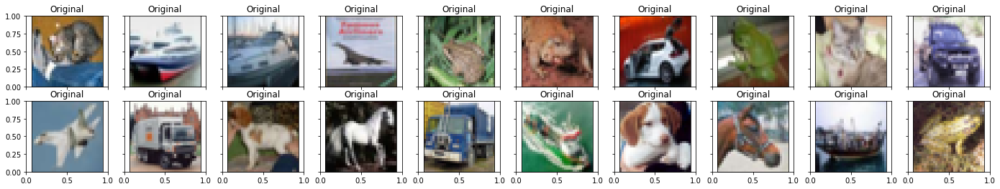

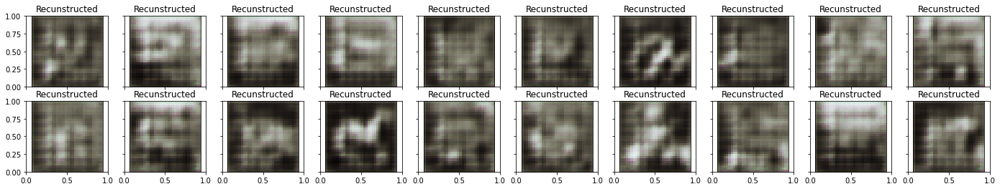

Autoencoder: G_loss: 0.58839
tensor(0.0215, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0217, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0230, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0213, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0226, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0242, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0228, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0232, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
[8/8] D_loss: 0.02324 G_loss: 0.02253
[8/8] G_loss: 0.02079

 EPOCH 100/200 	 train loss 0.5883946418762207 	 val loss 0.627917468547821


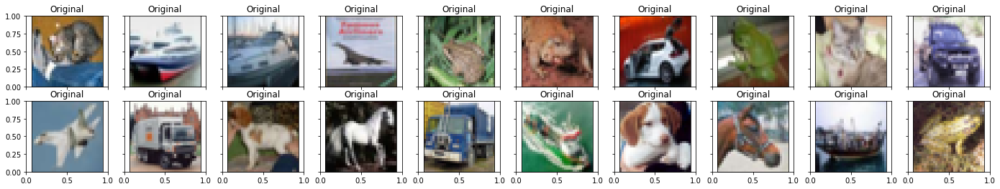

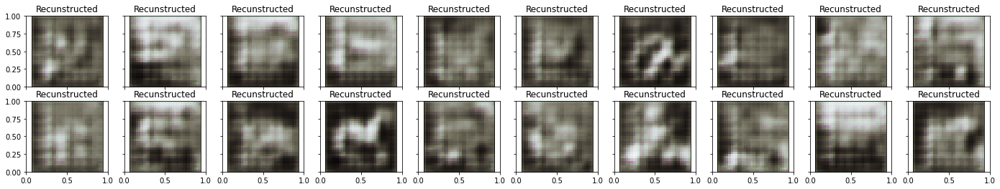

Autoencoder: G_loss: 0.58802
tensor(0.0221, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0245, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0228, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0262, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0246, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0221, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0246, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0341, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
D loss is increasing
[8/8] D_loss: 0.03414 G_loss: 0.02512
[8/8] G_loss: 0.01818

 EPOCH 101/200 	 train loss 0.5880237817764282 	 val loss 0.6396535038948059


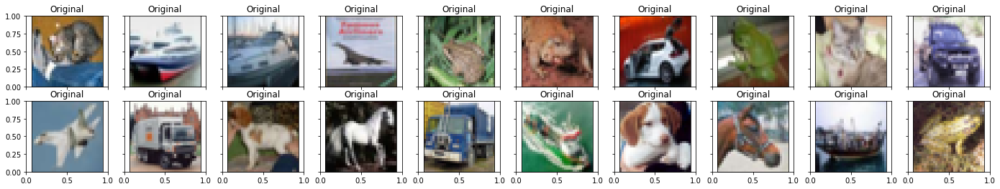

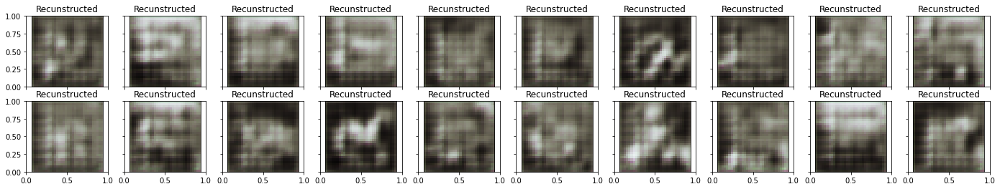

Autoencoder: G_loss: 0.58880
tensor(0.0237, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0239, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0260, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0219, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0251, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0206, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0238, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0270, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
[8/8] D_loss: 0.02697 G_loss: 0.02398
[8/8] G_loss: 0.01807

 EPOCH 102/200 	 train loss 0.5888031125068665 	 val loss 0.6010869145393372


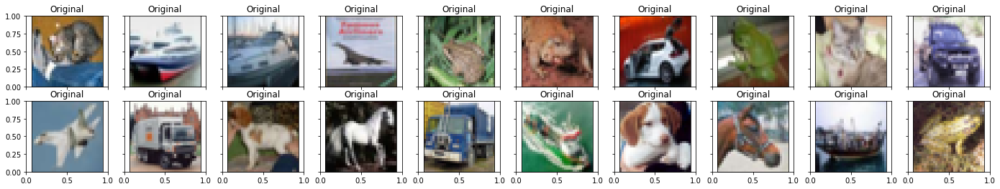

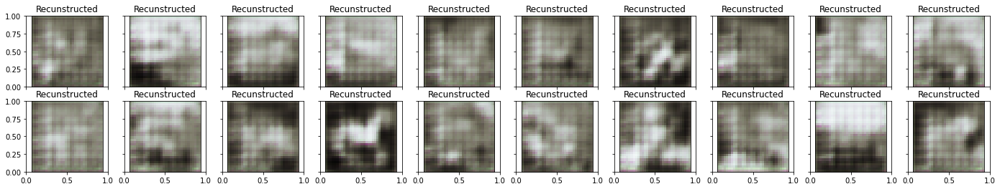

Autoencoder: G_loss: 0.58726
tensor(0.0227, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0187, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0213, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0196, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0197, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0204, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0253, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0225, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
[8/8] D_loss: 0.02255 G_loss: 0.02129
[8/8] G_loss: 0.01336

 EPOCH 103/200 	 train loss 0.587263822555542 	 val loss 0.6117619872093201


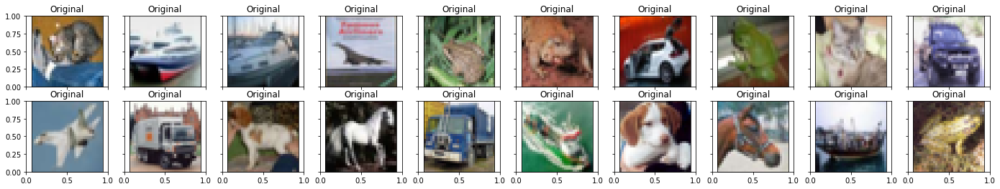

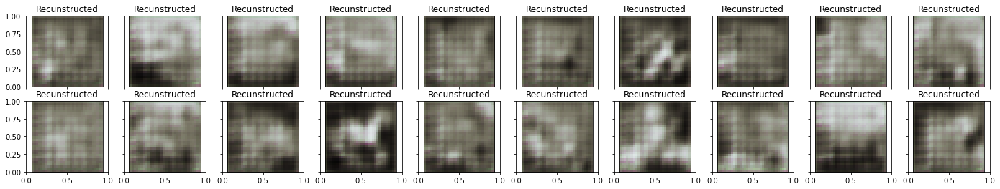

Autoencoder: G_loss: 0.58674
tensor(0.0229, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0215, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0192, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0193, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0179, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0221, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0246, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0113, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
[8/8] D_loss: 0.01132 G_loss: 0.01987
[8/8] G_loss: 0.01914

 EPOCH 104/200 	 train loss 0.5867365598678589 	 val loss 0.6462585926055908


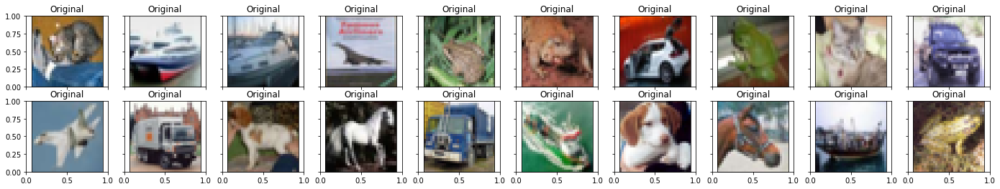

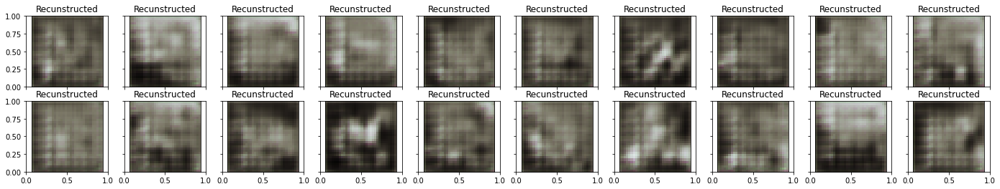

Autoencoder: G_loss: 0.58908
tensor(0.0223, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0197, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0218, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0207, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0234, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0209, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0185, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0315, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
D loss is increasing
[8/8] D_loss: 0.03146 G_loss: 0.02234
[8/8] G_loss: 0.02266

 EPOCH 105/200 	 train loss 0.5890810489654541 	 val loss 0.6372142434120178


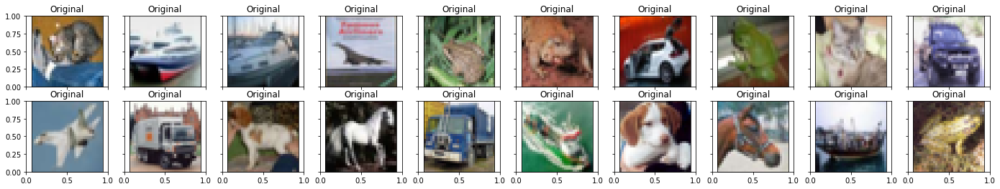

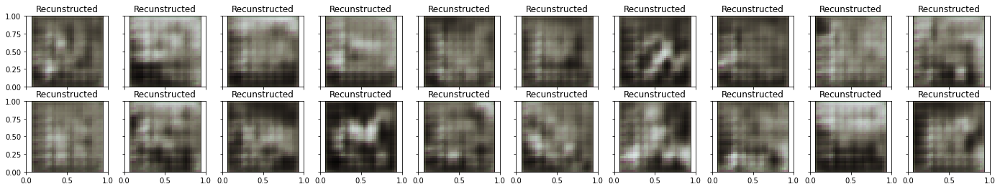

Autoencoder: G_loss: 0.58844
tensor(0.0213, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0216, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0225, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0230, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0212, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0244, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0238, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0326, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
D loss is increasing
[8/8] D_loss: 0.03255 G_loss: 0.02379
[8/8] G_loss: 0.01839

 EPOCH 106/200 	 train loss 0.5884442329406738 	 val loss 0.6122257709503174


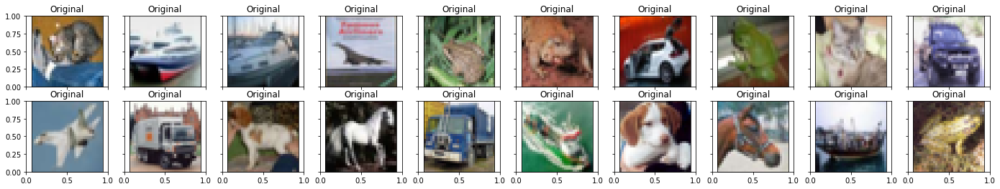

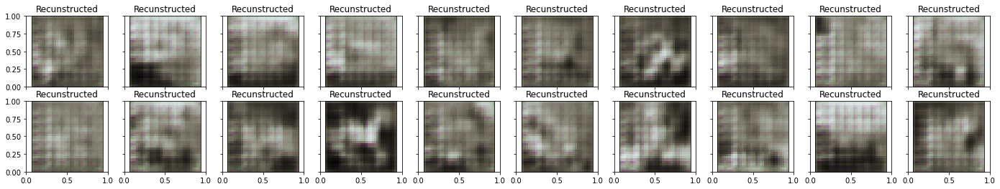

Autoencoder: G_loss: 0.58774
tensor(0.0162, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0168, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0162, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0149, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0165, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0148, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0162, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0147, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
[8/8] D_loss: 0.01468 G_loss: 0.01578
[8/8] G_loss: 0.02366

 EPOCH 107/200 	 train loss 0.5877357125282288 	 val loss 0.6196535229682922


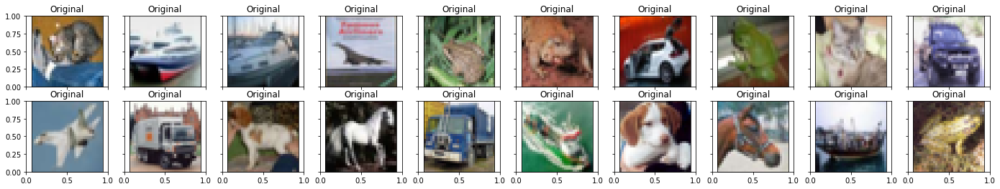

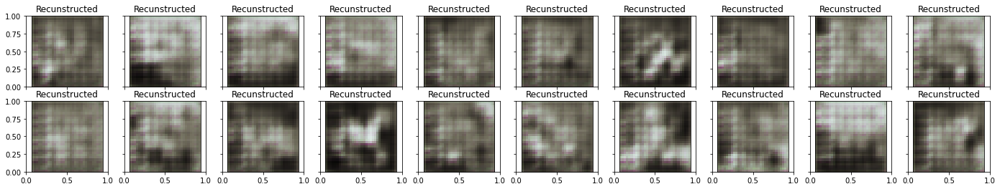

Autoencoder: G_loss: 0.58772
tensor(0.0162, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0135, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0146, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0186, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0164, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0166, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0179, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0153, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
[8/8] D_loss: 0.01531 G_loss: 0.01616
[8/8] G_loss: 0.01848

 EPOCH 108/200 	 train loss 0.5877217054367065 	 val loss 0.6414859294891357


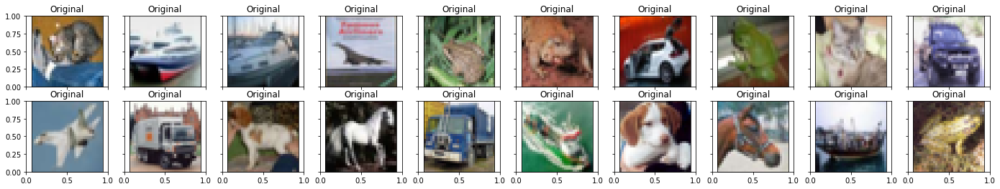

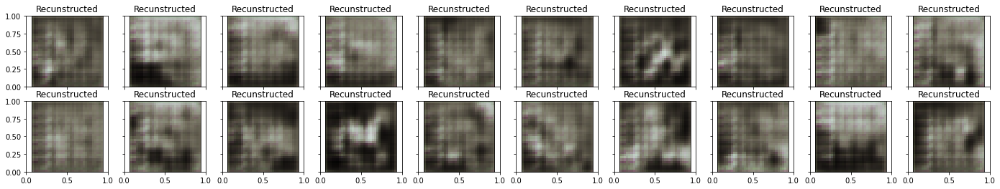

Autoencoder: G_loss: 0.58660
tensor(0.0189, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0216, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0174, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0178, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0201, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0189, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0177, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0149, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
[8/8] D_loss: 0.01487 G_loss: 0.01840
[8/8] G_loss: 0.01542

 EPOCH 109/200 	 train loss 0.5865972638130188 	 val loss 0.6104729175567627


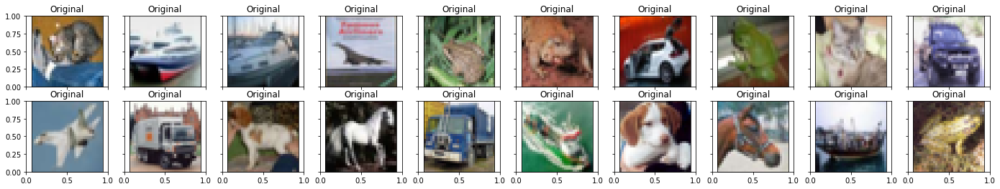

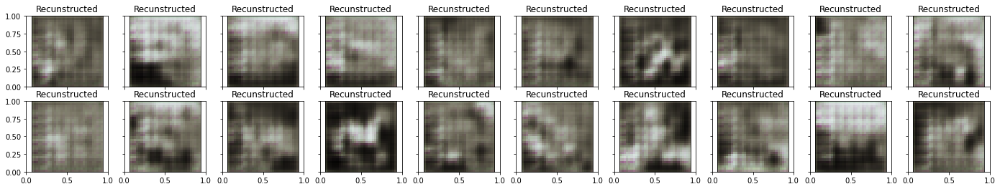

Autoencoder: G_loss: 0.58592
tensor(0.0197, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0191, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0176, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0176, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0192, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0178, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0189, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0211, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
[8/8] D_loss: 0.02110 G_loss: 0.01889
[8/8] G_loss: 0.01275

 EPOCH 110/200 	 train loss 0.5859174132347107 	 val loss 0.6031012535095215


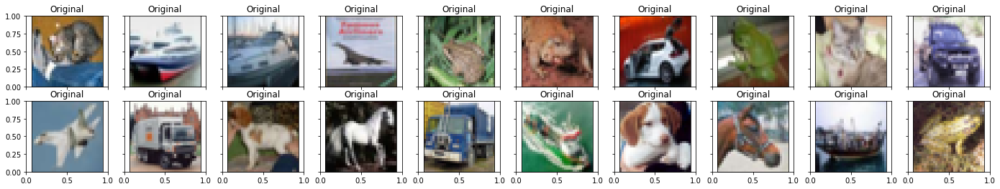

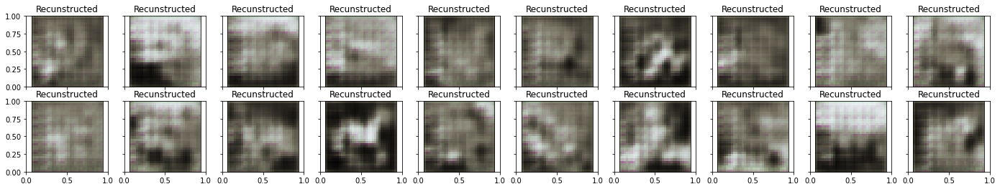

Autoencoder: G_loss: 0.58577
tensor(0.0182, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0175, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0198, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0168, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0155, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0206, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0190, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0138, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
[8/8] D_loss: 0.01380 G_loss: 0.01765
[8/8] G_loss: 0.01301

 EPOCH 111/200 	 train loss 0.5857744812965393 	 val loss 0.6122310161590576


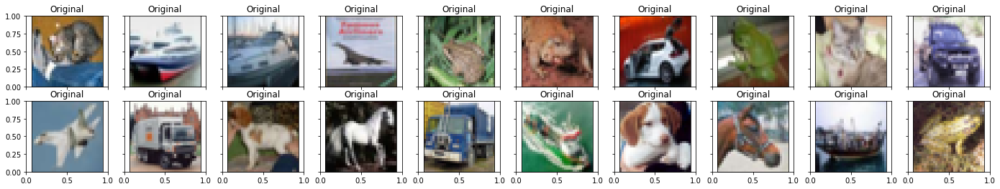

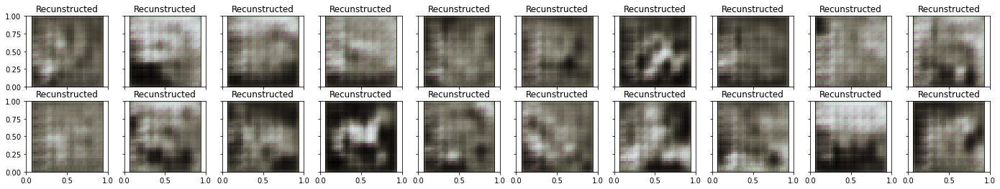

Autoencoder: G_loss: 0.58543
tensor(0.0180, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0151, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0191, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0193, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0188, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0184, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0206, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0179, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
[8/8] D_loss: 0.01792 G_loss: 0.01840
[8/8] G_loss: 0.01364

 EPOCH 112/200 	 train loss 0.5854302644729614 	 val loss 0.6104777455329895


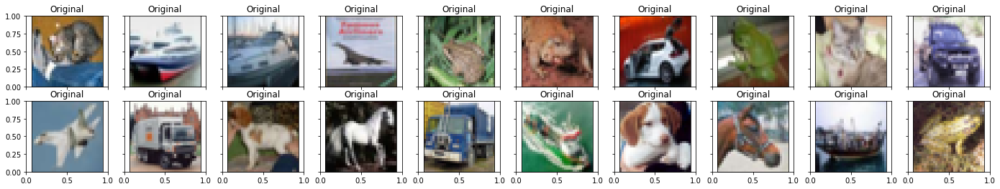

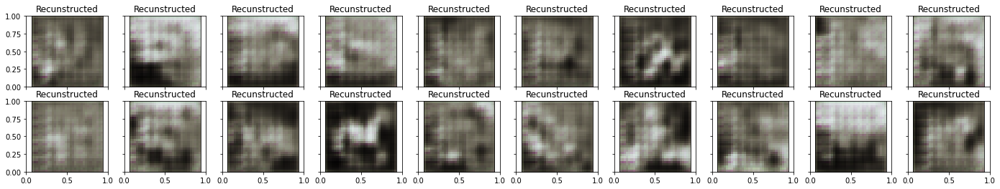

Autoencoder: G_loss: 0.58472
tensor(0.0193, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0201, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0171, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0169, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0149, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0190, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0163, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0196, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
[8/8] D_loss: 0.01956 G_loss: 0.01789
[8/8] G_loss: 0.01359

 EPOCH 113/200 	 train loss 0.584723949432373 	 val loss 0.612087070941925


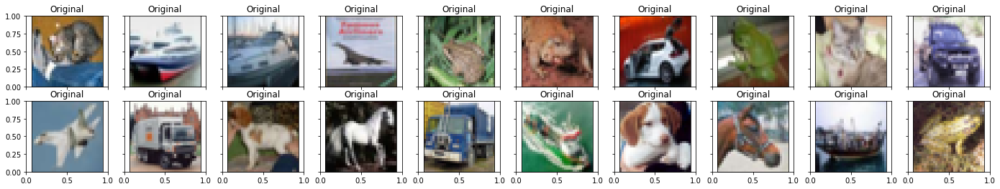

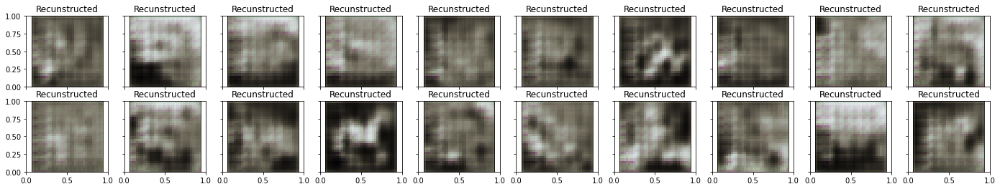

Autoencoder: G_loss: 0.58560
tensor(0.0165, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0176, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0200, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0174, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0171, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0186, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0181, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0177, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
[8/8] D_loss: 0.01769 G_loss: 0.01786
[8/8] G_loss: 0.01411

 EPOCH 114/200 	 train loss 0.5855991840362549 	 val loss 0.6000104546546936


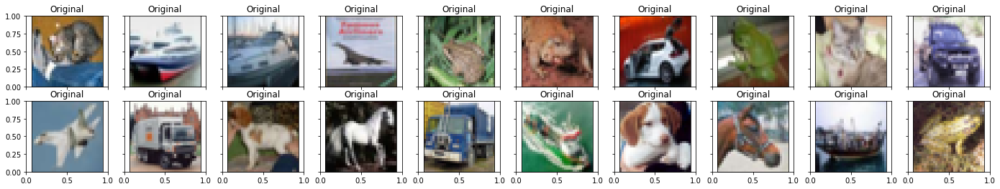

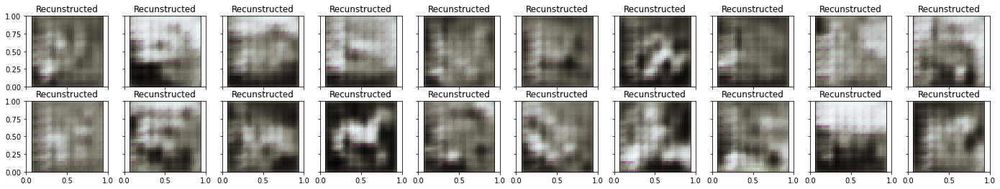

Autoencoder: G_loss: 0.58552
tensor(0.0197, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0195, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0199, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0177, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0152, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0202, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0183, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0234, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
[8/8] D_loss: 0.02341 G_loss: 0.01923
[8/8] G_loss: 0.01286

 EPOCH 115/200 	 train loss 0.5855154395103455 	 val loss 0.5963946580886841


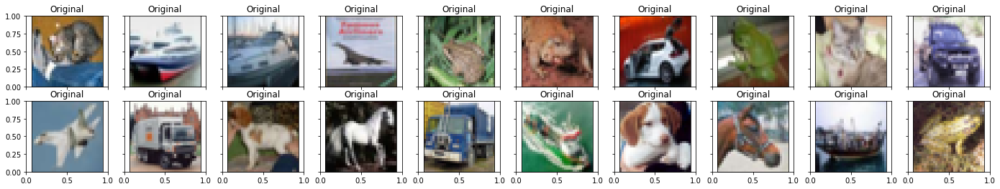

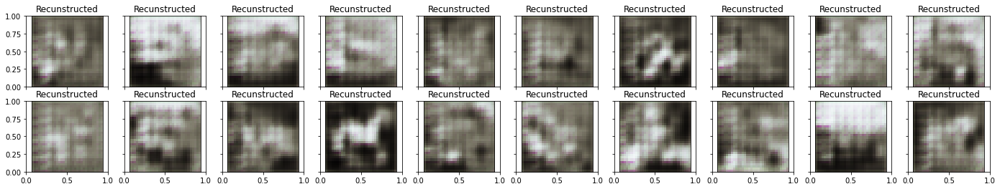

Autoencoder: G_loss: 0.58517
tensor(0.0171, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0211, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0190, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0157, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0207, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0172, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0169, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0274, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
[8/8] D_loss: 0.02739 G_loss: 0.01940
[8/8] G_loss: 0.01168

 EPOCH 116/200 	 train loss 0.585172712802887 	 val loss 0.5932093858718872


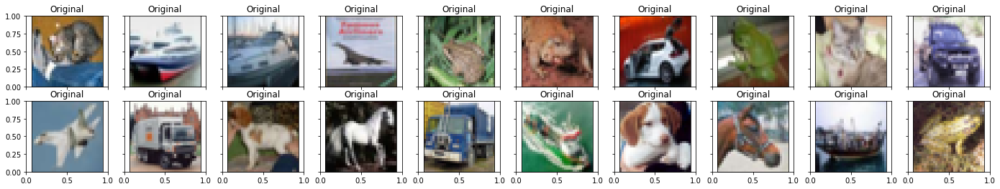

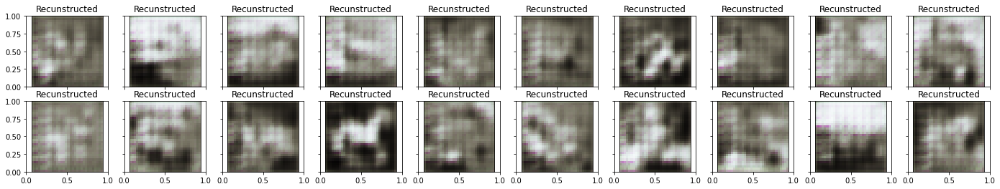

Autoencoder: G_loss: 0.58541
tensor(0.0169, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0190, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0221, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0222, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0189, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0187, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0176, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0141, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
[8/8] D_loss: 0.01412 G_loss: 0.01870
[8/8] G_loss: 0.01066

 EPOCH 117/200 	 train loss 0.5854084491729736 	 val loss 0.5994490385055542


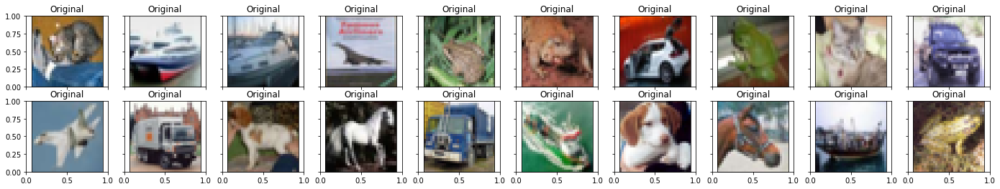

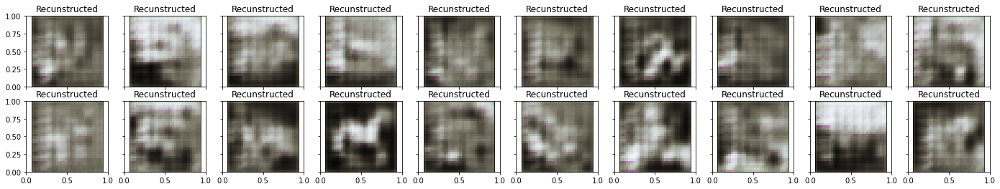

Autoencoder: G_loss: 0.58446
tensor(0.0180, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0229, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0212, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0230, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0221, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0180, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0207, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0231, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
[8/8] D_loss: 0.02312 G_loss: 0.02112
[8/8] G_loss: 0.01017

 EPOCH 118/200 	 train loss 0.5844584703445435 	 val loss 0.5959796905517578


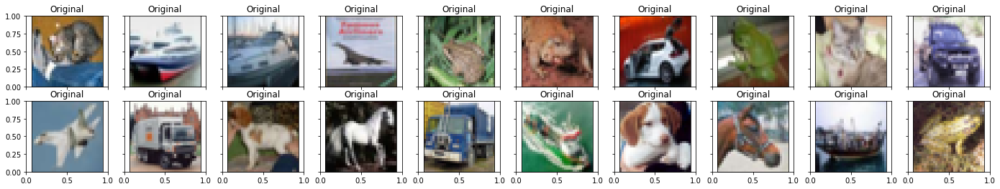

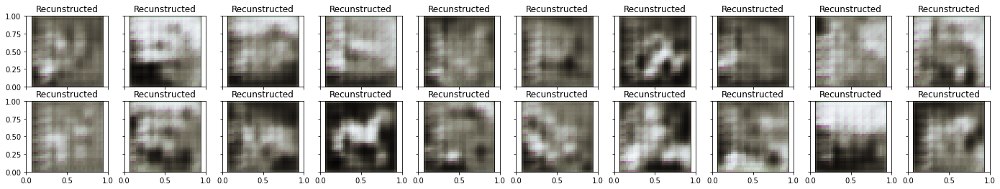

Autoencoder: G_loss: 0.58420
tensor(0.0227, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0198, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0277, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0235, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0223, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0249, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0250, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0252, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
[8/8] D_loss: 0.02522 G_loss: 0.02389
[8/8] G_loss: 0.00970

 EPOCH 119/200 	 train loss 0.5841989517211914 	 val loss 0.5933273434638977


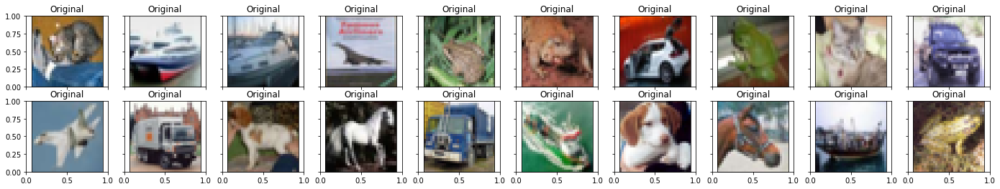

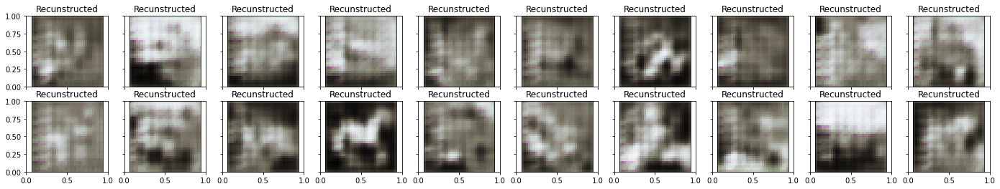

Autoencoder: G_loss: 0.58451
tensor(0.0221, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0227, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0192, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0219, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0217, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0216, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0231, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0191, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
[8/8] D_loss: 0.01911 G_loss: 0.02142
[8/8] G_loss: 0.00950

 EPOCH 120/200 	 train loss 0.5845139026641846 	 val loss 0.597801923751831


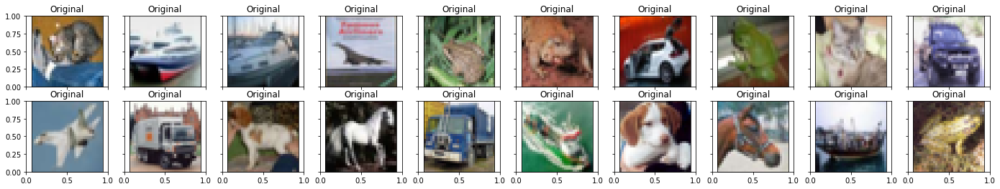

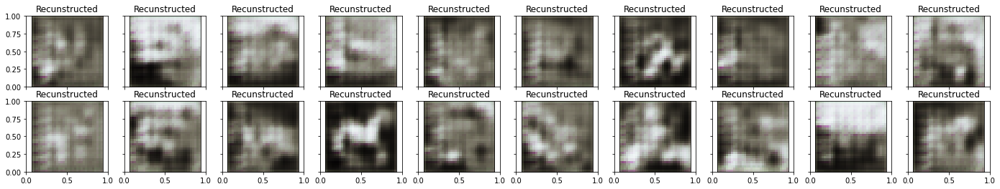

Autoencoder: G_loss: 0.58454
tensor(0.0240, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0194, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0227, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0225, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0213, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0220, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0247, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0192, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
[8/8] D_loss: 0.01919 G_loss: 0.02197
[8/8] G_loss: 0.00976

 EPOCH 121/200 	 train loss 0.5845370292663574 	 val loss 0.5938844680786133


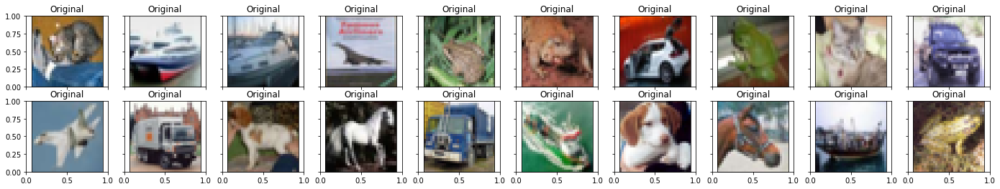

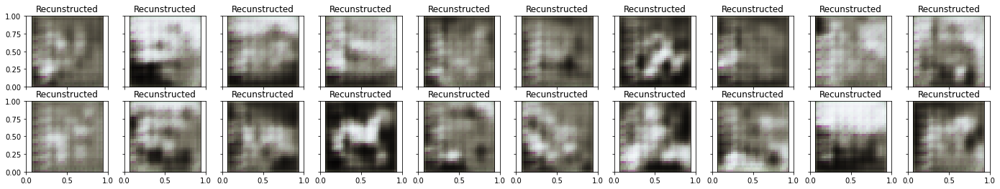

Autoencoder: G_loss: 0.58401
tensor(0.0190, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0204, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0206, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0212, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0202, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0203, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0205, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0173, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
[8/8] D_loss: 0.01727 G_loss: 0.01993
[8/8] G_loss: 0.01036

 EPOCH 122/200 	 train loss 0.5840094089508057 	 val loss 0.5963210463523865


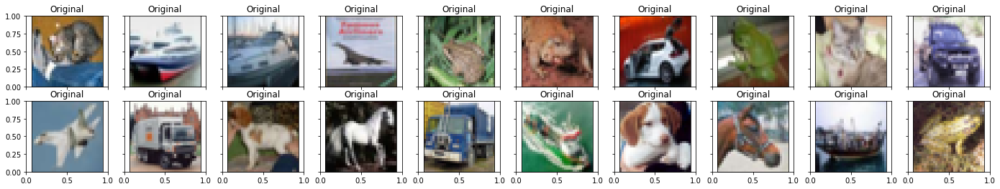

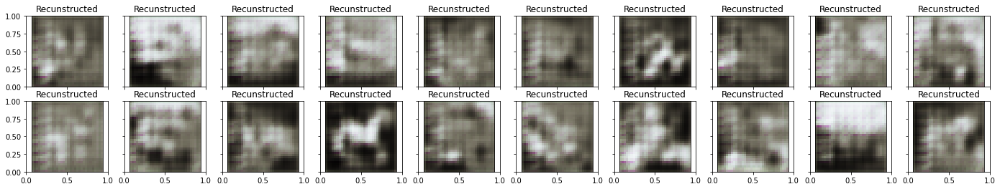

Autoencoder: G_loss: 0.58453
tensor(0.0187, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0210, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0195, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0199, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0220, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0206, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0206, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0208, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
[8/8] D_loss: 0.02078 G_loss: 0.02039
[8/8] G_loss: 0.00992

 EPOCH 123/200 	 train loss 0.5845274925231934 	 val loss 0.5986364483833313


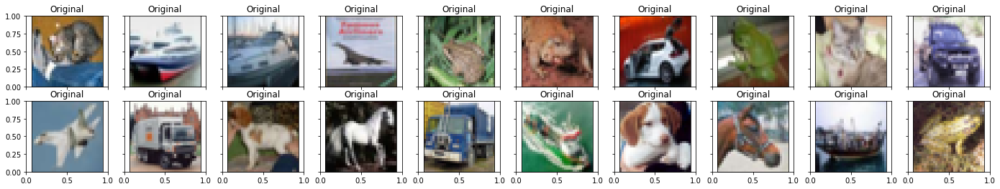

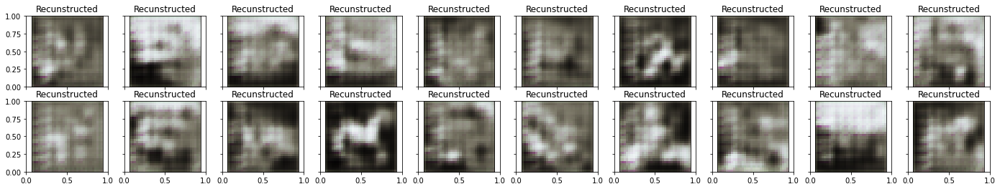

Autoencoder: G_loss: 0.58407
tensor(0.0191, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0199, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0216, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0217, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0191, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0196, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0225, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0200, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
[8/8] D_loss: 0.01997 G_loss: 0.02044
[8/8] G_loss: 0.00901

 EPOCH 124/200 	 train loss 0.584069013595581 	 val loss 0.5983880162239075


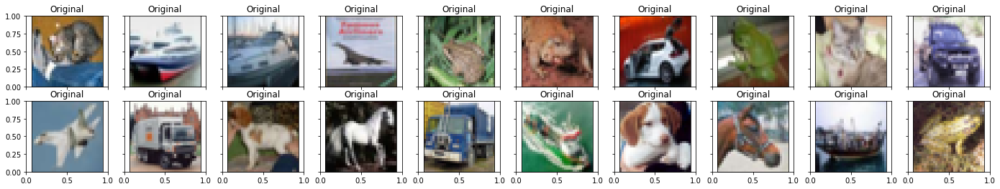

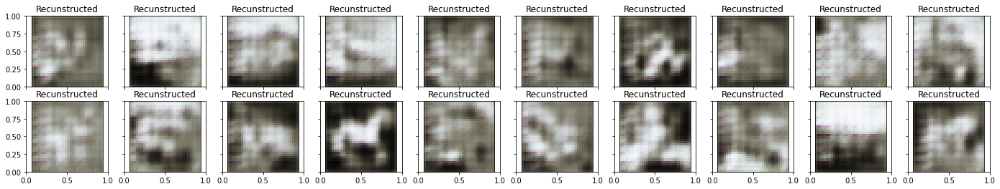

Autoencoder: G_loss: 0.58492
tensor(0.0208, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0172, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0176, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0184, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0175, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0182, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0180, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0183, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
[8/8] D_loss: 0.01828 G_loss: 0.01823
[8/8] G_loss: 0.01080

 EPOCH 125/200 	 train loss 0.5849168300628662 	 val loss 0.6007713675498962


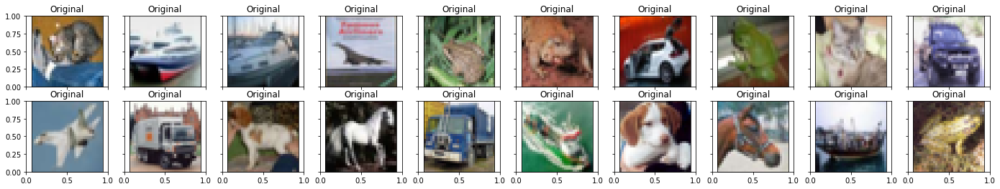

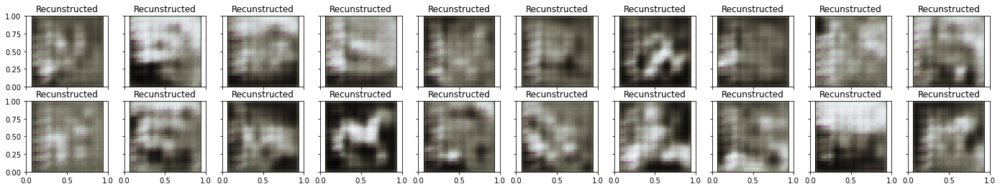

Autoencoder: G_loss: 0.58429
tensor(0.0232, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0229, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0231, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0213, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0227, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0231, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0217, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0253, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
[8/8] D_loss: 0.02531 G_loss: 0.02292
[8/8] G_loss: 0.00881

 EPOCH 126/200 	 train loss 0.5842896699905396 	 val loss 0.5961921215057373


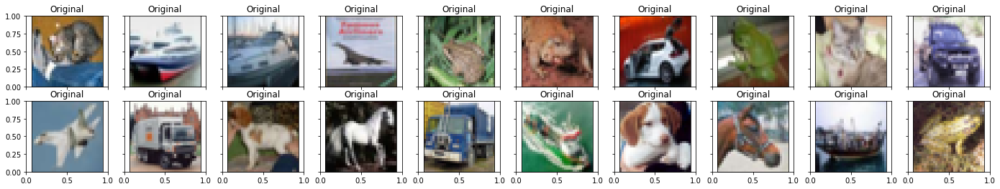

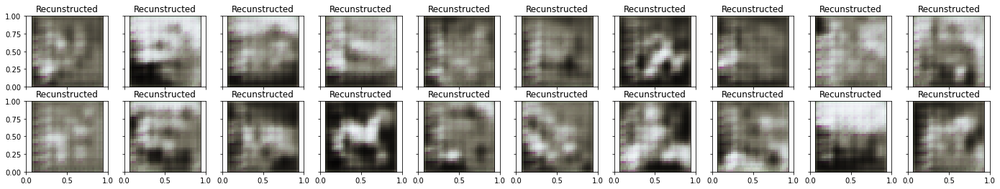

Autoencoder: G_loss: 0.58416
tensor(0.0207, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0214, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0209, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0212, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0202, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0230, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0208, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0199, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
[8/8] D_loss: 0.01994 G_loss: 0.02102
[8/8] G_loss: 0.00911

 EPOCH 127/200 	 train loss 0.5841565132141113 	 val loss 0.5972773432731628


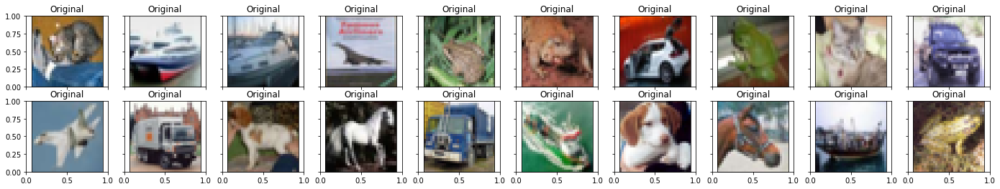

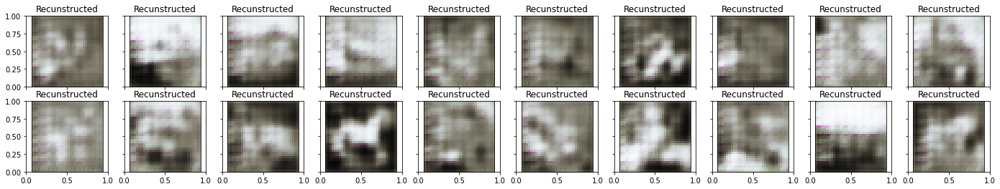

Autoencoder: G_loss: 0.58352
tensor(0.0164, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0179, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0212, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0188, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0242, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0198, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0204, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0241, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
[8/8] D_loss: 0.02405 G_loss: 0.02035
[8/8] G_loss: 0.00976

 EPOCH 128/200 	 train loss 0.5835164189338684 	 val loss 0.5920565724372864


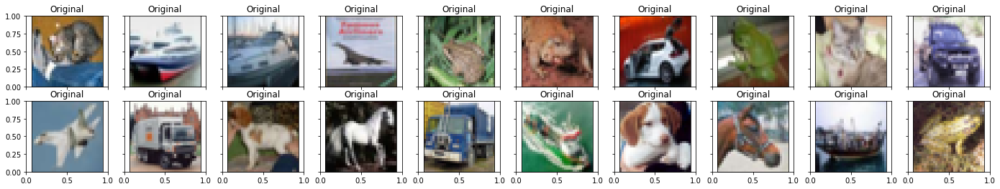

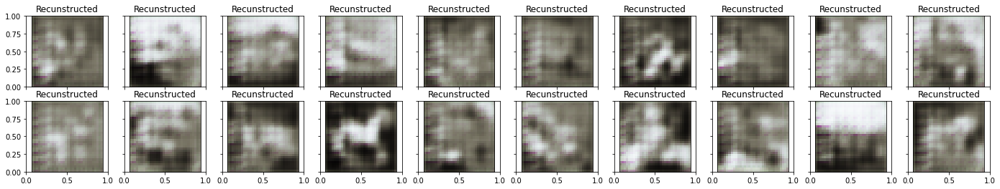

Autoencoder: G_loss: 0.58410
tensor(0.0250, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0233, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0241, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0236, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0252, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0253, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0224, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0242, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
[8/8] D_loss: 0.02421 G_loss: 0.02414
[8/8] G_loss: 0.00817

 EPOCH 129/200 	 train loss 0.5841044187545776 	 val loss 0.5919293761253357


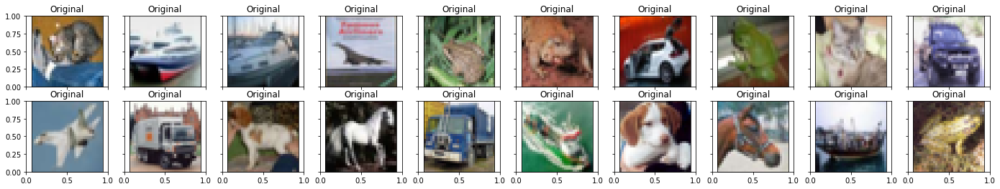

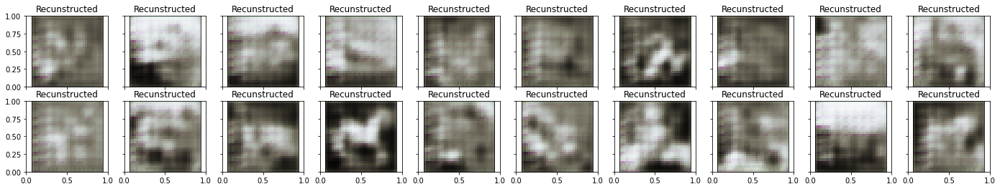

Autoencoder: G_loss: 0.58356
tensor(0.0201, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0221, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0234, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0251, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0223, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0232, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0231, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0154, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
[8/8] D_loss: 0.01540 G_loss: 0.02183
[8/8] G_loss: 0.00914

 EPOCH 130/200 	 train loss 0.5835615396499634 	 val loss 0.6141274571418762


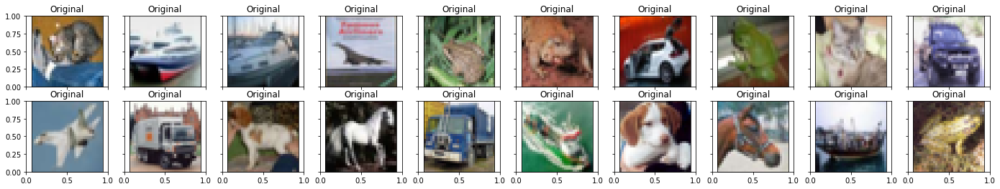

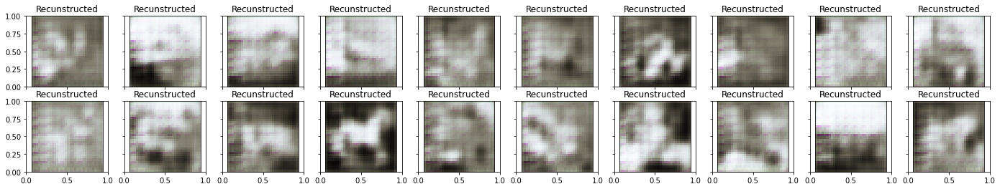

Autoencoder: G_loss: 0.58395
tensor(0.0203, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0219, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0190, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0215, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0241, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0232, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0201, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0166, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
[8/8] D_loss: 0.01656 G_loss: 0.02083
[8/8] G_loss: 0.01077

 EPOCH 131/200 	 train loss 0.5839473605155945 	 val loss 0.5914720892906189


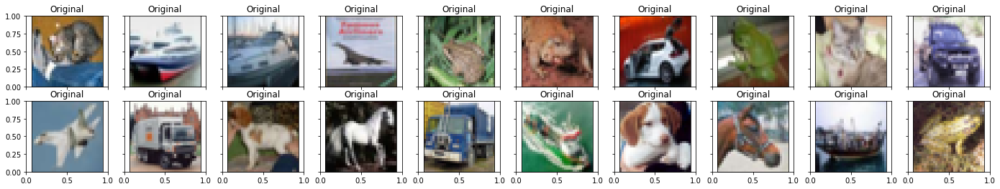

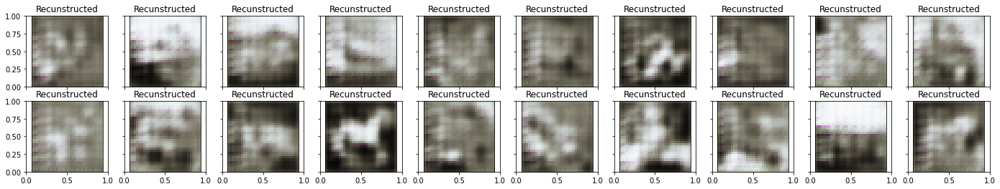

Autoencoder: G_loss: 0.58354
tensor(0.0294, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0334, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
D loss is increasing
tensor(0.0243, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0278, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0269, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0267, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0237, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0225, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
[8/8] D_loss: 0.02250 G_loss: 0.02684
[8/8] G_loss: 0.01166

 EPOCH 132/200 	 train loss 0.5835413932800293 	 val loss 0.5975911021232605


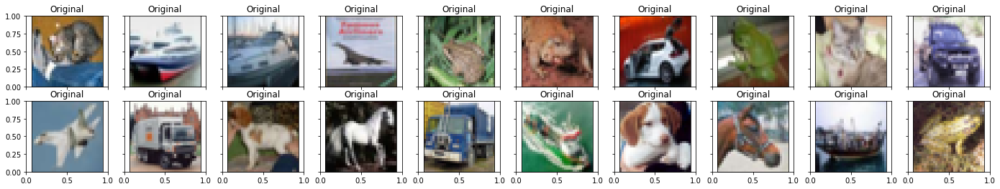

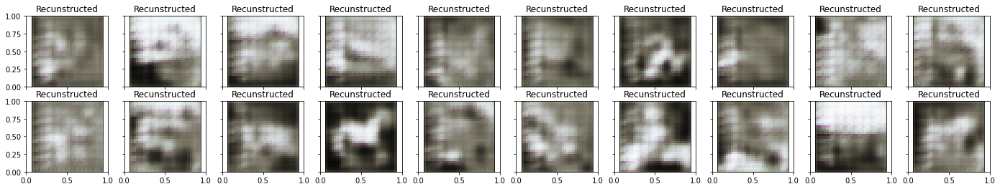

Autoencoder: G_loss: 0.58528
tensor(0.0238, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0237, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0254, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0256, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0240, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0258, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0230, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0298, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
[8/8] D_loss: 0.02978 G_loss: 0.02515
[8/8] G_loss: 0.01211

 EPOCH 133/200 	 train loss 0.5852811336517334 	 val loss 0.598473846912384


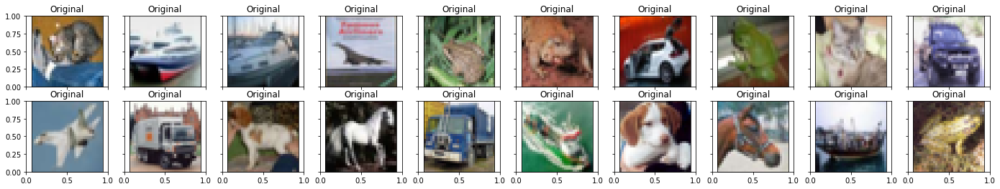

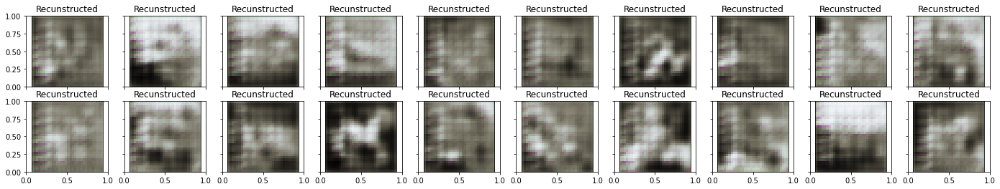

Autoencoder: G_loss: 0.58407
tensor(0.0221, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0240, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0230, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0234, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0219, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0240, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0271, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0262, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
[8/8] D_loss: 0.02621 G_loss: 0.02396
[8/8] G_loss: 0.01226

 EPOCH 134/200 	 train loss 0.5840652585029602 	 val loss 0.5996531844139099


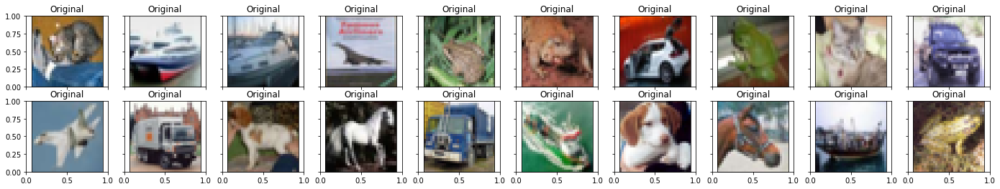

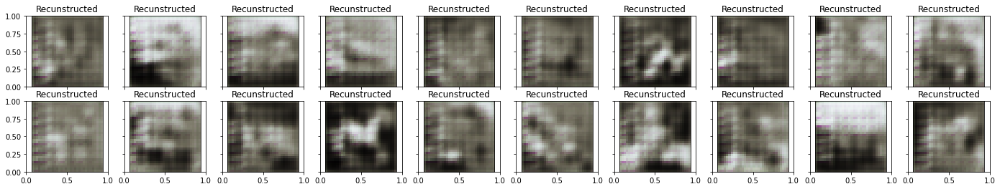

Autoencoder: G_loss: 0.58386
tensor(0.0341, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
D loss is increasing
tensor(0.0313, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
D loss is increasing
tensor(0.0236, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0242, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0231, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0248, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0269, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0286, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
[8/8] D_loss: 0.02860 G_loss: 0.02708
[8/8] G_loss: 0.01579

 EPOCH 135/200 	 train loss 0.5838624238967896 	 val loss 0.6171972751617432


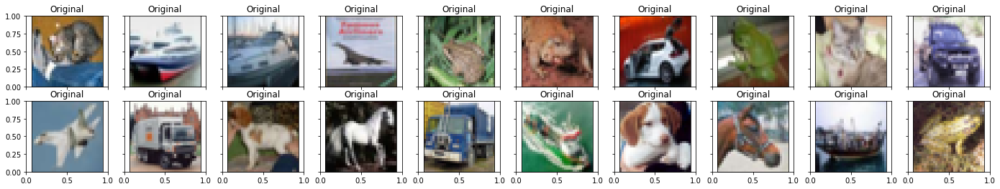

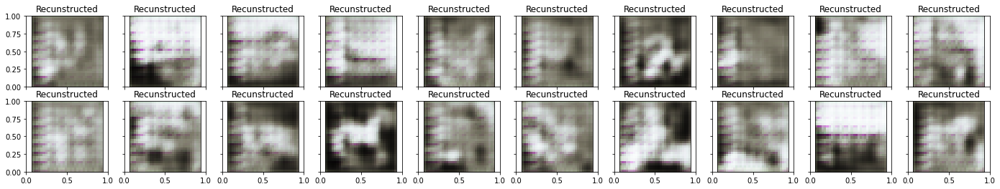

Autoencoder: G_loss: 0.58613
tensor(0.0181, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0203, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0200, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0204, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0168, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0203, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0160, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0208, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
[8/8] D_loss: 0.02076 G_loss: 0.01908
[8/8] G_loss: 0.02108

 EPOCH 136/200 	 train loss 0.5861328840255737 	 val loss 0.6066170334815979


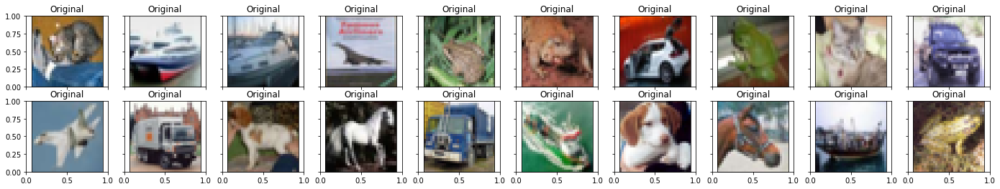

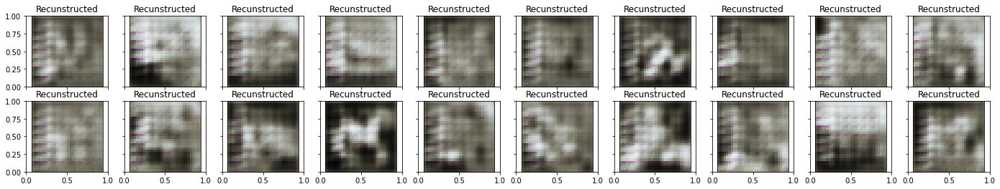

Autoencoder: G_loss: 0.58624
tensor(0.0259, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0243, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0255, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0206, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0252, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0228, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0219, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0429, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
D loss is increasing
[8/8] D_loss: 0.04294 G_loss: 0.02614
[8/8] G_loss: 0.01496

 EPOCH 137/200 	 train loss 0.5862361192703247 	 val loss 0.6114070415496826


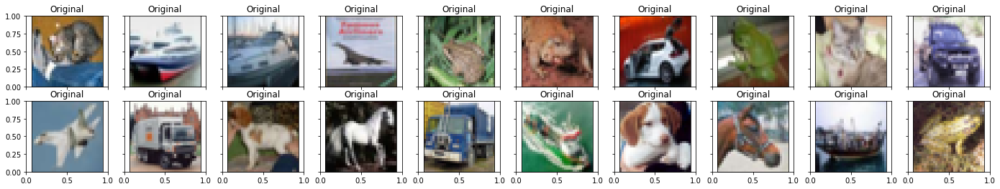

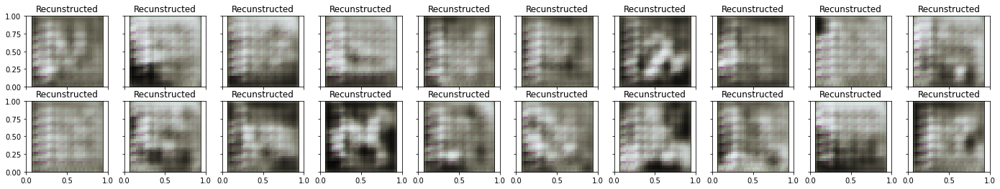

Autoencoder: G_loss: 0.58531
tensor(0.0199, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0213, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0230, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0188, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0209, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0208, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0199, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0193, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
[8/8] D_loss: 0.01934 G_loss: 0.02049
[8/8] G_loss: 0.01310

 EPOCH 138/200 	 train loss 0.585312008857727 	 val loss 0.5980804562568665


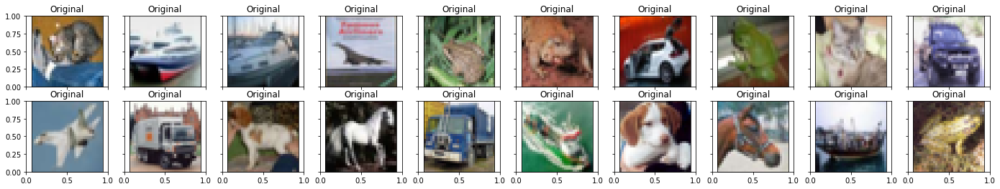

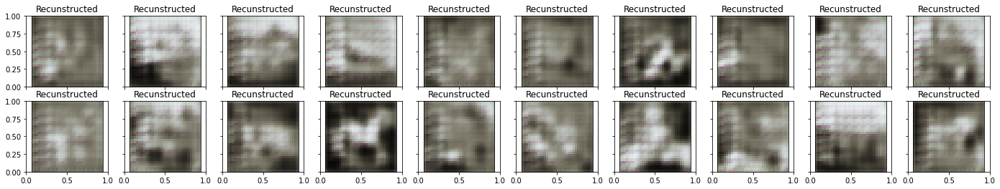

Autoencoder: G_loss: 0.58416
tensor(0.0197, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0220, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0202, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0262, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0265, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0229, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0202, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0214, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
[8/8] D_loss: 0.02141 G_loss: 0.02240
[8/8] G_loss: 0.01253

 EPOCH 139/200 	 train loss 0.5841614007949829 	 val loss 0.5963640809059143


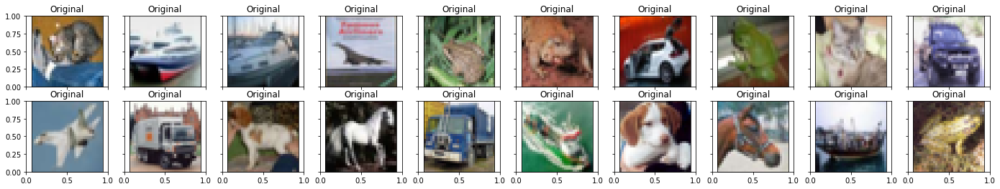

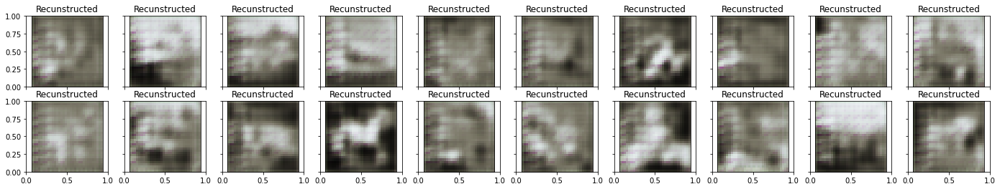

Autoencoder: G_loss: 0.58385
tensor(0.0219, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0293, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0250, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0213, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0236, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0205, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0267, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0299, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
[8/8] D_loss: 0.02991 G_loss: 0.02479
[8/8] G_loss: 0.00950

 EPOCH 140/200 	 train loss 0.5838500261306763 	 val loss 0.5971480011940002


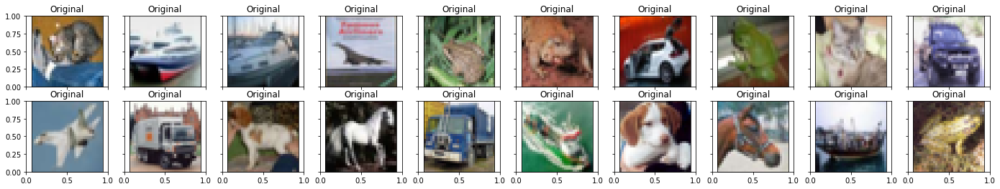

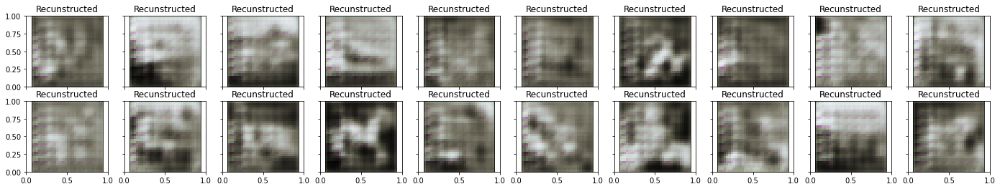

Autoencoder: G_loss: 0.58319
tensor(0.0260, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0242, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0263, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0253, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0270, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0241, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0272, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0187, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
[8/8] D_loss: 0.01866 G_loss: 0.02484
[8/8] G_loss: 0.00800

 EPOCH 141/200 	 train loss 0.5831912755966187 	 val loss 0.5887429118156433


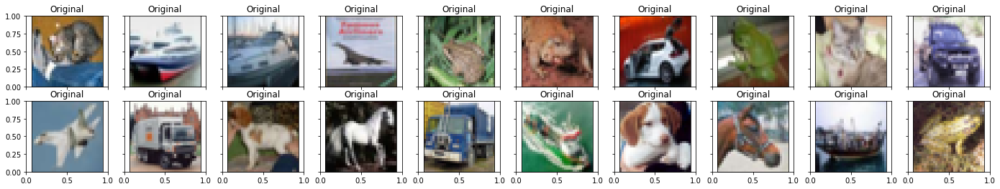

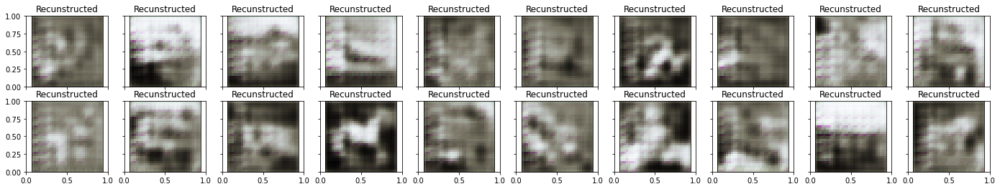

Autoencoder: G_loss: 0.58261
tensor(0.0221, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0235, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0257, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0264, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0234, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0257, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0230, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0196, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
[8/8] D_loss: 0.01960 G_loss: 0.02368
[8/8] G_loss: 0.00803

 EPOCH 142/200 	 train loss 0.5826107263565063 	 val loss 0.589874267578125


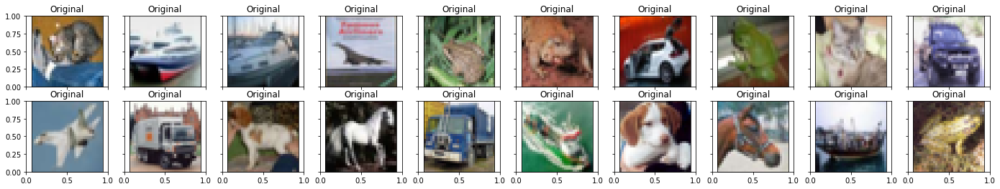

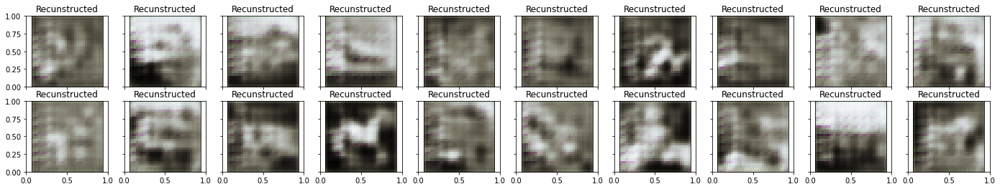

Autoencoder: G_loss: 0.58225
tensor(0.0279, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0253, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0240, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0248, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0240, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0235, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0264, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0237, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
[8/8] D_loss: 0.02365 G_loss: 0.02495
[8/8] G_loss: 0.00762

 EPOCH 143/200 	 train loss 0.5822473764419556 	 val loss 0.5878129005432129


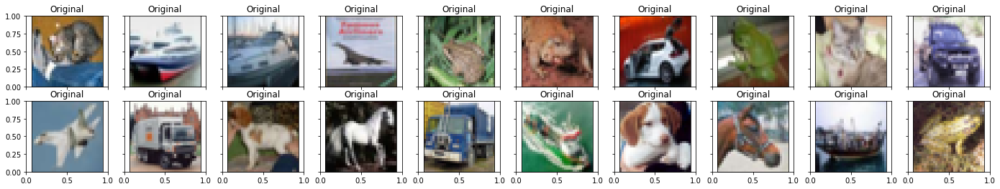

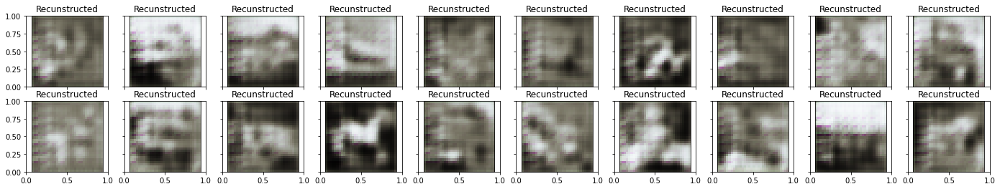

Autoencoder: G_loss: 0.58193
tensor(0.0268, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0276, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0253, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0260, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0245, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0239, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0262, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0299, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
[8/8] D_loss: 0.02992 G_loss: 0.02628
[8/8] G_loss: 0.00837

 EPOCH 144/200 	 train loss 0.5819332003593445 	 val loss 0.5887376070022583


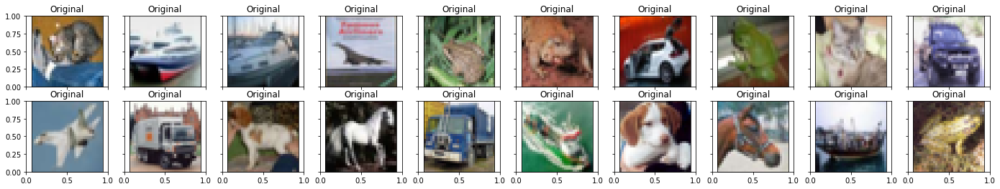

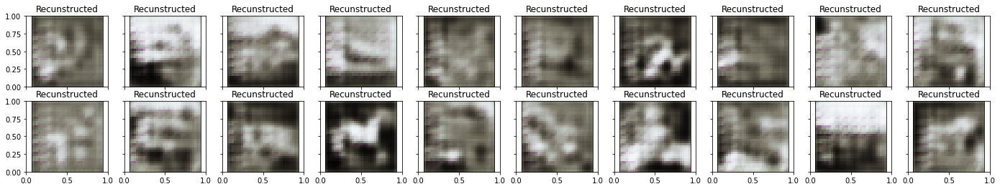

Autoencoder: G_loss: 0.58266
tensor(0.0252, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0239, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0242, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0251, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0241, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0241, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0320, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
D loss is increasing
tensor(0.0282, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
[8/8] D_loss: 0.02820 G_loss: 0.02584
[8/8] G_loss: 0.01182

 EPOCH 145/200 	 train loss 0.5826632976531982 	 val loss 0.5937292575836182


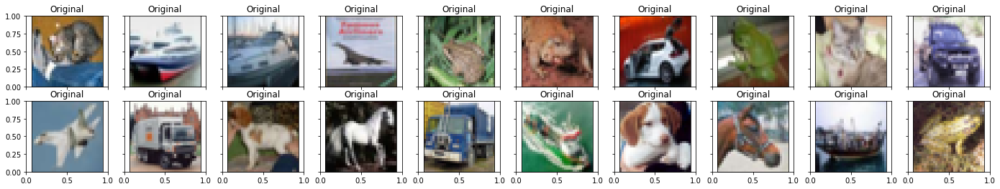

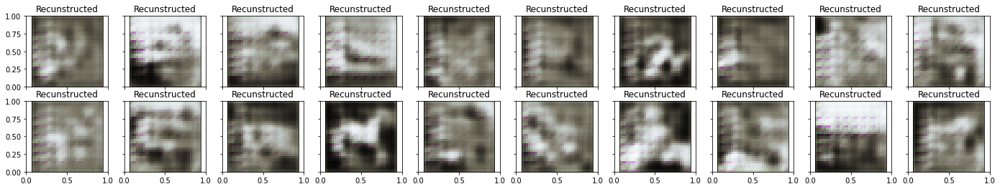

Autoencoder: G_loss: 0.58348
tensor(0.0200, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0212, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0221, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0233, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0185, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0229, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0218, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0253, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
[8/8] D_loss: 0.02529 G_loss: 0.02188
[8/8] G_loss: 0.01235

 EPOCH 146/200 	 train loss 0.5834790468215942 	 val loss 0.5958569049835205


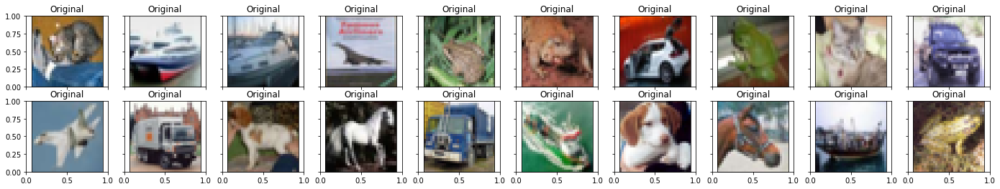

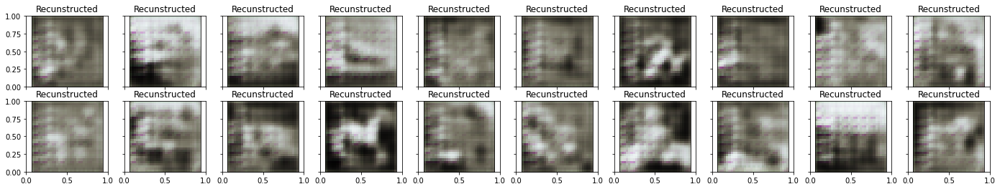

Autoencoder: G_loss: 0.58345
tensor(0.0268, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0225, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0223, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0242, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0209, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0225, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0240, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0289, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
[8/8] D_loss: 0.02886 G_loss: 0.02401
[8/8] G_loss: 0.01071

 EPOCH 147/200 	 train loss 0.583449125289917 	 val loss 0.6124414205551147


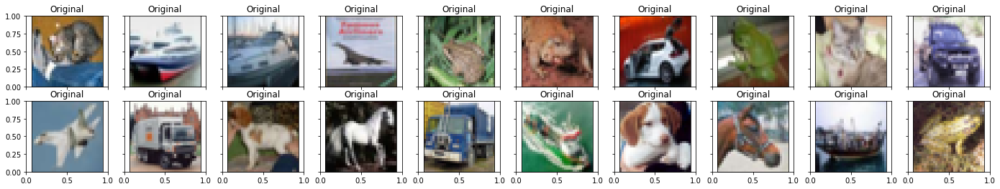

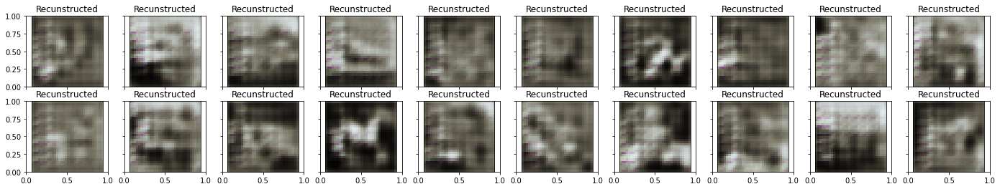

Autoencoder: G_loss: 0.58304
tensor(0.0262, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0287, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0271, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0280, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0295, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0298, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0264, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0229, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
[8/8] D_loss: 0.02293 G_loss: 0.02733
[8/8] G_loss: 0.01045

 EPOCH 148/200 	 train loss 0.5830409526824951 	 val loss 0.5939140915870667


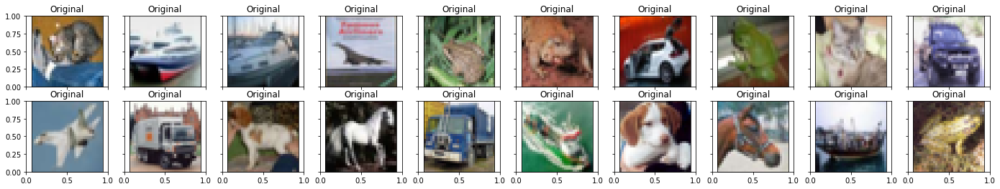

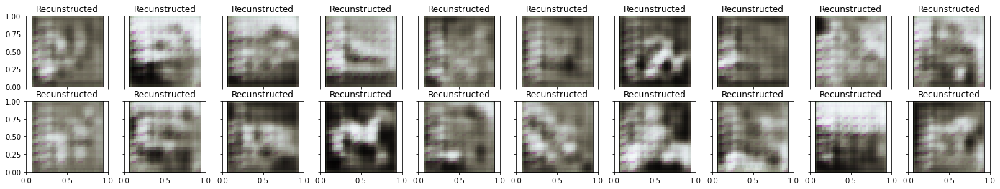

Autoencoder: G_loss: 0.58250
tensor(0.0292, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0299, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0266, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0297, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0253, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0272, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0279, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0341, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
D loss is increasing
[8/8] D_loss: 0.03408 G_loss: 0.02875
[8/8] G_loss: 0.02082

 EPOCH 149/200 	 train loss 0.5824958086013794 	 val loss 0.6228790283203125


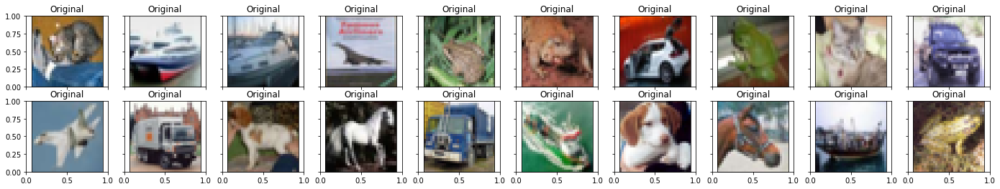

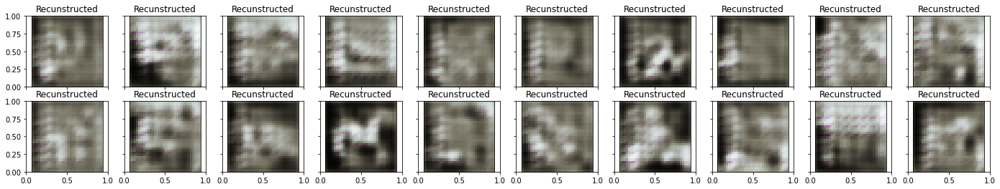

Autoencoder: G_loss: 0.58829
tensor(0.0249, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0226, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0165, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0199, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0229, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0230, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0250, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0139, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
[8/8] D_loss: 0.01389 G_loss: 0.02107
[8/8] G_loss: 0.02524

 EPOCH 150/200 	 train loss 0.5882933139801025 	 val loss 0.6218299269676208


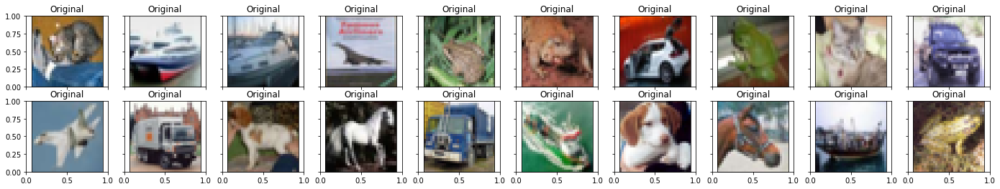

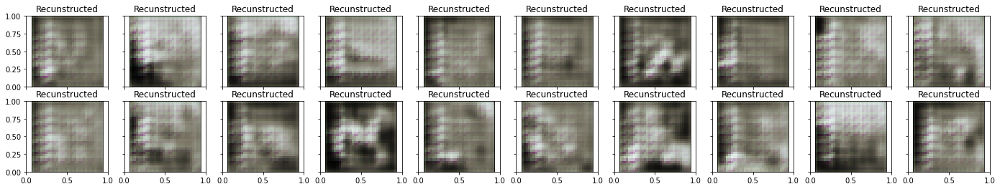

Autoencoder: G_loss: 0.58816
tensor(0.0266, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0257, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0254, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0297, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0262, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0262, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0245, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0294, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
[8/8] D_loss: 0.02941 G_loss: 0.02671
[8/8] G_loss: 0.02033

 EPOCH 151/200 	 train loss 0.5881575345993042 	 val loss 0.6224598288536072


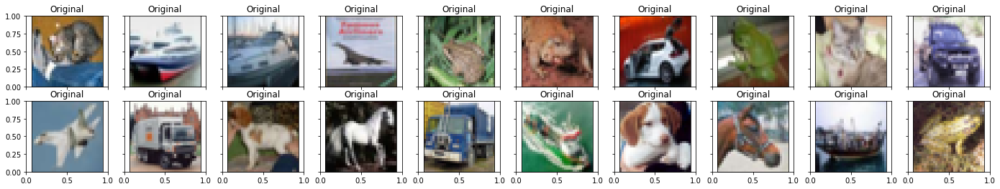

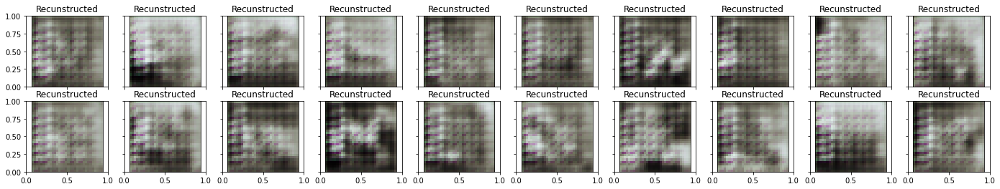

Autoencoder: G_loss: 0.58684
tensor(0.0415, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
D loss is increasing
tensor(0.0292, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0326, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
D loss is increasing
tensor(0.0269, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0253, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0273, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0250, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0348, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
D loss is increasing
[8/8] D_loss: 0.03475 G_loss: 0.03032
[8/8] G_loss: 0.05880

 EPOCH 152/200 	 train loss 0.5868425369262695 	 val loss 0.8354395627975464


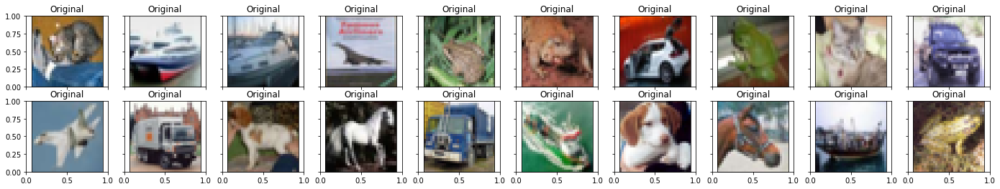

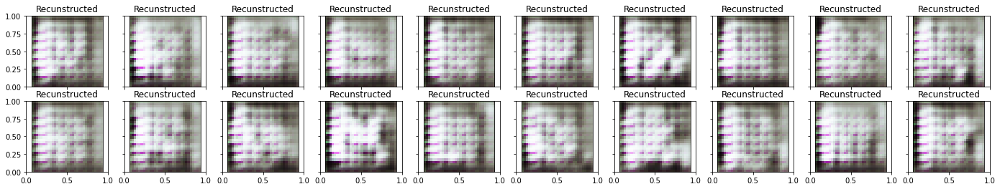

Autoencoder: G_loss: 0.59795
tensor(0.0326, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
D loss is increasing
tensor(0.0318, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
D loss is increasing
tensor(0.0288, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0282, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0260, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0279, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0295, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0327, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
D loss is increasing
[8/8] D_loss: 0.03272 G_loss: 0.02966
[8/8] G_loss: 0.06634

 EPOCH 153/200 	 train loss 0.5979477167129517 	 val loss 0.8018057942390442


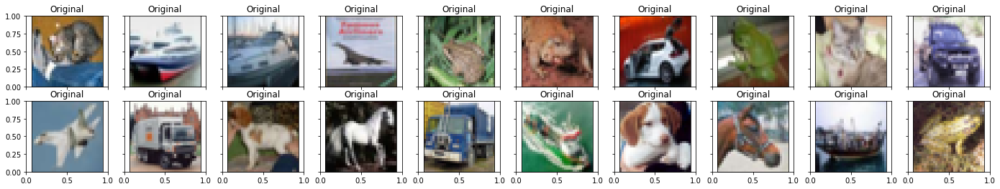

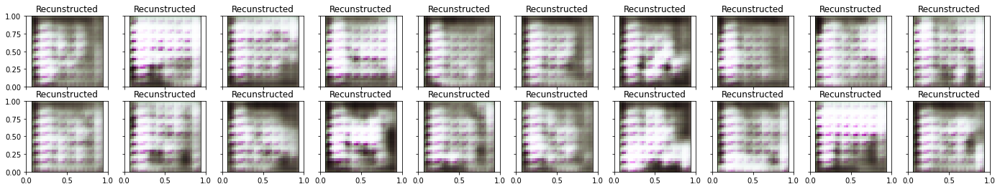

Autoencoder: G_loss: 0.60077
tensor(0.0703, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
D loss is increasing
tensor(0.1356, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
D loss is increasing
tensor(0.0637, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
D loss is increasing
tensor(0.0276, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0294, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0331, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
D loss is increasing
tensor(0.0858, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
D loss is increasing
tensor(0.0292, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
[8/8] D_loss: 0.02916 G_loss: 0.05932
[8/8] G_loss: 0.40115

 EPOCH 154/200 	 train loss 0.6007712483406067 	 val loss 0.9204435348510742


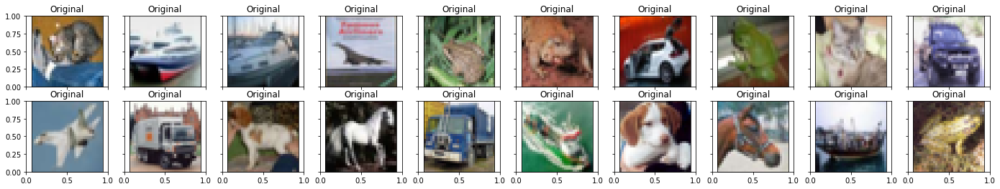

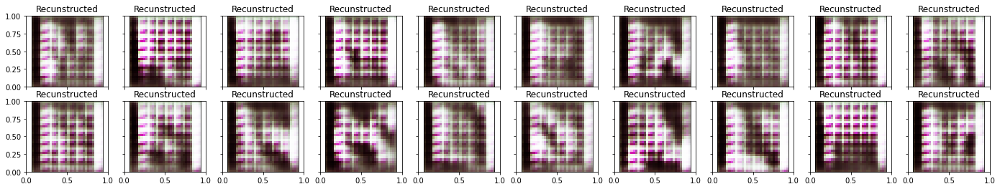

Autoencoder: G_loss: 0.64260
tensor(0.2143, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
D loss is increasing
tensor(0.1866, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
D loss is increasing
tensor(0.2701, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
D loss is increasing
tensor(0.1127, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
D loss is increasing
tensor(0.0898, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
D loss is increasing
tensor(0.0977, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
D loss is increasing
tensor(0.1362, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
D loss is increasing
tensor(0.1026, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
D loss is increasing
[8/8] D_loss: 0.10256 G_loss: 0.15124
[8/8] G_loss: 0.31843

 EPOCH 155/200 	 train loss 0.64259934425354 	 val loss 0.7366511821746826


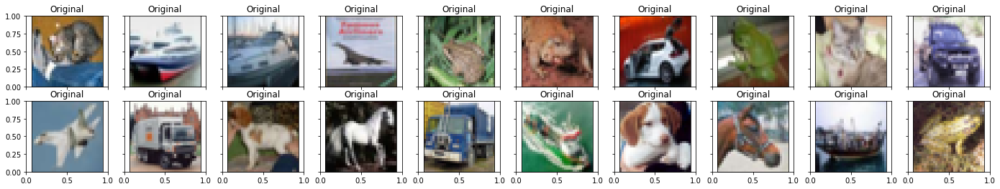

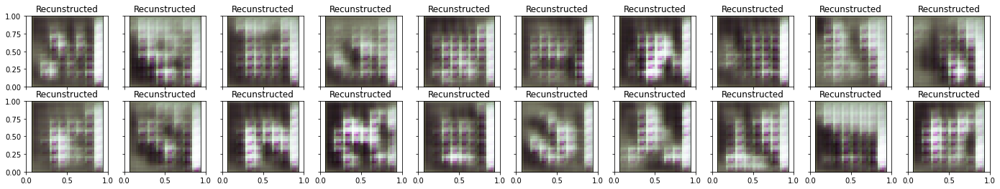

Autoencoder: G_loss: 0.62109
tensor(0.0675, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
D loss is increasing
tensor(0.0720, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
D loss is increasing
tensor(0.0735, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
D loss is increasing
tensor(0.0657, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
D loss is increasing
tensor(0.0598, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
D loss is increasing
tensor(0.0574, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
D loss is increasing
tensor(0.0509, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
D loss is increasing
tensor(0.0508, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
D loss is increasing
[8/8] D_loss: 0.05076 G_loss: 0.06221
[8/8] G_loss: 0.47646

 EPOCH 156/200 	 train loss 0.6210944056510925 	 val loss 0.7301541566848755


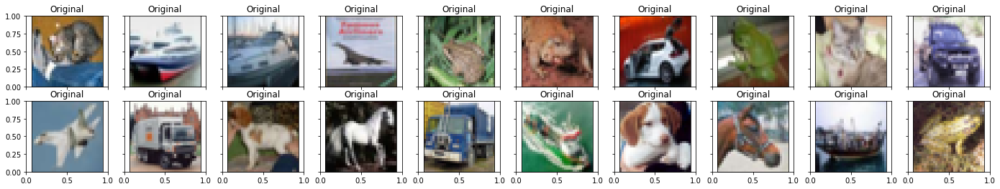

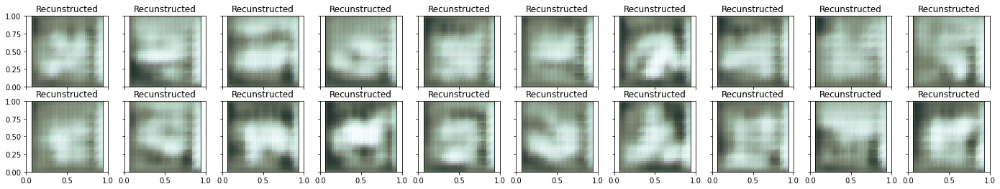

Autoencoder: G_loss: 0.61707
tensor(0.0509, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
D loss is increasing
tensor(0.0445, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
D loss is increasing
tensor(0.0434, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
D loss is increasing
tensor(0.0369, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
D loss is increasing
tensor(0.0333, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
D loss is increasing
tensor(0.0306, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
D loss is increasing
tensor(0.0287, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0276, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
[8/8] D_loss: 0.02763 G_loss: 0.03700
[8/8] G_loss: 0.07139

 EPOCH 157/200 	 train loss 0.6170706152915955 	 val loss 0.6192252039909363


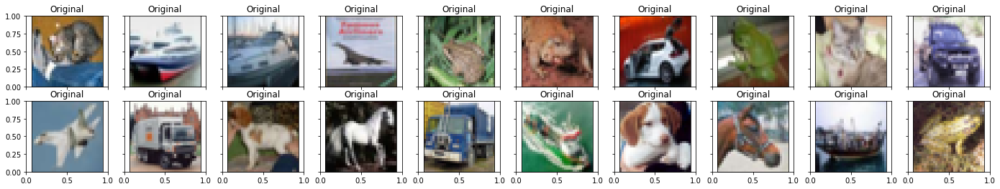

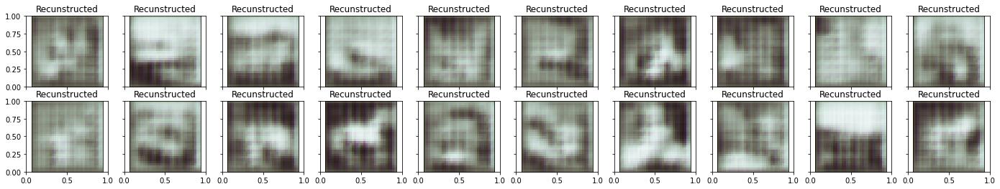

Autoencoder: G_loss: 0.60024
tensor(0.0453, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
D loss is increasing
tensor(0.0385, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
D loss is increasing
tensor(0.0261, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0264, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0233, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0202, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0242, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0304, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
D loss is increasing
[8/8] D_loss: 0.03035 G_loss: 0.02928
[8/8] G_loss: 0.06953

 EPOCH 158/200 	 train loss 0.6002424955368042 	 val loss 0.6092064380645752


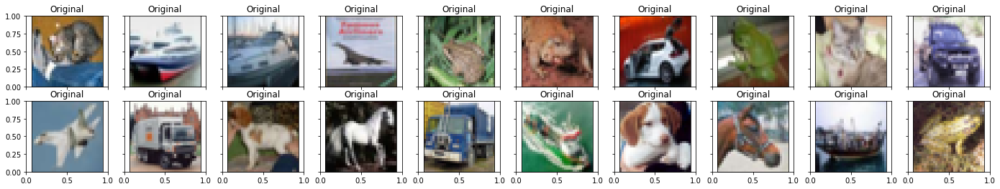

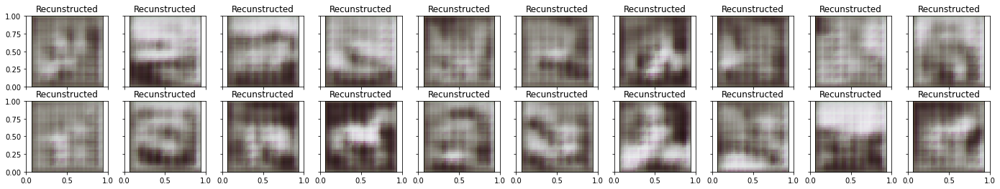

Autoencoder: G_loss: 0.59548
tensor(0.0455, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
D loss is increasing
tensor(0.0370, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
D loss is increasing
tensor(0.0368, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
D loss is increasing
tensor(0.0301, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
D loss is increasing
tensor(0.0234, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0237, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0265, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0246, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
[8/8] D_loss: 0.02464 G_loss: 0.03095
[8/8] G_loss: 0.09648

 EPOCH 159/200 	 train loss 0.5954830050468445 	 val loss 0.6095955967903137


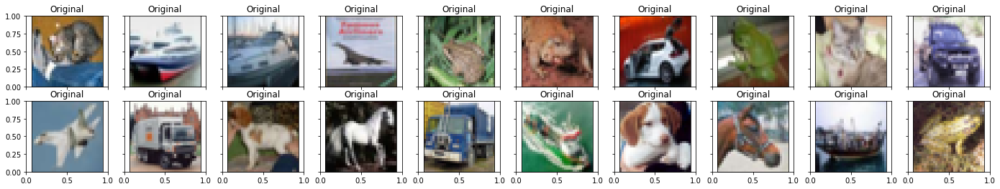

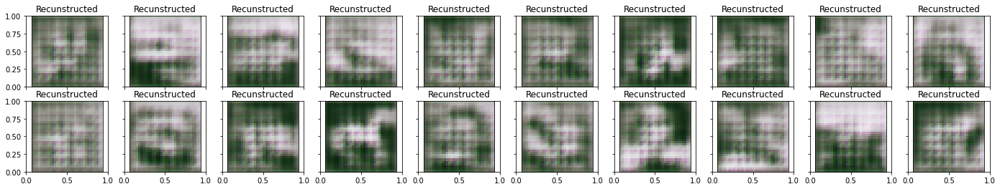

Autoencoder: G_loss: 0.59766
tensor(0.0765, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
D loss is increasing
tensor(0.0539, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
D loss is increasing
tensor(0.0566, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
D loss is increasing
tensor(0.0483, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
D loss is increasing
tensor(0.0504, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
D loss is increasing
tensor(0.0384, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
D loss is increasing
tensor(0.0391, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
D loss is increasing
tensor(0.0362, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
D loss is increasing
[8/8] D_loss: 0.03623 G_loss: 0.04992
[8/8] G_loss: 0.04281

 EPOCH 160/200 	 train loss 0.597659170627594 	 val loss 0.6107123494148254


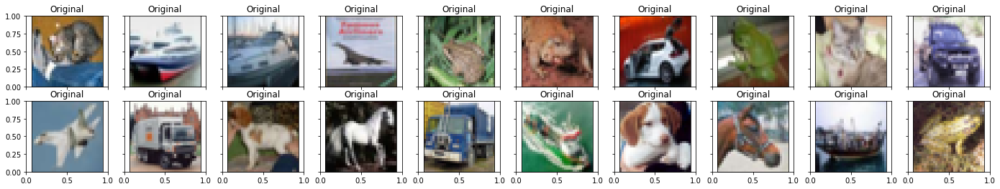

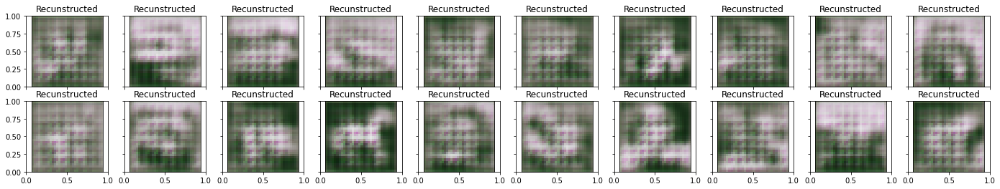

Autoencoder: G_loss: 0.59372
tensor(0.0192, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0152, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0138, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0169, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0178, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0205, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0161, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0203, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
[8/8] D_loss: 0.02033 G_loss: 0.01748
[8/8] G_loss: 0.05564

 EPOCH 161/200 	 train loss 0.5937168002128601 	 val loss 0.6229528784751892


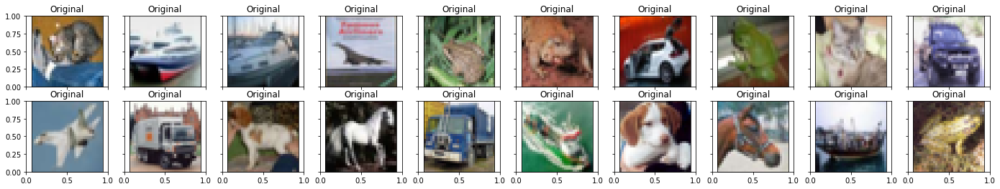

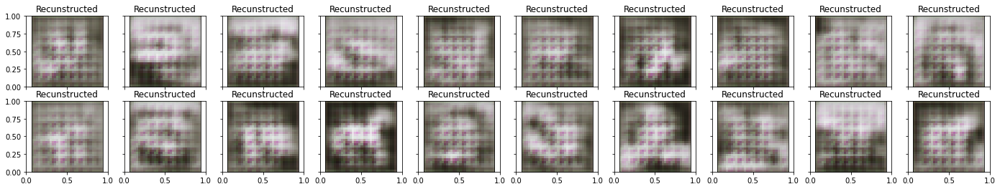

Autoencoder: G_loss: 0.59348
tensor(0.0291, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0262, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0226, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0209, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0255, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0231, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0257, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0235, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
[8/8] D_loss: 0.02348 G_loss: 0.02457
[8/8] G_loss: 0.01371

 EPOCH 162/200 	 train loss 0.5934824347496033 	 val loss 0.6006881594657898


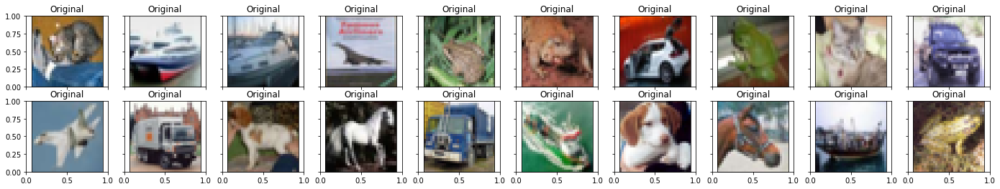

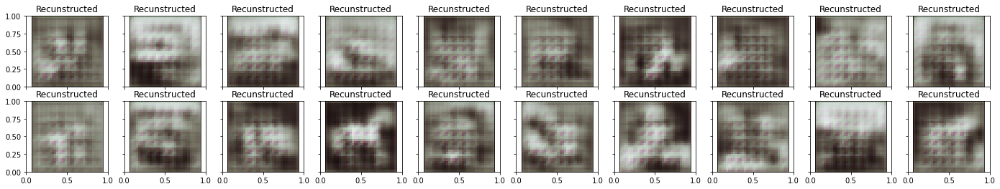

Autoencoder: G_loss: 0.58942
tensor(0.0359, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
D loss is increasing
tensor(0.0382, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
D loss is increasing
tensor(0.0257, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0224, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0240, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0191, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0271, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0277, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
[8/8] D_loss: 0.02773 G_loss: 0.02754
[8/8] G_loss: 0.05544

 EPOCH 163/200 	 train loss 0.5894245505332947 	 val loss 0.6362382173538208


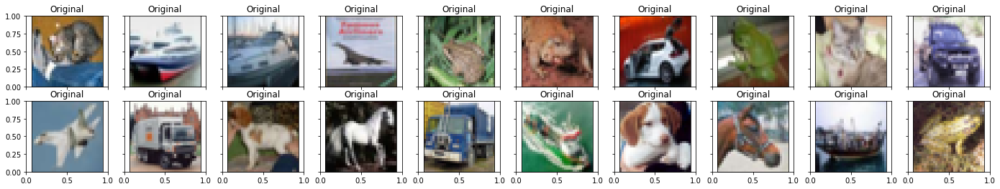

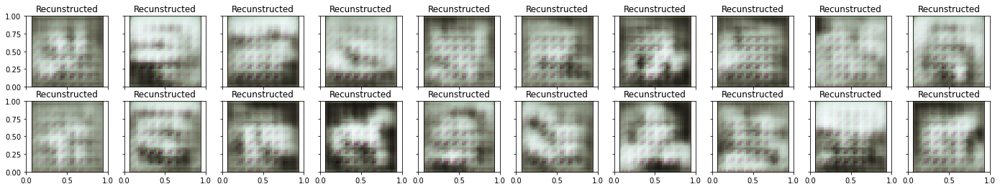

Autoencoder: G_loss: 0.59176
tensor(0.0411, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
D loss is increasing
tensor(0.0371, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
D loss is increasing
tensor(0.0358, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
D loss is increasing
tensor(0.0396, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
D loss is increasing
tensor(0.0362, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
D loss is increasing
tensor(0.0257, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0282, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0441, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
D loss is increasing
[8/8] D_loss: 0.04408 G_loss: 0.03597
[8/8] G_loss: 0.01402

 EPOCH 164/200 	 train loss 0.5917643904685974 	 val loss 0.5973145961761475


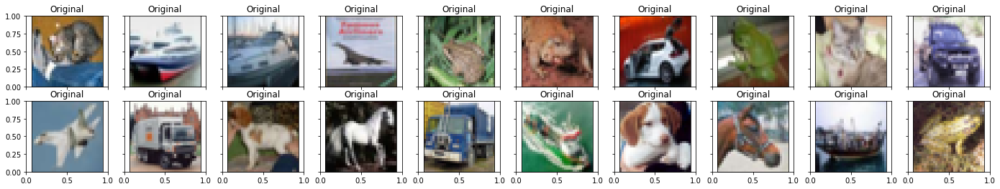

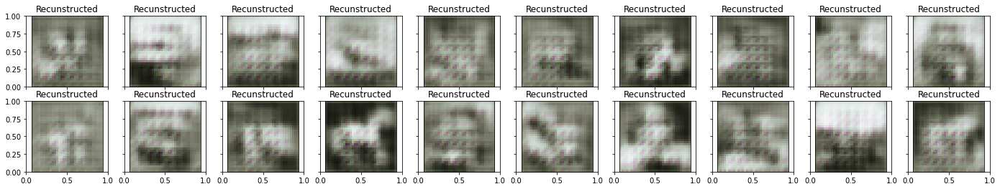

Autoencoder: G_loss: 0.58831
tensor(0.0305, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
D loss is increasing
tensor(0.0291, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0274, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0307, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
D loss is increasing
tensor(0.0243, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0219, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0237, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0258, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
[8/8] D_loss: 0.02579 G_loss: 0.02667
[8/8] G_loss: 0.04724

 EPOCH 165/200 	 train loss 0.5883055925369263 	 val loss 0.6218475103378296


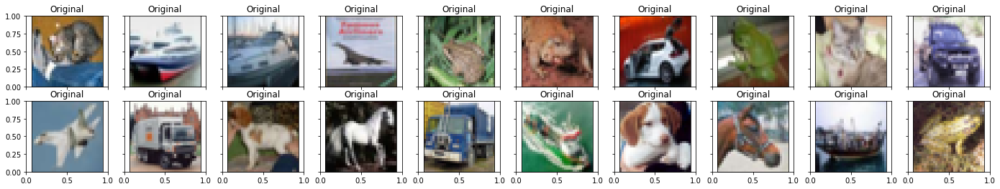

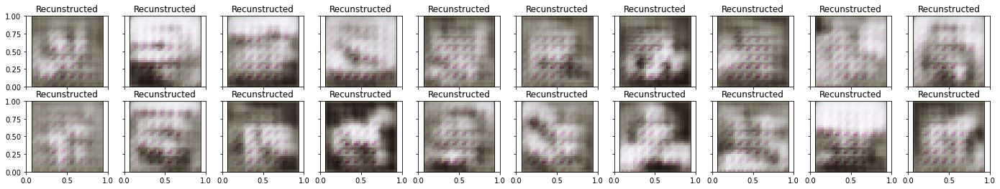

Autoencoder: G_loss: 0.58910
tensor(0.0326, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
D loss is increasing
tensor(0.0355, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
D loss is increasing
tensor(0.0283, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0250, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0239, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0262, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0247, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0351, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
D loss is increasing
[8/8] D_loss: 0.03510 G_loss: 0.02891
[8/8] G_loss: 0.02631

 EPOCH 166/200 	 train loss 0.5890974998474121 	 val loss 0.6171605587005615


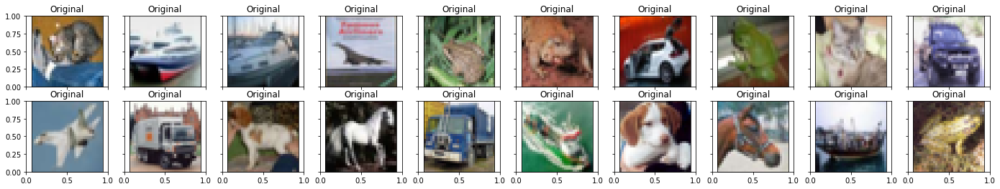

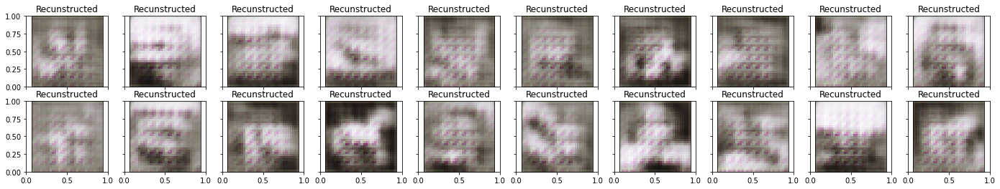

Autoencoder: G_loss: 0.58906
tensor(0.0359, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
D loss is increasing
tensor(0.0455, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
D loss is increasing
tensor(0.0383, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
D loss is increasing
tensor(0.0321, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
D loss is increasing
tensor(0.0220, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0247, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0236, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0270, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
[8/8] D_loss: 0.02703 G_loss: 0.03115
[8/8] G_loss: 0.11507

 EPOCH 167/200 	 train loss 0.5890625715255737 	 val loss 0.6170781254768372


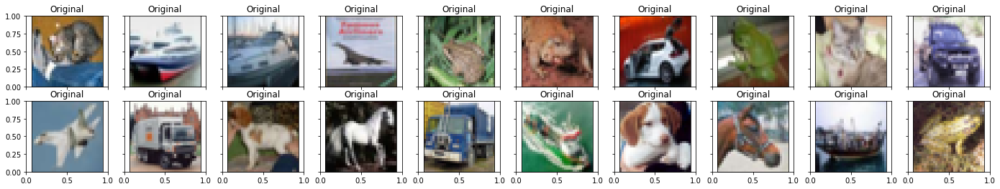

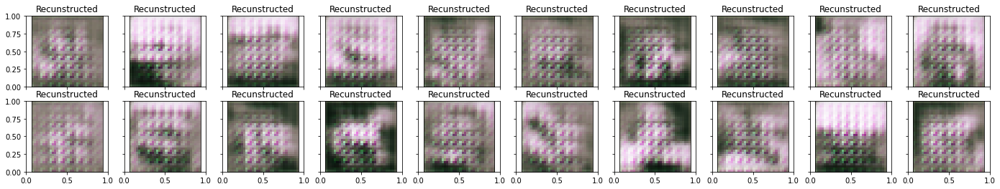

Autoencoder: G_loss: 0.59350
tensor(0.1730, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
D loss is increasing
tensor(0.1385, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
D loss is increasing
tensor(0.6742, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
D loss is increasing
tensor(0.1620, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
D loss is increasing
tensor(0.0661, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
D loss is increasing
tensor(0.1214, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
D loss is increasing
tensor(0.1121, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
D loss is increasing
tensor(0.1088, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
D loss is increasing
[8/8] D_loss: 0.10883 G_loss: 0.19452
[8/8] G_loss: 0.30975

 EPOCH 168/200 	 train loss 0.593501091003418 	 val loss 0.6829647421836853


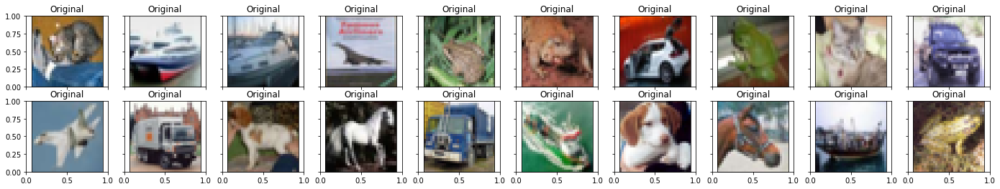

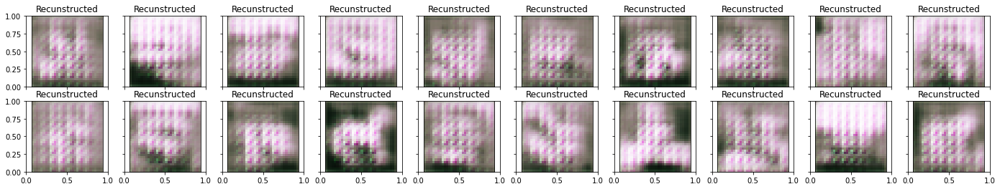

Autoencoder: G_loss: 0.59933
tensor(0.1326, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
D loss is increasing
tensor(0.1346, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
D loss is increasing
tensor(0.1276, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
D loss is increasing
tensor(0.1248, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
D loss is increasing
tensor(0.1238, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
D loss is increasing
tensor(0.1111, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
D loss is increasing
tensor(0.1125, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
D loss is increasing
tensor(0.1222, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
D loss is increasing
[8/8] D_loss: 0.12216 G_loss: 0.12364
[8/8] G_loss: 0.17733

 EPOCH 169/200 	 train loss 0.599331259727478 	 val loss 0.6536063551902771


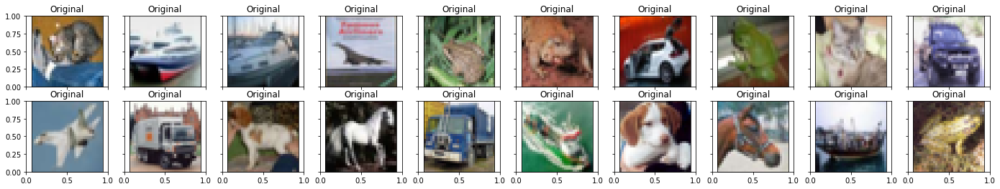

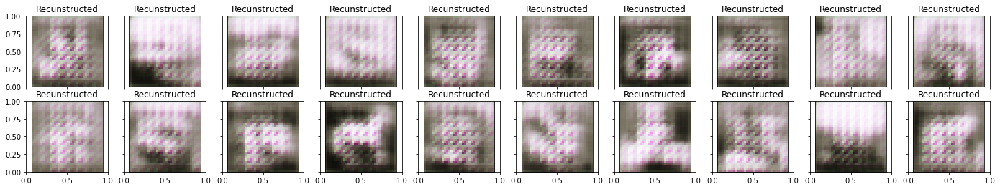

Autoencoder: G_loss: 0.59747
tensor(0.0864, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
D loss is increasing
tensor(0.0842, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
D loss is increasing
tensor(0.0797, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
D loss is increasing
tensor(0.0701, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
D loss is increasing
tensor(0.0596, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
D loss is increasing
tensor(0.0616, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
D loss is increasing
tensor(0.0550, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
D loss is increasing
tensor(0.0683, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
D loss is increasing
[8/8] D_loss: 0.06831 G_loss: 0.07061
[8/8] G_loss: 0.03203

 EPOCH 170/200 	 train loss 0.5974704027175903 	 val loss 0.6109344363212585


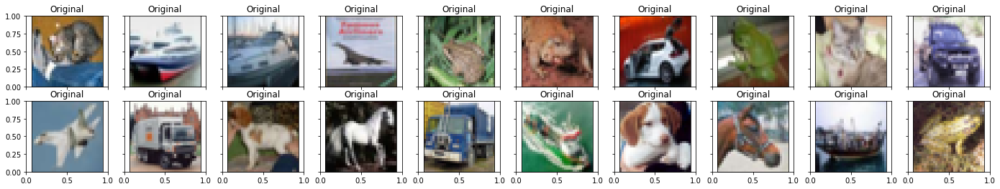

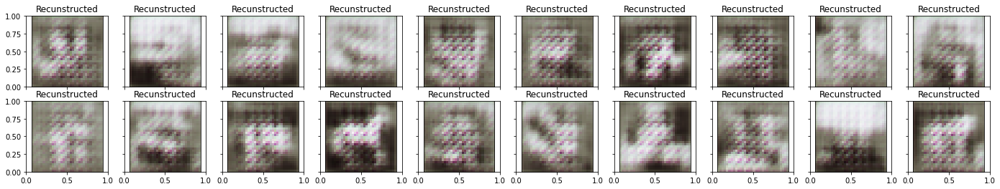

Autoencoder: G_loss: 0.59297
tensor(0.0521, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
D loss is increasing
tensor(0.0457, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
D loss is increasing
tensor(0.0405, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
D loss is increasing
tensor(0.0399, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
D loss is increasing
tensor(0.0355, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
D loss is increasing
tensor(0.0338, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
D loss is increasing
tensor(0.0341, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
D loss is increasing
tensor(0.0182, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
[8/8] D_loss: 0.01819 G_loss: 0.03747
[8/8] G_loss: 0.02519

 EPOCH 171/200 	 train loss 0.5929737687110901 	 val loss 0.6044152975082397


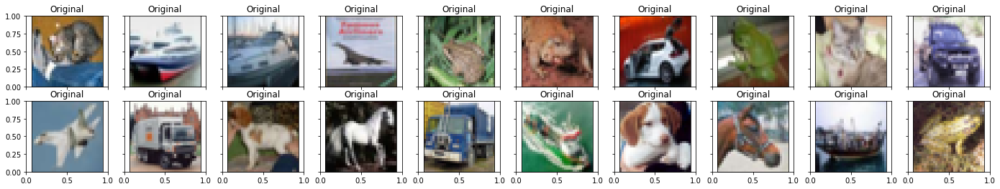

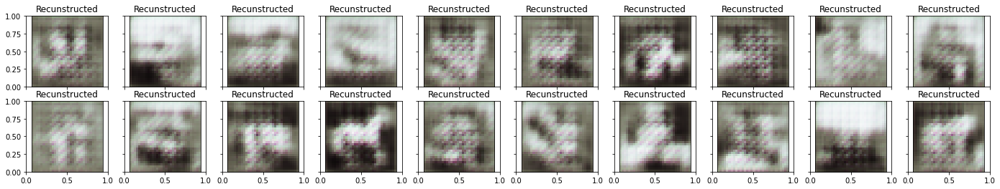

Autoencoder: G_loss: 0.58901
tensor(0.0337, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
D loss is increasing
tensor(0.0280, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0254, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0269, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0280, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0318, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
D loss is increasing
tensor(0.0305, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
D loss is increasing
tensor(0.0193, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
[8/8] D_loss: 0.01931 G_loss: 0.02793
[8/8] G_loss: 0.02959

 EPOCH 172/200 	 train loss 0.589012086391449 	 val loss 0.6293372511863708


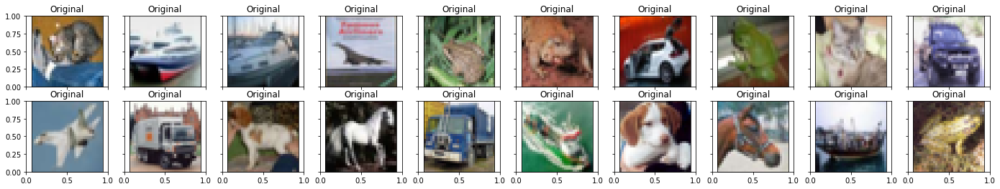

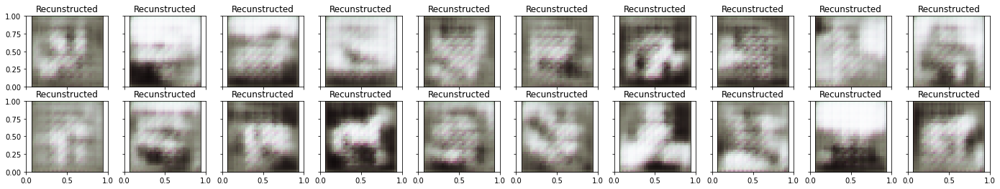

Autoencoder: G_loss: 0.58915
tensor(0.0276, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0259, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0217, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0207, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0289, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0269, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0232, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0214, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
[8/8] D_loss: 0.02136 G_loss: 0.02453
[8/8] G_loss: 0.02267

 EPOCH 173/200 	 train loss 0.5891506671905518 	 val loss 0.6099966168403625


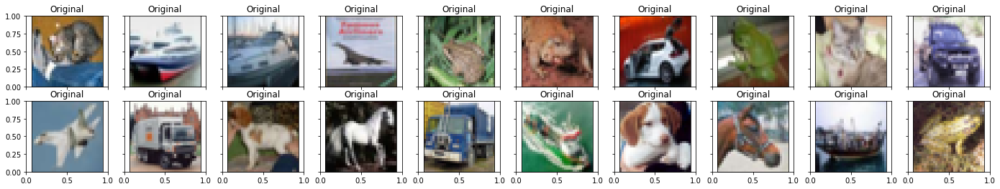

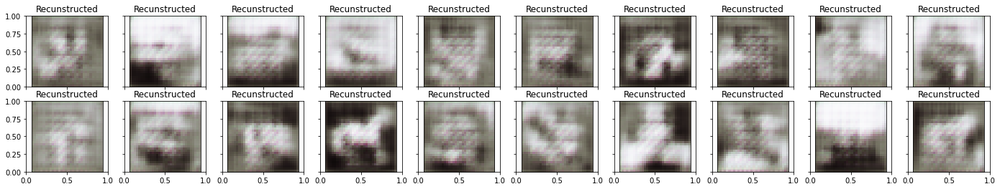

Autoencoder: G_loss: 0.58766
tensor(0.0351, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
D loss is increasing
tensor(0.0265, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0247, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0271, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0283, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0273, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0242, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0279, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
[8/8] D_loss: 0.02788 G_loss: 0.02762
[8/8] G_loss: 0.02045

 EPOCH 174/200 	 train loss 0.5876613855361938 	 val loss 0.6022623777389526


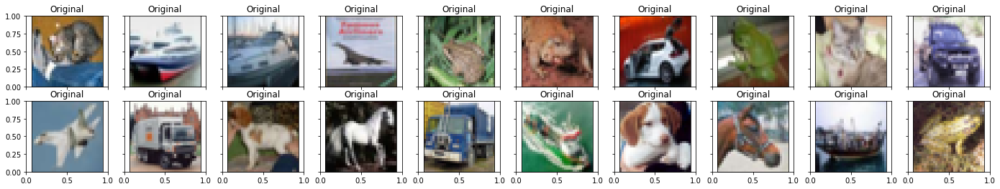

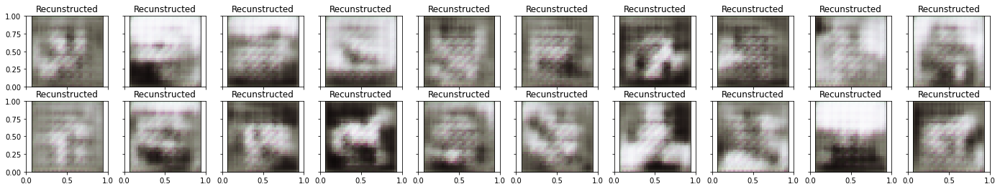

Autoencoder: G_loss: 0.58612
tensor(0.0315, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
D loss is increasing
tensor(0.0292, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0306, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
D loss is increasing
tensor(0.0267, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0243, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0286, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0293, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0277, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
[8/8] D_loss: 0.02766 G_loss: 0.02848
[8/8] G_loss: 0.02095

 EPOCH 175/200 	 train loss 0.5861173868179321 	 val loss 0.6019722819328308


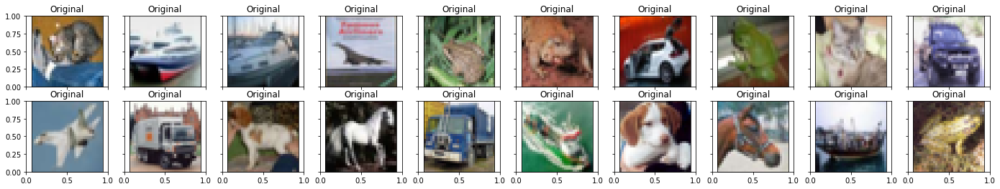

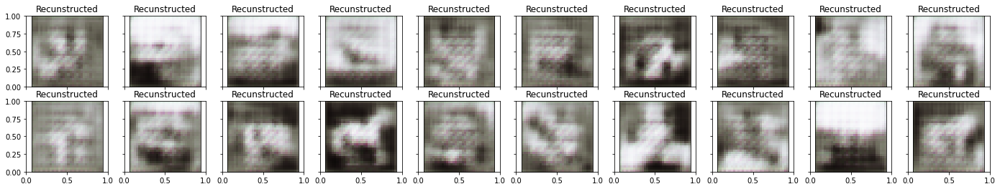

Autoencoder: G_loss: 0.58591
tensor(0.0276, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0277, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0315, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
D loss is increasing
tensor(0.0247, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0270, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0263, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0270, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0312, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
D loss is increasing
[8/8] D_loss: 0.03124 G_loss: 0.02787
[8/8] G_loss: 0.01980

 EPOCH 176/200 	 train loss 0.5859101414680481 	 val loss 0.602599024772644


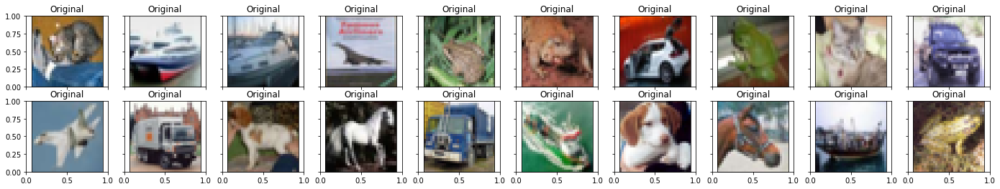

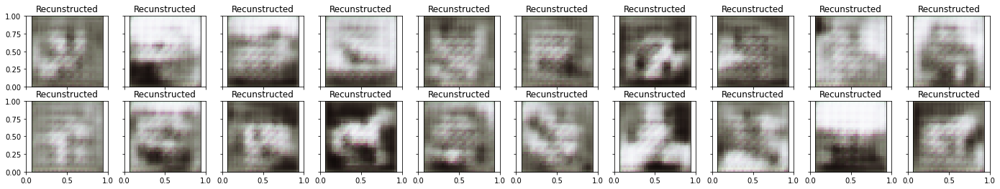

Autoencoder: G_loss: 0.58548
tensor(0.0261, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0266, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0227, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0304, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
D loss is increasing
tensor(0.0239, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0302, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
D loss is increasing
tensor(0.0236, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0238, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
[8/8] D_loss: 0.02375 G_loss: 0.02592
[8/8] G_loss: 0.01757

 EPOCH 177/200 	 train loss 0.5854814648628235 	 val loss 0.595790684223175


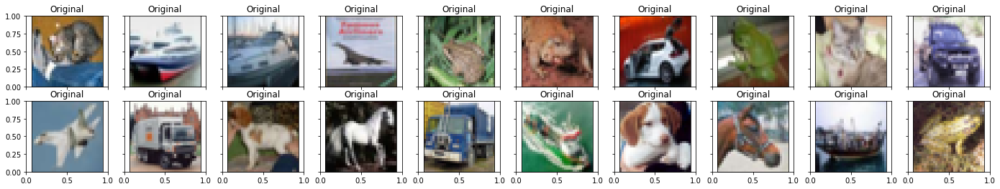

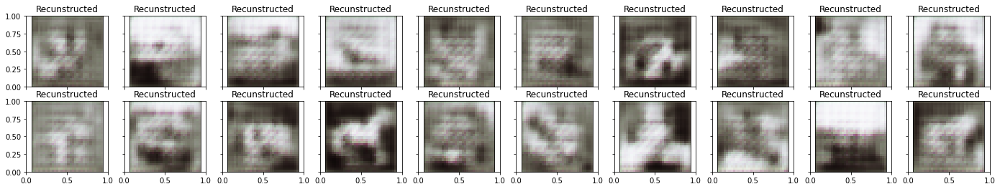

Autoencoder: G_loss: 0.58461
tensor(0.0236, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0236, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0260, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0215, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0288, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0249, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0256, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0264, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
[8/8] D_loss: 0.02636 G_loss: 0.02505
[8/8] G_loss: 0.01772

 EPOCH 178/200 	 train loss 0.5846060514450073 	 val loss 0.5894140601158142


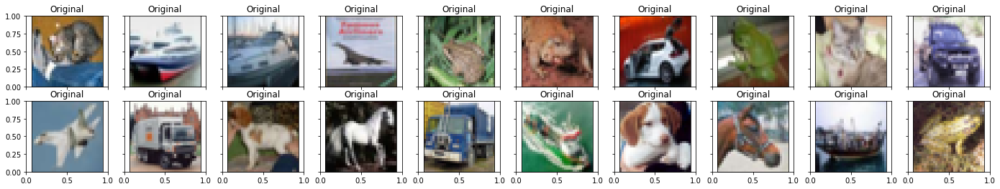

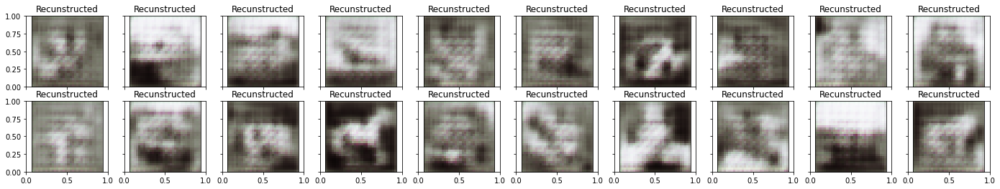

Autoencoder: G_loss: 0.58416
tensor(0.0262, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0284, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0280, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0229, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0219, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0257, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0331, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
D loss is increasing
tensor(0.0293, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
[8/8] D_loss: 0.02933 G_loss: 0.02694
[8/8] G_loss: 0.01893

 EPOCH 179/200 	 train loss 0.5841577053070068 	 val loss 0.5910232067108154


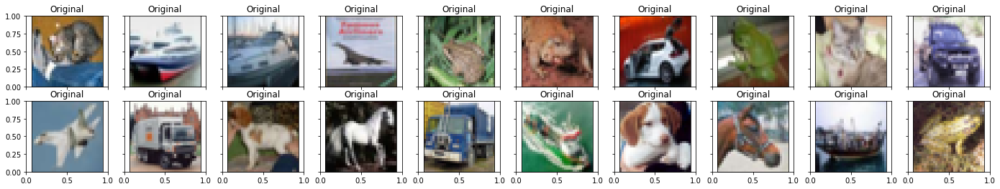

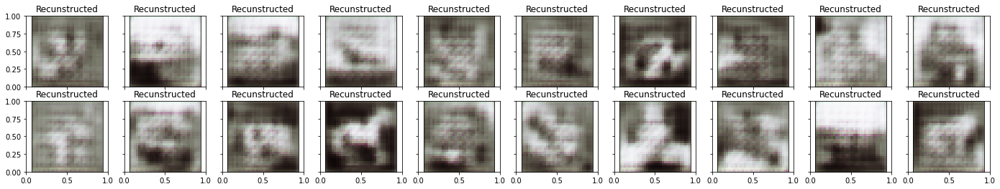

Autoencoder: G_loss: 0.58390
tensor(0.0316, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
D loss is increasing
tensor(0.0247, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0220, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0232, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0249, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0234, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0199, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0304, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
D loss is increasing
[8/8] D_loss: 0.03037 G_loss: 0.02500
[8/8] G_loss: 0.02097

 EPOCH 180/200 	 train loss 0.5838998556137085 	 val loss 0.5950285196304321


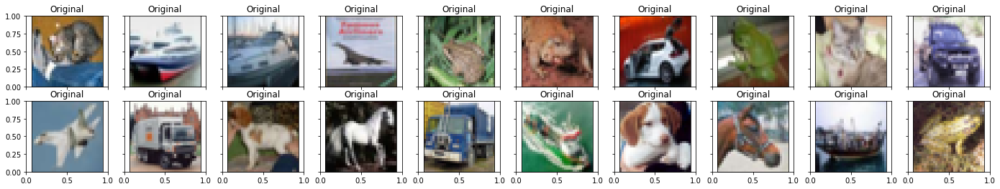

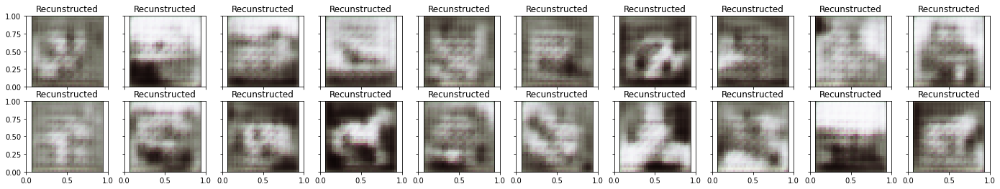

Autoencoder: G_loss: 0.58431
tensor(0.0345, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
D loss is increasing
tensor(0.0213, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0186, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0224, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0230, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0219, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0177, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0184, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
[8/8] D_loss: 0.01835 G_loss: 0.02220
[8/8] G_loss: 0.02054

 EPOCH 181/200 	 train loss 0.5843125581741333 	 val loss 0.5961793065071106


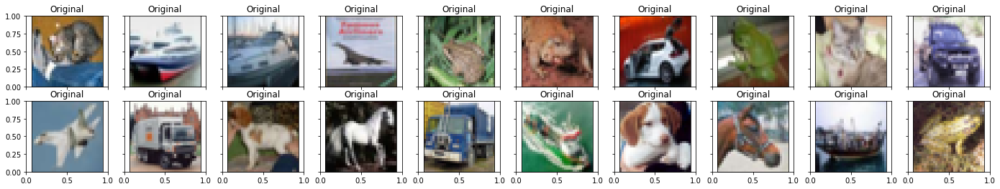

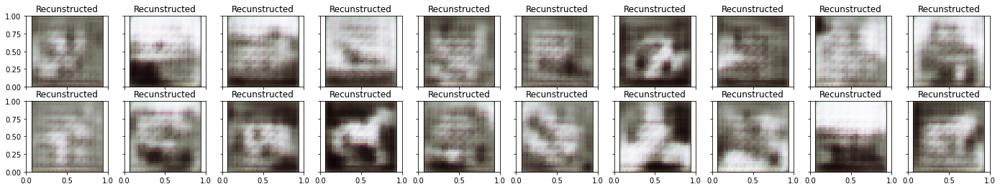

Autoencoder: G_loss: 0.58413
tensor(0.0233, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0314, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
D loss is increasing
tensor(0.0194, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0219, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0276, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0209, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0218, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0269, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
[8/8] D_loss: 0.02687 G_loss: 0.02414
[8/8] G_loss: 0.02072

 EPOCH 182/200 	 train loss 0.5841250419616699 	 val loss 0.6006545424461365


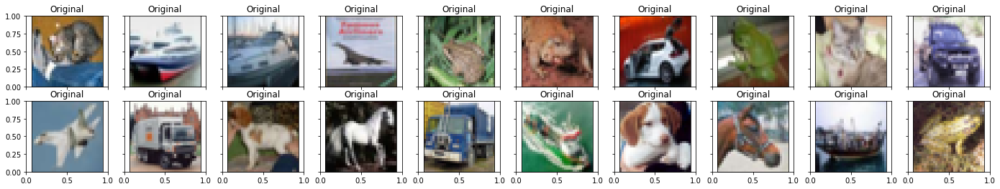

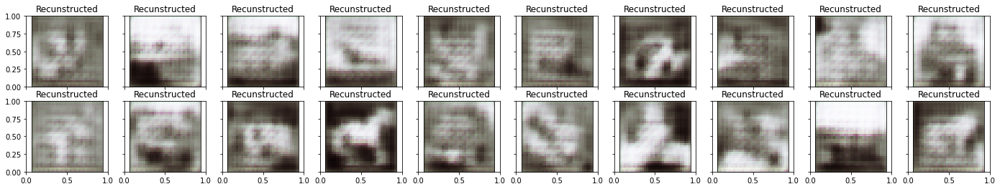

Autoencoder: G_loss: 0.58405
tensor(0.0277, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0234, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0211, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0318, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
D loss is increasing
tensor(0.0191, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0205, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0213, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0263, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
[8/8] D_loss: 0.02633 G_loss: 0.02391
[8/8] G_loss: 0.02132

 EPOCH 183/200 	 train loss 0.5840503573417664 	 val loss 0.6015313863754272


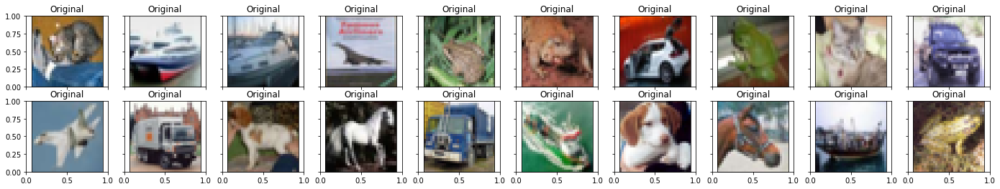

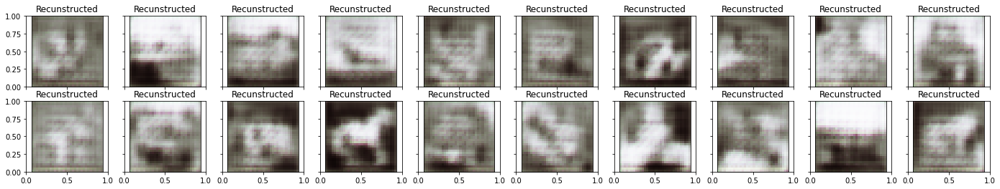

Autoencoder: G_loss: 0.58435
tensor(0.0255, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0210, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0207, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0251, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0206, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0270, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0276, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0186, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
[8/8] D_loss: 0.01857 G_loss: 0.02326
[8/8] G_loss: 0.01859

 EPOCH 184/200 	 train loss 0.5843499302864075 	 val loss 0.5958316326141357


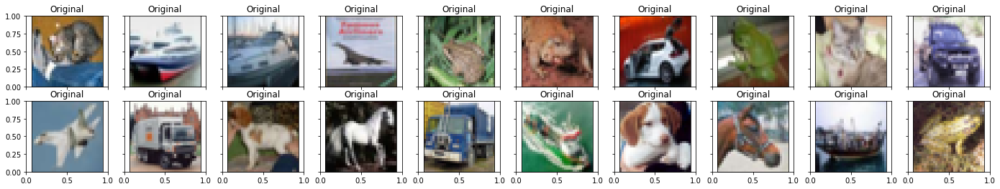

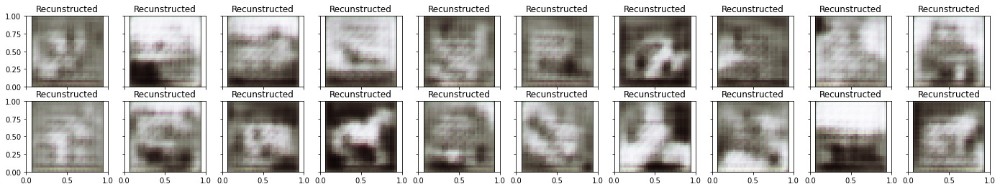

Autoencoder: G_loss: 0.58373
tensor(0.0226, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0219, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0244, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0271, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0228, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0218, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0213, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
tensor(0.0232, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward0>)
[8/8] D_loss: 0.02322 G_loss: 0.02313
[8/8] G_loss: 0.01925


In [ ]:
num_epochs = 200
diz_loss = {'train_loss':[],'val_loss':[]}
for epoch in range(num_epochs):
   train_loss =train_epoch(autoencoder_1,discriminator,device,train_loader,loss_fn,optimizer_1, optimizer_2, d_optimizer)
   val_loss = test_epoch(autoencoder_1,device,test_loader,loss_fn)
   print('\n EPOCH {}/{} \t train loss {} \t val loss {}'.format(epoch + 1, num_epochs,train_loss,val_loss))
   diz_loss['train_loss'].append(train_loss)
   diz_loss['val_loss'].append(val_loss)
   plot_ae_outputs(autoencoder_1, n=20)

In [ ]:
test_epoch(autoencoder_1,device,test_loader,loss_fn).item()

0.020651577040553093

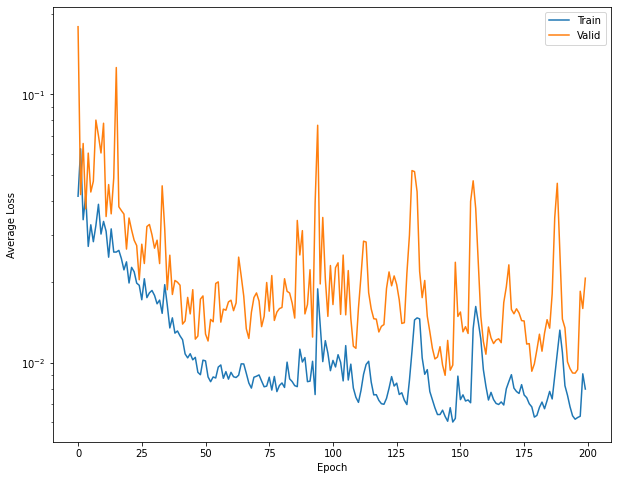

In [ ]:
# Plot losses
plt.figure(figsize=(10,8))
plt.semilogy(diz_loss['train_loss'], label='Train')
plt.semilogy(diz_loss['val_loss'], label='Valid')
plt.xlabel('Epoch')
plt.ylabel('Average Loss')
#plt.grid()
plt.legend()
#plt.title('loss')
plt.show()